In [1]:
"""

Path Planning Sample Code with RRT for car like robot.

author: AtsushiSakai(@Atsushi_twi)

"""
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle
import numpy as np
import copy
import math
import random
import sys
import os
import time
import Collisions
from Shapes import *
__file__ = 'rrt_star_reeds_shepp.py'
sys.path.append(os.path.dirname(os.path.abspath(__file__)) +
                "/../ReedsSheppPath/")

try:
    import reeds_shepp_path_planning
except:
    raise

show_animation = False
STEP_SIZE = 0.1
curvature = 0.3


class RRT():
    """
    Class for RRT Planning
    """

    def __init__(self, start, goal, obstacleList, randArea,
                 goalSampleRate=10, maxIter=400):
        """
        Setting Parameter

        start:Start Position [x,y]
        goal:Goal Position [x,y]
        obstacleList:obstacle Positions [[x,y,size],...]
        randArea:Ramdom Samping Area [min,max]

        """
        self.start = Node(start[0], start[1], start[2])
        self.end = Node(goal[0], goal[1], goal[2])
        self.h = 1
        self.w = 2
        self.minrand = randArea[0]
        self.maxrand = randArea[1]
        self.goalSampleRate = goalSampleRate
        self.maxIter = maxIter
        self.obstacleList = obstacleList

    def Planning(self, animation=True):
        """
        Pathplanning

        animation: flag for animation on or off
        """

        self.nodeList = [self.start]
        start_end = Node(0, 0, 0)
        start_end.path_x += [self.start.x, self.end.x]
        start_end.path_y += [self.start.y, self.end.y]
        start_end.path_yaw += [self.start.yaw, self.end.yaw]
        if not self.CollisionCheck(start_end, self.obstacleList):
            return None
        for i in range(self.maxIter):
            rnd = self.get_random_point()
            nind = self.GetNearestListIndex(self.nodeList, rnd)

            newNode = self.steer(rnd, nind)
            if newNode is None:
                continue

            if self.CollisionCheck(newNode, self.obstacleList):
                nearinds = self.find_near_nodes(newNode)
                newNode = self.choose_parent(newNode, nearinds)
                if newNode is None:
                    continue
                self.nodeList.append(newNode)
                self.rewire(newNode, nearinds)

            if animation and i % 5 == 0:
                self.DrawGraph(rnd=rnd)

        # generate coruse
        lastIndex = self.get_best_last_index()
        if lastIndex is None:
            return None
        path = self.gen_final_course(lastIndex)
        return path

    def choose_parent(self, newNode, nearinds):
        if not nearinds:
            return newNode

        dlist = []
        for i in nearinds:
            tNode = self.steer(newNode, i)
            if tNode is None:
                continue

            if self.CollisionCheck(tNode, self.obstacleList):
                dlist.append(tNode.cost)
            else:
                dlist.append(float("inf"))

        mincost = min(dlist)
        minind = nearinds[dlist.index(mincost)]

        if mincost == float("inf"):
            print("mincost is inf")
            return newNode

        newNode = self.steer(newNode, minind)

        return newNode


    def steer(self, rnd, nind):

        nearestNode = self.nodeList[nind]

        px, py, pyaw, mode, clen = reeds_shepp_path_planning.reeds_shepp_path_planning(
            nearestNode.x, nearestNode.y, nearestNode.yaw, rnd.x, rnd.y, rnd.yaw, curvature, STEP_SIZE)

        if px is None:
            return None

        newNode = copy.deepcopy(nearestNode)
        newNode.x = px[-1]
        newNode.y = py[-1]
        newNode.yaw = pyaw[-1]

        newNode.path_x = px
        newNode.path_y = py
        newNode.path_yaw = pyaw
        newNode.cost += sum([abs(c) for c in clen])
        newNode.parent = nind

        return newNode

    def get_random_point(self):

        if random.randint(0, 100) > self.goalSampleRate:
            rnd = [random.uniform(self.minrand, self.maxrand),
                   random.uniform(self.minrand, self.maxrand),
                   random.uniform(-math.pi, math.pi)
                   ]
        else:  # goal point sampling
            rnd = [self.end.x, self.end.y, self.end.yaw]

        node = Node(rnd[0], rnd[1], rnd[2])

        return node

    def get_best_last_index(self):
        #  print("get_best_last_index")

        YAWTH = np.deg2rad(3.0)
        XYTH = 0.5

        goalinds = []
        for (i, node) in enumerate(self.nodeList):
            if self.calc_dist_to_goal(node.x, node.y) <= XYTH:
                goalinds.append(i)
        #  print("OK XY TH num is")
        #  print(len(goalinds))

        # angle check
        fgoalinds = []
        for i in goalinds:
            if abs(self.nodeList[i].yaw - self.end.yaw) <= YAWTH:
                fgoalinds.append(i)
        #  print("OK YAW TH num is")
        #  print(len(fgoalinds))

        if not fgoalinds:
            return None

        mincost = min([self.nodeList[i].cost for i in fgoalinds])
        for i in fgoalinds:
            if self.nodeList[i].cost == mincost:
                return i

        return None

    def gen_final_course(self, goalind):
        path = [[self.end.x, self.end.y, self.end.yaw]]
        while self.nodeList[goalind].parent is not None:
            node = self.nodeList[goalind]
            for (ix, iy, iyaw) in zip(reversed(node.path_x), reversed(node.path_y), reversed(node.path_yaw)):
                path.append([ix, iy, iyaw])
            goalind = node.parent
        path.append([self.start.x, self.start.y, self.start.yaw])
        return path

    def calc_dist_to_goal(self, x, y):
        return np.linalg.norm([x - self.end.x, y - self.end.y])

    def find_near_nodes(self, newNode):
        nnode = len(self.nodeList)
        r = 50.0 * math.sqrt((math.log(nnode) / nnode))
        #  r = self.expandDis * 5.0
        dlist = [(node.x - newNode.x) ** 2 +
                 (node.y - newNode.y) ** 2 +
                 (node.yaw - newNode.yaw) ** 2
                 for node in self.nodeList]
        nearinds = [dlist.index(i) for i in dlist if i <= r ** 2]
        return nearinds

    def rewire(self, newNode, nearinds):

        nnode = len(self.nodeList)

        for i in nearinds:
            nearNode = self.nodeList[i]
            tNode = self.steer(nearNode, nnode - 1)
            if tNode is None:
                continue

            obstacleOK = self.CollisionCheck(tNode, self.obstacleList)
            imporveCost = nearNode.cost > tNode.cost

            if obstacleOK and imporveCost:
                #  print("rewire")
                self.nodeList[i] = tNode

    def DrawGraph(self, rnd=None):  # pragma: no cover
        plt.clf()
        ax = plt.axes()
        if rnd is not None:
            plt.plot(rnd.x, rnd.y, "^k")
        for node in self.nodeList:
            if node.parent is not None:
                plt.plot(node.path_x, node.path_y, "-g")
                #  plt.plot([node.x, self.nodeList[node.parent].x], [
                #  node.y, self.nodeList[node.parent].y], "-g")

        for (ox, oy, oyaw, h, w) in self.obstacleList:
            block = Rectangle((ox - 0.5*w, oy - 0.5*h), w, h, angle = np.rad2deg(oyaw), color = 'k')
            ax.add_patch(block)
            
        reeds_shepp_path_planning.plot_arrow(
            self.start.x, self.start.y, self.start.yaw)
        reeds_shepp_path_planning.plot_arrow(
            self.end.x, self.end.y, self.end.yaw)

        plt.axis([-2, 22, -2, 22])
        plt.gca().set_aspect('equal', adjustable='box')
        plt.grid(True)
        plt.pause(0.01)

        #  plt.show()
        #  input()

    def GetNearestListIndex(self, nodeList, rnd):
        dlist = [(node.x - rnd.x) ** 2 +
                 (node.y - rnd.y) ** 2 +
                 (node.yaw - rnd.yaw) ** 2 for node in nodeList]
        minind = dlist.index(min(dlist))

        return minind

    def CollisionCheck(self, node, obstacleList):

        for (ox, oy, oyaw, h, w) in obstacleList:
            for (ix, iy, iyaw) in zip(node.path_x, node.path_y, node.path_yaw):
                o_vertices = [(0.5*w, 0.5*h), (0.5*w,  -0.5*h), (-0.5*w, -0.5*h), (-0.5*w, 0.5*h)]
                o_vertices = [(ox + i * np.cos(oyaw) - j * np.sin(oyaw), oy + i * np.sin(oyaw) + j * np.cos(oyaw)) for (i, j) in o_vertices]
                i_vertices = [(0.5*self.w, 0.5*self.h), (0.5*self.w, -0.5*self.h), (-0.5*self.w, -0.5*self.h), (-0.5*self.w, 0.5*self.h)]
                i_vertices = [(ix + i * np.cos(iyaw) - j * np.sin(iyaw), iy + i * np.sin(iyaw) + j * np.cos(iyaw)) for (i, j) in i_vertices]
                if Collisions.test_collision(Polygon([x for (x,y) in i_vertices], [y for (x,y) in i_vertices]), Polygon([x for (x,y) in o_vertices], [y for (x,y) in o_vertices])):
                    return False # in collision
                
        return True  # safe
    
    
def pi_2_pi(angle):
        return (angle + math.pi) % (2 * math.pi) - math.pi


class Node():
    """
    RRT Node
    """

    def __init__(self, x, y, yaw):
        self.x = x
        self.y = y
        self.yaw = yaw
        self.path_x = []
        self.path_y = []
        self.path_yaw = []
        self.cost = 0.0
        self.parent = None


def main(maxIter=100):
    
    print("Start " + __file__)
    filename = 'path1.txt'
    # ====Search Path with RRT====
    obstacleList = [
        (5, 5, 0, 3, 3),
        (5, 15, 0, 3, 3),
        (10, 10, 0, 3, 3),
        (15, 5, 0, 3, 3),
        (15, 15, 0, 3, 3)
    ]  # [x,y,size(radius)]

    try:
        with open(filename, 'r') as f:
            index = int(f.readlines()[-2])
    except:
        with open(filename, 'w+') as f:
            for t in obstacleList:
                f.writelines('%s ' % str(i) for i in t)
                f.write('\n')
            f.write('\n')
        index = 0

    tm = time.time()
    while index < 1000:    
        # Set Initial parameters
        start = [20*np.random.rand(), 20*np.random.rand(), pi_2_pi(np.deg2rad(360*np.random.rand()))]
        goal = [20*np.random.rand(), 20*np.random.rand(), pi_2_pi(np.deg2rad(360*np.random.rand()))]

        rrt = RRT(start, goal, randArea=[-2.0, 15.0],
                  obstacleList=obstacleList,
                  maxIter=maxIter)
        path = rrt.Planning(animation=show_animation)
        
        if path is not None:
            index += 1
            with open(filename, 'a') as f:
#                 f.writelines('%s ' % str(i) for i in start)
#                 f.write('\n')
#                 f.writelines('%s ' % str(i) for i in goal)
#                 f.write('\n')
                for t in path[::-1]:
                    f.writelines('%s ' % str(i) for i in t)
                    f.write('\n')
                f.write('%d\n\n' % index)
            # Draw final path
            if True:  # pragma: no cover
                rrt.DrawGraph()
                plt.plot([x for (x, y, yaw) in path], [y for (x, y, yaw) in path], '-r')
                plt.axis([-2, 22, -2, 22])
                plt.gca().set_aspect('equal', adjustable='box')
                plt.grid(True)
                plt.pause(0.001)
                plt.show()
            print('Paths planned: %d' % index)
            print('Time taken: %fs' % (time.time()-tm))
            tm = time.time()
        else:
            print('Planning failed')
            print('Time taken: %fs' % (time.time()-tm))
            tm = time.time()




Start rrt_star_reeds_shepp.py
Planning failed
Time taken: 0.000480s
Planning failed
Time taken: 126.732859s
Planning failed
Time taken: 91.978014s


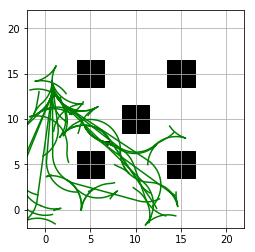

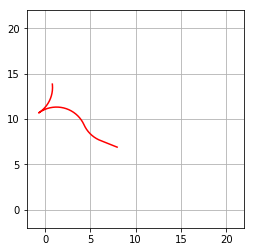

Paths planned: 367
Time taken: 179.348393s


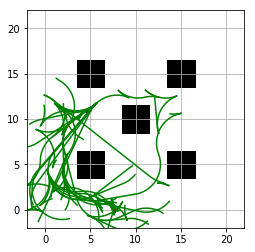

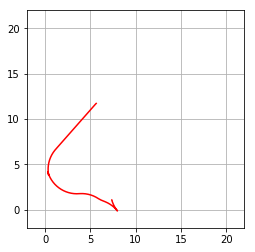

Paths planned: 368
Time taken: 158.631932s


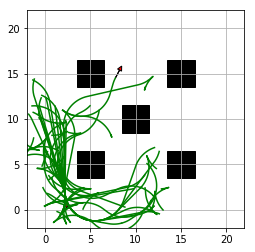

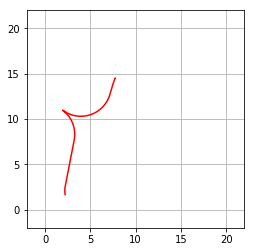

Paths planned: 369
Time taken: 195.737394s


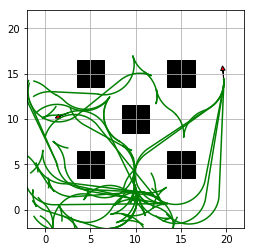

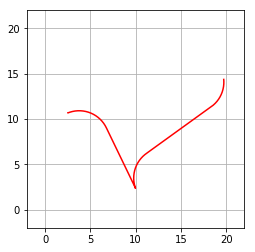

Paths planned: 370
Time taken: 195.252915s
mincost is inf


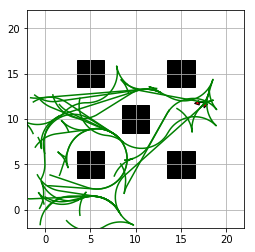

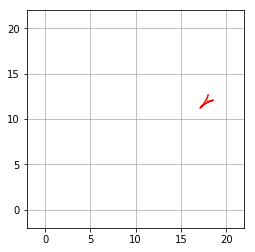

Paths planned: 371
Time taken: 107.355628s
Planning failed
Time taken: 93.587381s
Planning failed
Time taken: 0.001370s
Planning failed
Time taken: 0.000370s


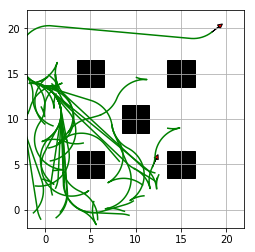

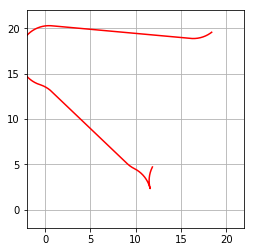

Paths planned: 372
Time taken: 119.036414s
Planning failed
Time taken: 0.019230s
Planning failed
Time taken: 0.001338s
Planning failed
Time taken: 0.000318s
Planning failed
Time taken: 0.000377s
Planning failed
Time taken: 0.001356s


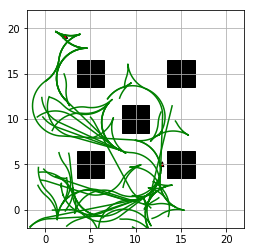

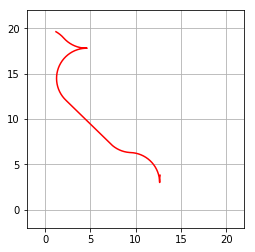

Paths planned: 373
Time taken: 176.159699s
Planning failed
Time taken: 0.001055s
Planning failed
Time taken: 0.000566s


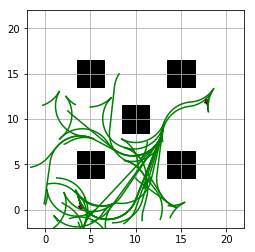

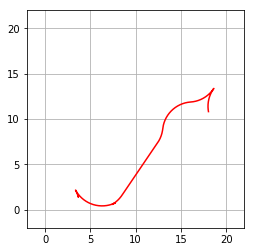

Paths planned: 374
Time taken: 113.045075s


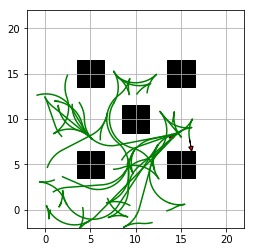

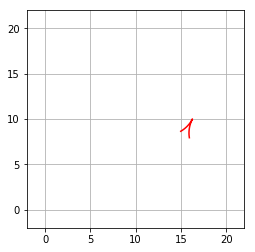

Paths planned: 375
Time taken: 115.126746s


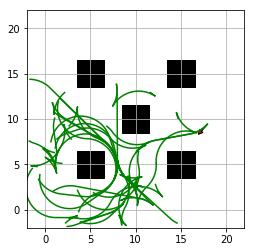

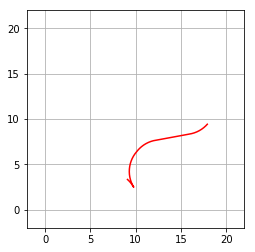

Paths planned: 376
Time taken: 123.678112s
Planning failed
Time taken: 0.000599s
Planning failed
Time taken: 0.001161s


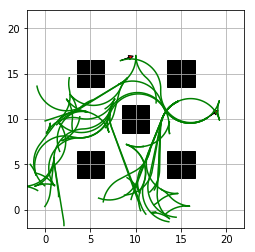

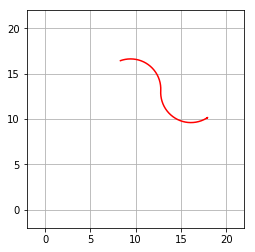

Paths planned: 377
Time taken: 125.629867s


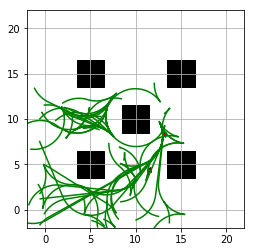

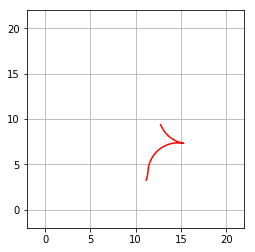

Paths planned: 378
Time taken: 154.451630s


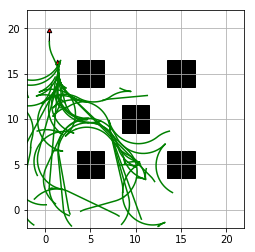

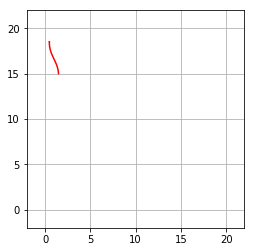

Paths planned: 379
Time taken: 136.981572s


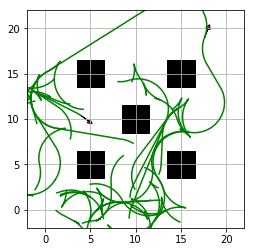

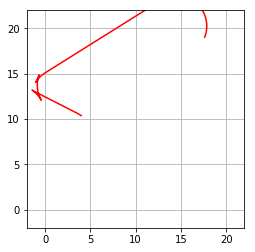

Paths planned: 380
Time taken: 125.890829s
Planning failed
Time taken: 169.135385s
Planning failed
Time taken: 160.912179s


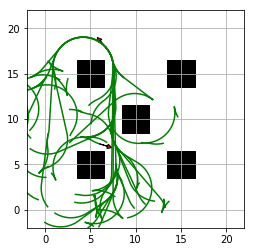

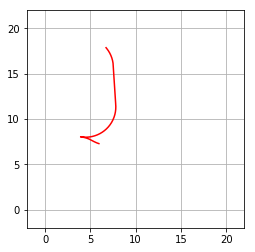

Paths planned: 381
Time taken: 132.038359s
Planning failed
Time taken: 0.001093s
Planning failed
Time taken: 4.789125s
Planning failed
Time taken: 170.977584s
Planning failed
Time taken: 0.001217s
Planning failed
Time taken: 0.000618s
Planning failed
Time taken: 0.000563s


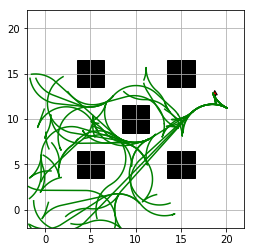

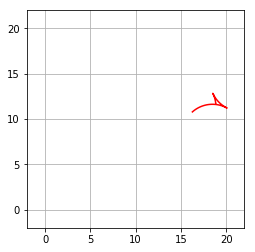

Paths planned: 382
Time taken: 162.500660s
Planning failed
Time taken: 0.000635s
Planning failed
Time taken: 0.000813s
Planning failed
Time taken: 0.001039s


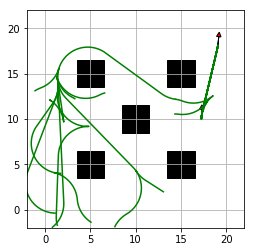

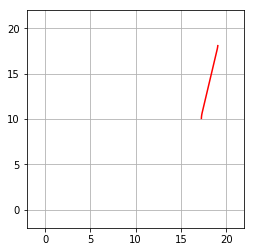

Paths planned: 383
Time taken: 72.181394s
Planning failed
Time taken: 0.001718s


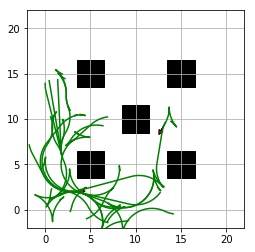

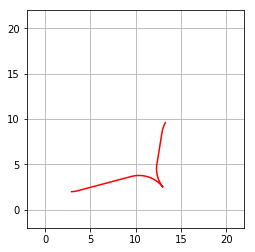

Paths planned: 384
Time taken: 97.459512s
Planning failed
Time taken: 0.000589s


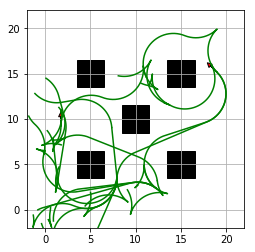

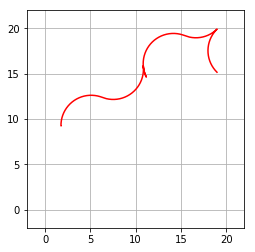

Paths planned: 385
Time taken: 59.993616s
Planning failed
Time taken: 0.000683s
Planning failed
Time taken: 0.001177s
Planning failed
Time taken: 0.000230s
Planning failed
Time taken: 0.000245s


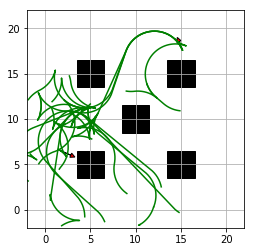

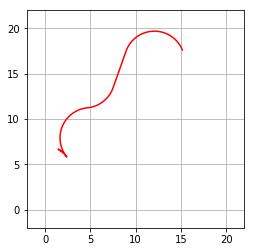

Paths planned: 386
Time taken: 70.964496s


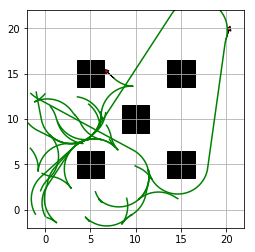

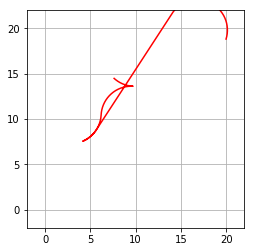

Paths planned: 387
Time taken: 53.747803s
Planning failed
Time taken: 0.017428s
Planning failed
Time taken: 0.000659s


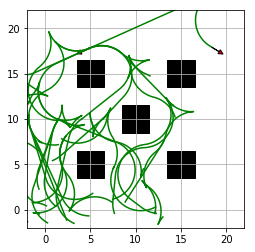

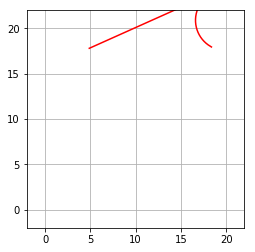

Paths planned: 388
Time taken: 121.418034s


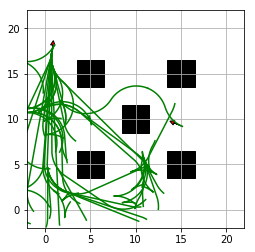

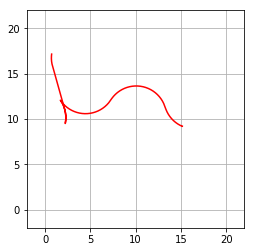

Paths planned: 389
Time taken: 154.092485s
Planning failed
Time taken: 141.340523s
Planning failed
Time taken: 0.001163s
Planning failed
Time taken: 0.000517s


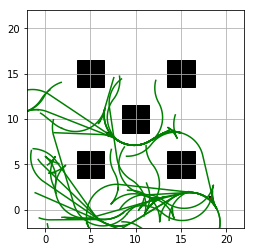

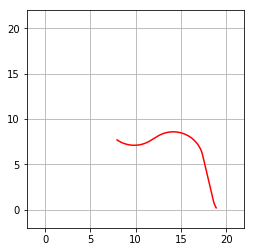

Paths planned: 390
Time taken: 180.070397s


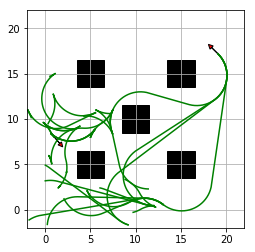

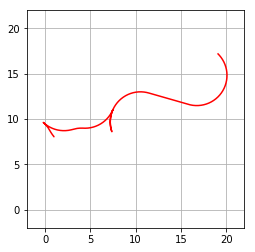

Paths planned: 391
Time taken: 45.444504s


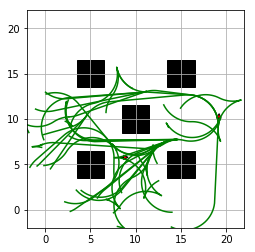

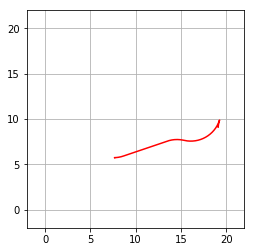

Paths planned: 392
Time taken: 118.695504s
Planning failed
Time taken: 131.972006s
Planning failed
Time taken: 0.000636s
Planning failed
Time taken: 0.000291s
Planning failed
Time taken: 0.000668s


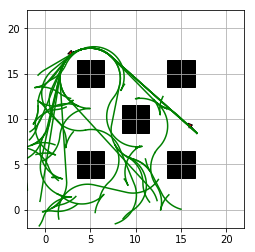

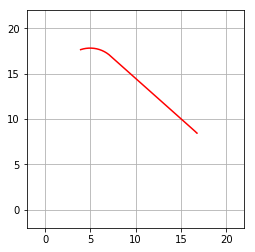

Paths planned: 393
Time taken: 130.115007s
Planning failed
Time taken: 0.001228s


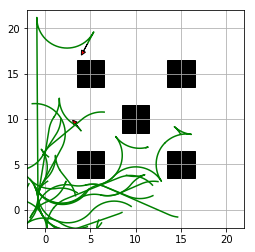

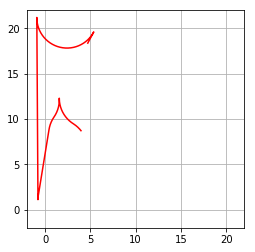

Paths planned: 394
Time taken: 64.207867s
Planning failed
Time taken: 0.000584s


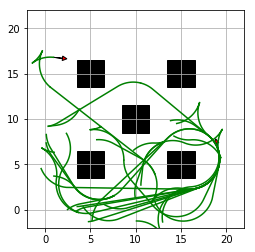

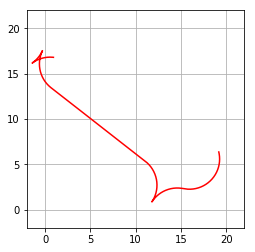

Paths planned: 395
Time taken: 73.794124s


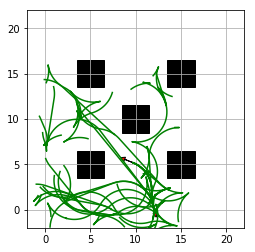

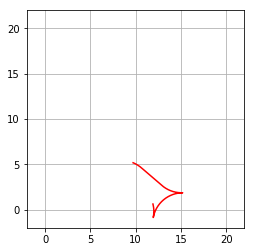

Paths planned: 396
Time taken: 161.490656s


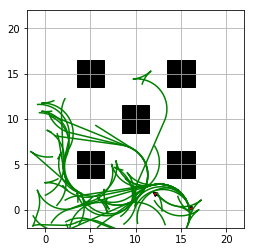

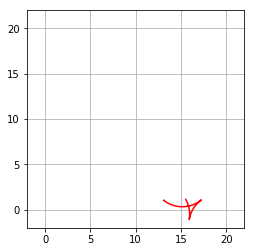

Paths planned: 397
Time taken: 147.696337s
Planning failed
Time taken: 0.000818s
Planning failed
Time taken: 0.000542s


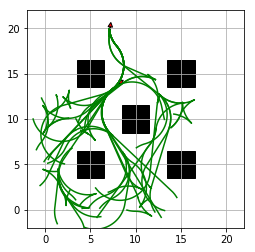

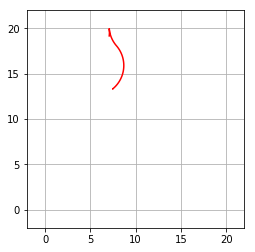

Paths planned: 398
Time taken: 198.400832s
Planning failed
Time taken: 0.000922s


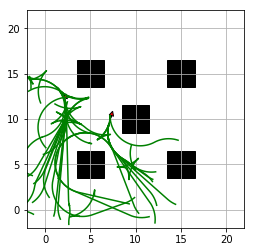

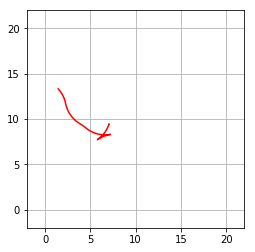

Paths planned: 399
Time taken: 121.883364s
Planning failed
Time taken: 0.001266s


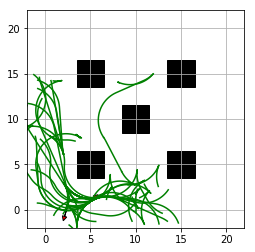

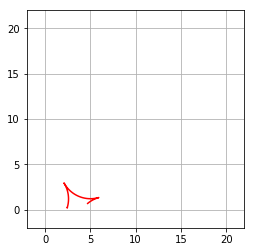

Paths planned: 400
Time taken: 233.302281s
Planning failed
Time taken: 0.000647s


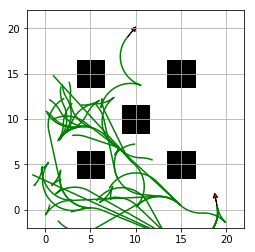

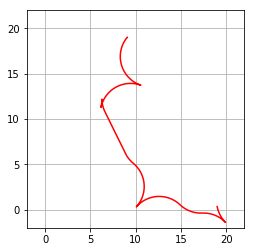

Paths planned: 401
Time taken: 80.463858s
Planning failed
Time taken: 0.001832s


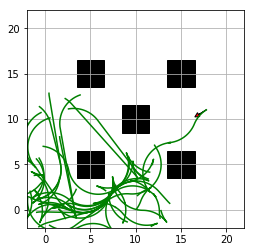

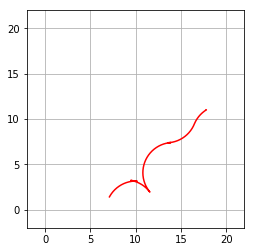

Paths planned: 402
Time taken: 154.976254s


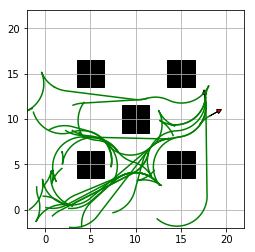

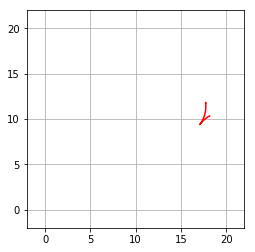

Paths planned: 403
Time taken: 76.664779s
Planning failed
Time taken: 0.001061s


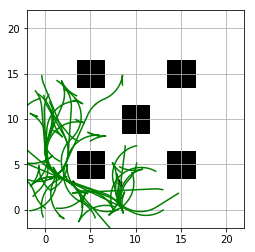

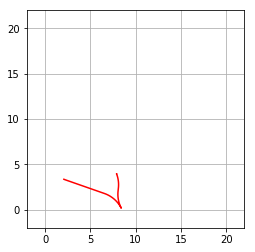

Paths planned: 404
Time taken: 150.323426s


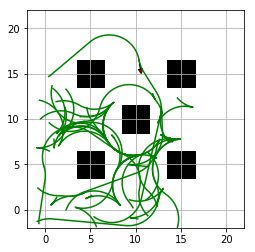

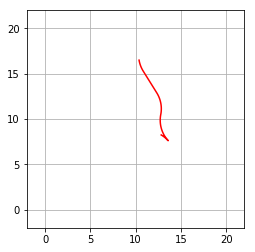

Paths planned: 405
Time taken: 111.207425s
Planning failed
Time taken: 0.026811s
Planning failed
Time taken: 0.000973s


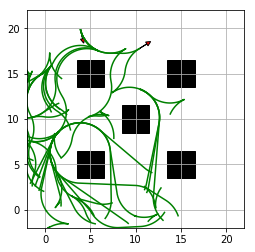

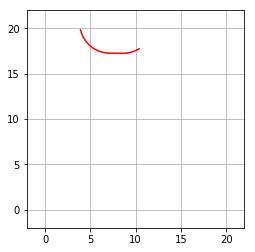

Paths planned: 406
Time taken: 148.410967s
Planning failed
Time taken: 0.000775s
Planning failed
Time taken: 0.000226s
Planning failed
Time taken: 155.096721s
Planning failed
Time taken: 97.311736s


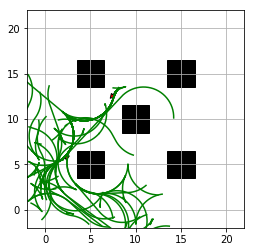

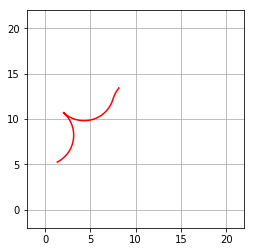

Paths planned: 407
Time taken: 234.224658s


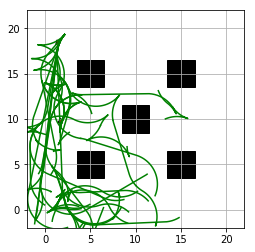

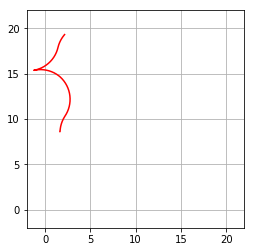

Paths planned: 408
Time taken: 169.082383s
Planning failed
Time taken: 0.000694s


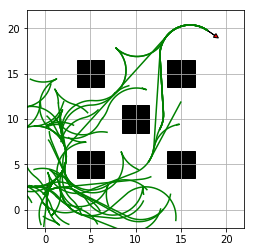

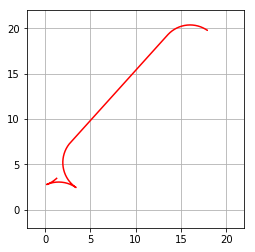

Paths planned: 409
Time taken: 189.639372s
Planning failed
Time taken: 16.593241s
Planning failed
Time taken: 191.146113s
Planning failed
Time taken: 0.000841s
Planning failed
Time taken: 116.991113s
Planning failed
Time taken: 0.000638s


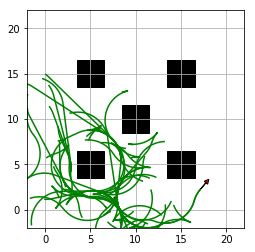

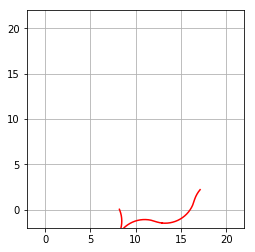

Paths planned: 410
Time taken: 207.621386s
Planning failed
Time taken: 0.001556s
Planning failed
Time taken: 0.000671s


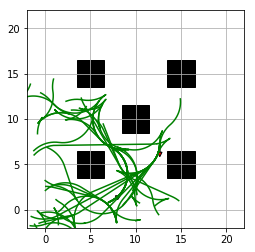

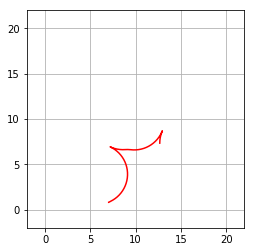

Paths planned: 411
Time taken: 191.005134s
Planning failed
Time taken: 0.000764s
Planning failed
Time taken: 0.000517s


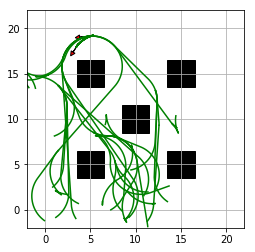

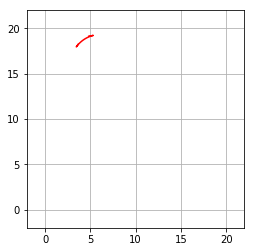

Paths planned: 412
Time taken: 128.439263s


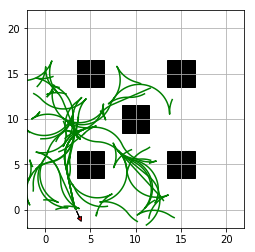

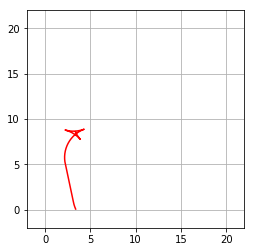

Paths planned: 413
Time taken: 182.440734s
Planning failed
Time taken: 162.105473s


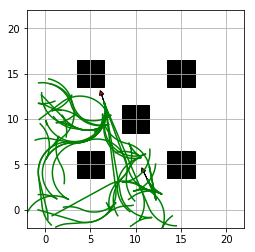

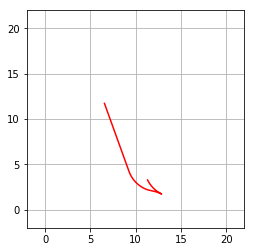

Paths planned: 414
Time taken: 158.547873s
Planning failed
Time taken: 0.001016s


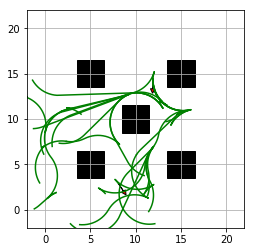

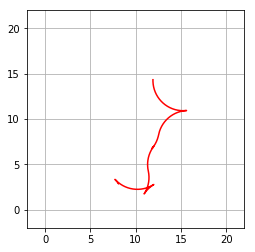

Paths planned: 415
Time taken: 54.909716s
Planning failed
Time taken: 0.001243s


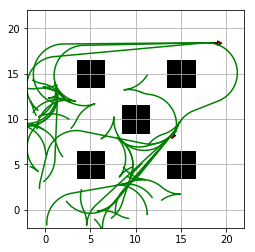

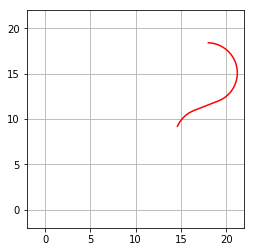

Paths planned: 416
Time taken: 99.302525s
Planning failed
Time taken: 0.019768s


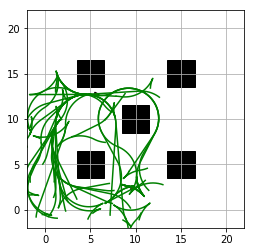

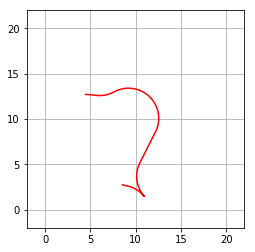

Paths planned: 417
Time taken: 199.923475s
Planning failed
Time taken: 0.002556s


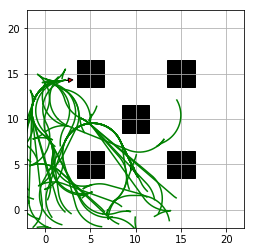

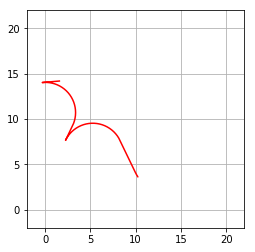

Paths planned: 418
Time taken: 236.637491s
Planning failed
Time taken: 0.000907s


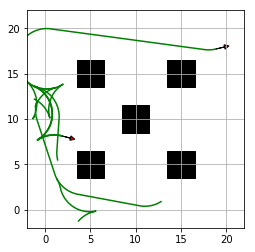

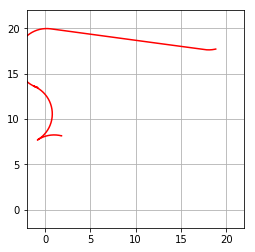

Paths planned: 419
Time taken: 15.069965s


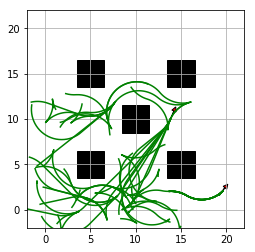

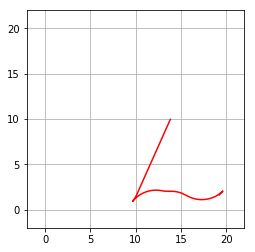

Paths planned: 420
Time taken: 190.043894s


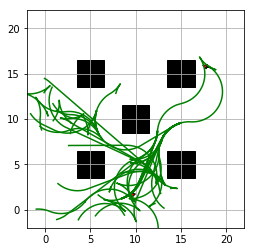

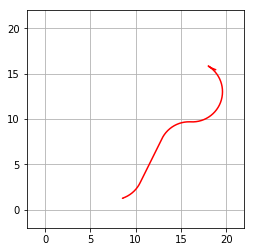

Paths planned: 421
Time taken: 151.533631s


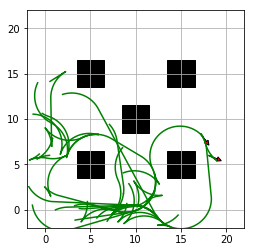

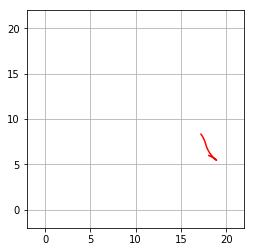

Paths planned: 422
Time taken: 65.755020s
Planning failed
Time taken: 114.240954s


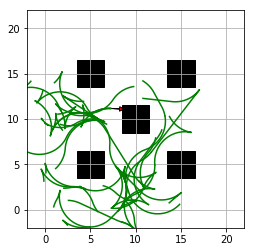

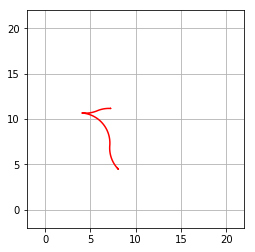

Paths planned: 423
Time taken: 129.704159s
Planning failed
Time taken: 0.001363s


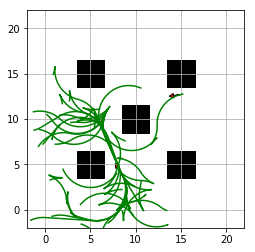

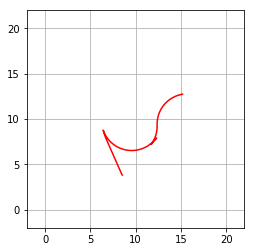

Paths planned: 424
Time taken: 126.206728s


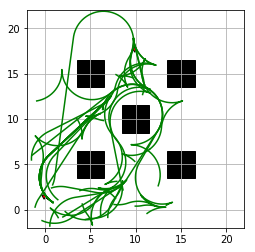

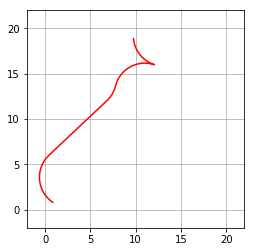

Paths planned: 425
Time taken: 161.478710s
Planning failed
Time taken: 0.001580s
Planning failed
Time taken: 0.002595s
Planning failed
Time taken: 0.000484s
Planning failed
Time taken: 177.351985s
Planning failed
Time taken: 0.001204s
Planning failed
Time taken: 106.085971s


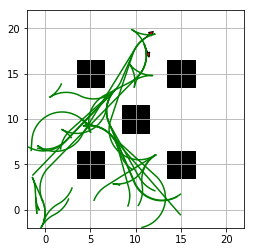

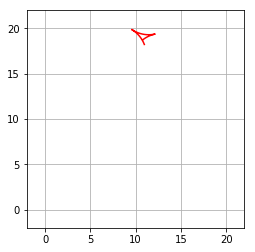

Paths planned: 426
Time taken: 55.888341s
Planning failed
Time taken: 0.001637s


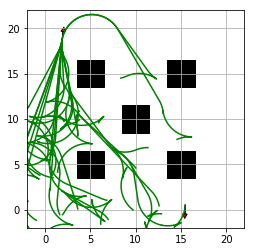

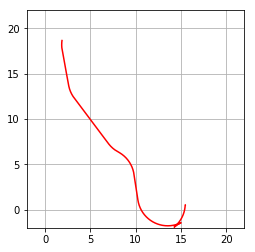

Paths planned: 427
Time taken: 165.182155s
Planning failed
Time taken: 0.001226s
Planning failed
Time taken: 111.401026s
Planning failed
Time taken: 0.001493s


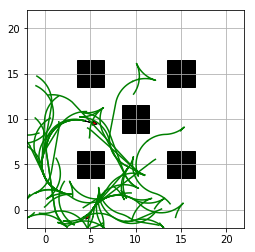

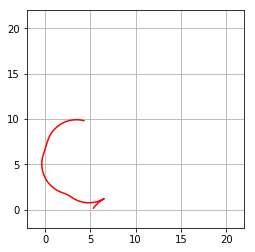

Paths planned: 428
Time taken: 179.809964s
Planning failed
Time taken: 0.000954s


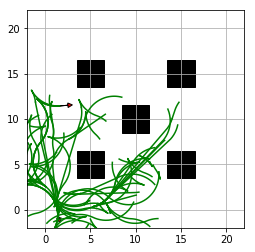

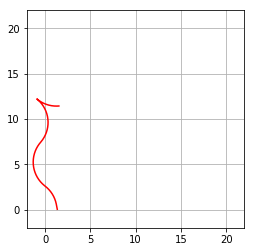

Paths planned: 429
Time taken: 191.714337s
Planning failed
Time taken: 0.001437s


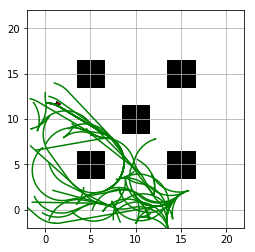

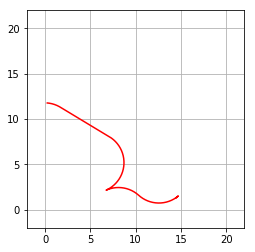

Paths planned: 430
Time taken: 198.628126s
Planning failed
Time taken: 169.581784s
Planning failed
Time taken: 0.001393s
Planning failed
Time taken: 125.782238s
Planning failed
Time taken: 0.000650s
Planning failed
Time taken: 68.097123s
Planning failed
Time taken: 29.098516s
Planning failed
Time taken: 0.000558s


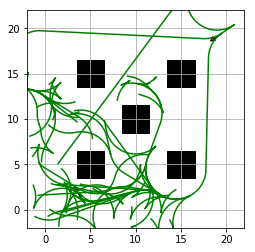

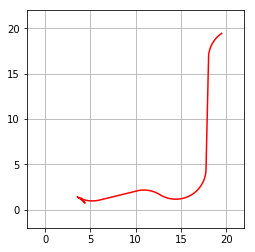

Paths planned: 431
Time taken: 178.636868s


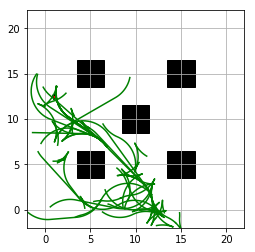

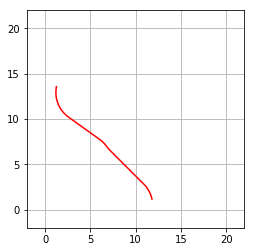

Paths planned: 432
Time taken: 138.696675s
Planning failed
Time taken: 0.000712s
Planning failed
Time taken: 0.000536s


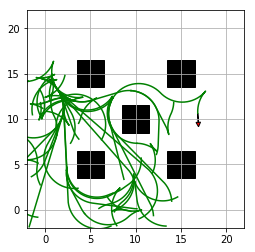

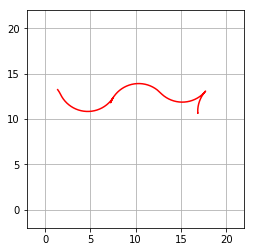

Paths planned: 433
Time taken: 128.769171s
Planning failed
Time taken: 0.001132s


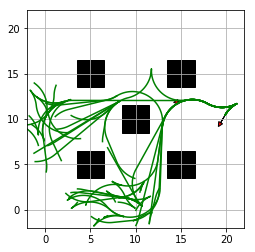

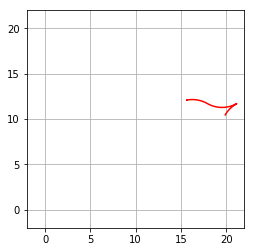

Paths planned: 434
Time taken: 164.142297s
Planning failed
Time taken: 0.016694s


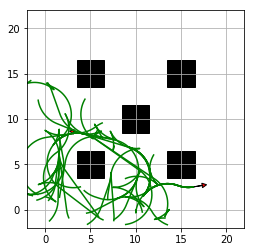

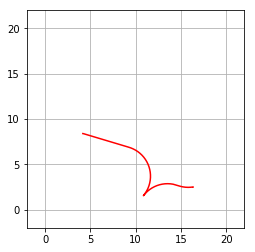

Paths planned: 435
Time taken: 139.173077s


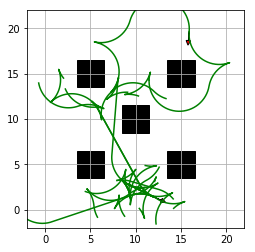

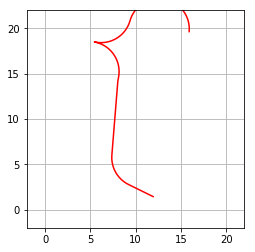

Paths planned: 436
Time taken: 63.238518s
Planning failed
Time taken: 0.001349s
Planning failed
Time taken: 0.001034s
Planning failed
Time taken: 0.001044s
Planning failed
Time taken: 0.000223s


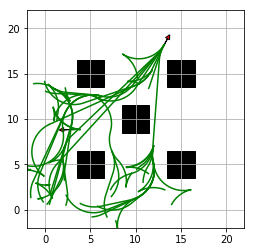

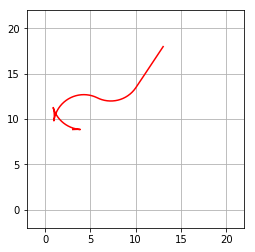

Paths planned: 437
Time taken: 106.254473s
Planning failed
Time taken: 0.000729s
Planning failed
Time taken: 0.001284s


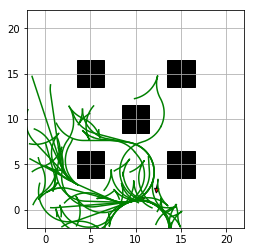

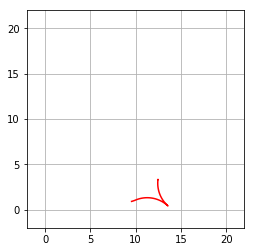

Paths planned: 438
Time taken: 117.010052s
Planning failed
Time taken: 0.001613s
Planning failed
Time taken: 0.001163s
Planning failed
Time taken: 0.000778s
Planning failed
Time taken: 0.000761s


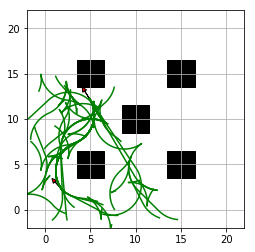

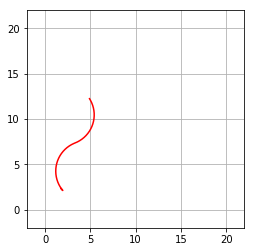

Paths planned: 439
Time taken: 127.184741s
mincost is inf
Planning failed
Time taken: 53.088087s


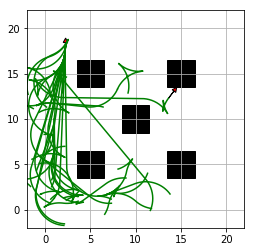

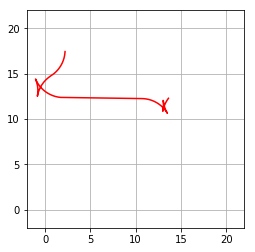

Paths planned: 440
Time taken: 90.223196s
Planning failed
Time taken: 0.001356s
Planning failed
Time taken: 0.001107s
Planning failed
Time taken: 75.607945s
Planning failed
Time taken: 92.906144s
Planning failed
Time taken: 98.945849s


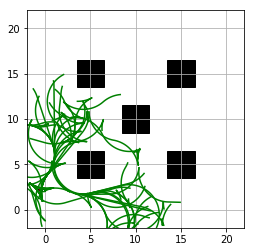

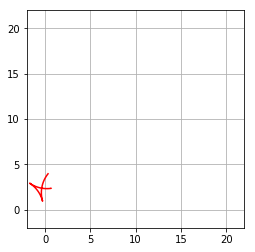

Paths planned: 441
Time taken: 153.584923s


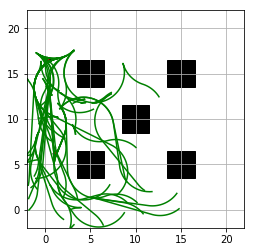

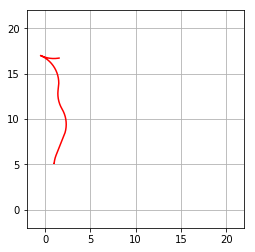

Paths planned: 442
Time taken: 167.156475s


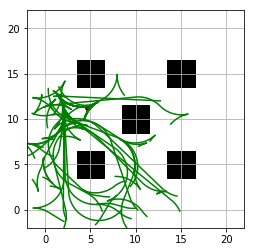

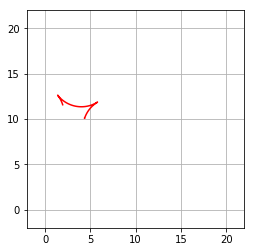

Paths planned: 443
Time taken: 151.222666s


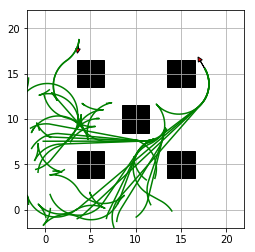

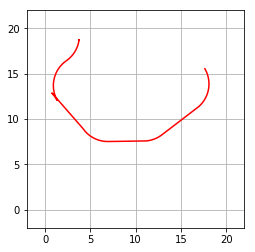

Paths planned: 444
Time taken: 78.137503s


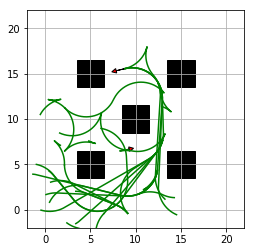

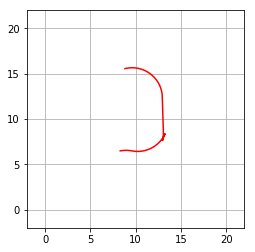

Paths planned: 445
Time taken: 36.279742s


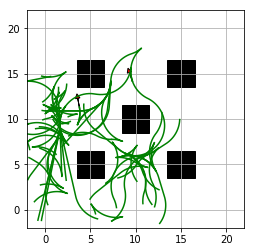

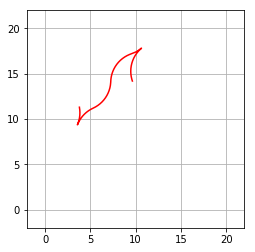

Paths planned: 446
Time taken: 132.401721s
Planning failed
Time taken: 0.000486s


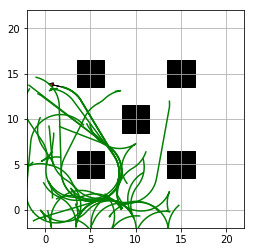

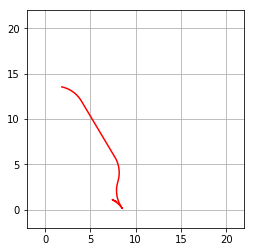

Paths planned: 447
Time taken: 99.272329s
Planning failed
Time taken: 0.000672s
mincost is inf
Planning failed
Time taken: 166.075610s


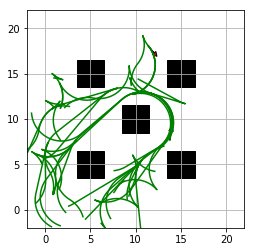

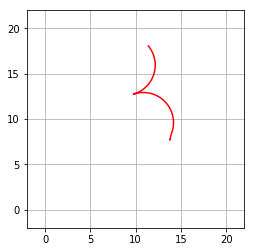

Paths planned: 448
Time taken: 78.328096s


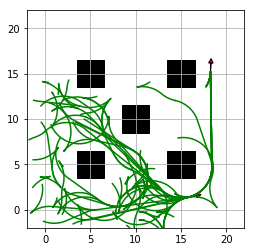

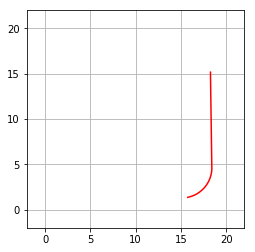

Paths planned: 449
Time taken: 162.248726s
Planning failed
Time taken: 97.223991s


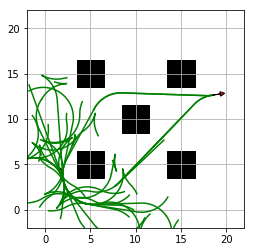

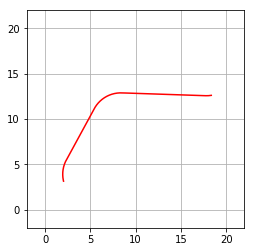

Paths planned: 450
Time taken: 81.504276s


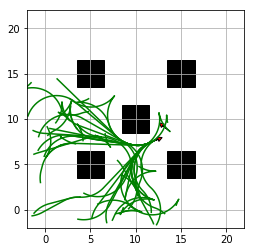

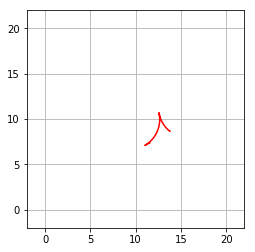

Paths planned: 451
Time taken: 108.860654s
Planning failed
Time taken: 0.000786s
Planning failed
Time taken: 0.000420s
Planning failed
Time taken: 0.000590s
Planning failed
Time taken: 0.000389s


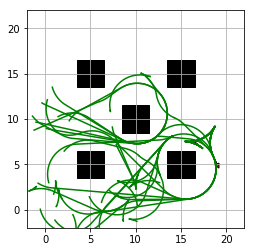

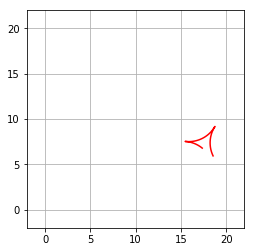

Paths planned: 452
Time taken: 107.793098s


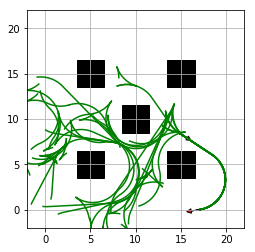

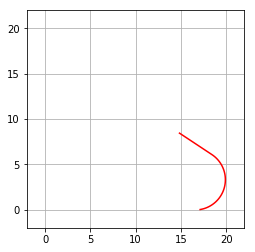

Paths planned: 453
Time taken: 139.733800s
Planning failed
Time taken: 0.001086s
Planning failed
Time taken: 49.698922s


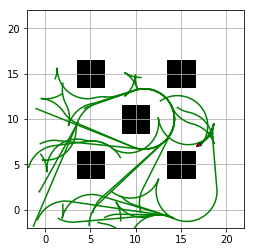

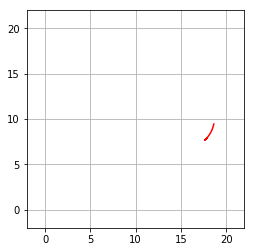

Paths planned: 454
Time taken: 79.729714s


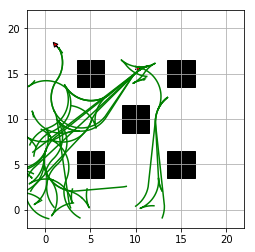

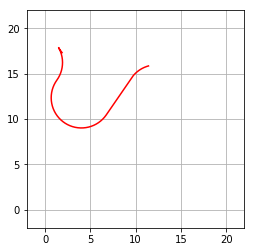

Paths planned: 455
Time taken: 62.371755s
Planning failed
Time taken: 0.000465s
Planning failed
Time taken: 0.000333s
Planning failed
Time taken: 0.000599s
Planning failed
Time taken: 0.000782s
Planning failed
Time taken: 0.000427s
Planning failed
Time taken: 0.000776s


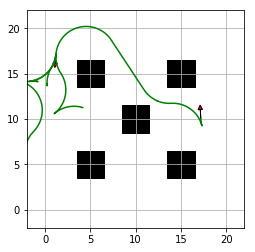

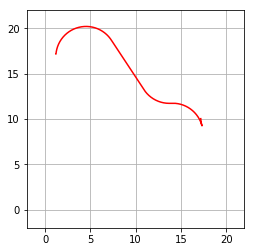

Paths planned: 456
Time taken: 7.286752s


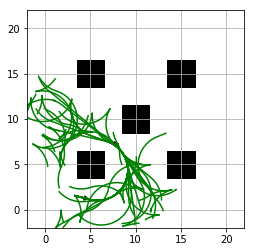

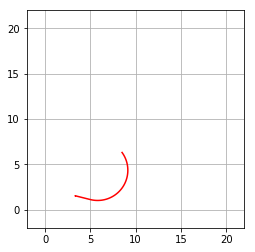

Paths planned: 457
Time taken: 179.358479s
Planning failed
Time taken: 0.000964s
Planning failed
Time taken: 0.000779s


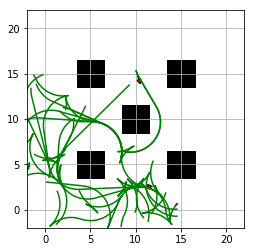

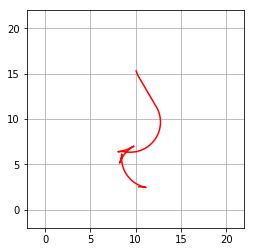

Paths planned: 458
Time taken: 78.385911s
Planning failed
Time taken: 63.314259s


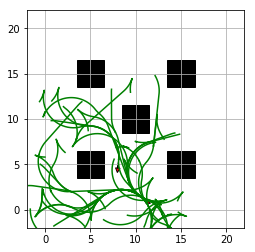

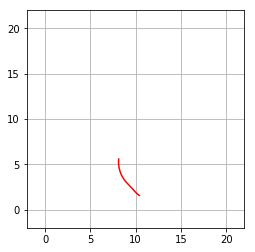

Paths planned: 459
Time taken: 93.179972s
Planning failed
Time taken: 0.001417s
Planning failed
Time taken: 0.001011s
Planning failed
Time taken: 0.000545s
mincost is inf


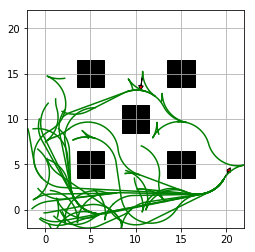

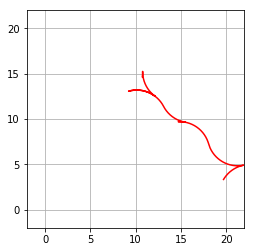

Paths planned: 460
Time taken: 102.166054s


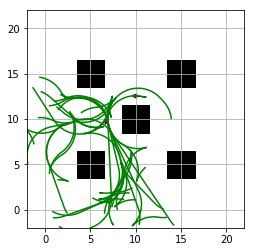

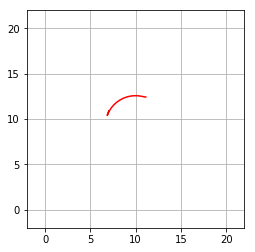

Paths planned: 461
Time taken: 91.125565s
Planning failed
Time taken: 0.000885s


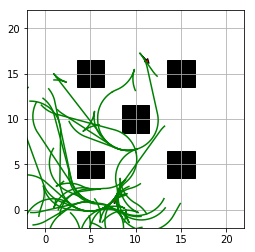

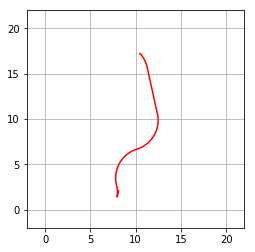

Paths planned: 462
Time taken: 117.630138s


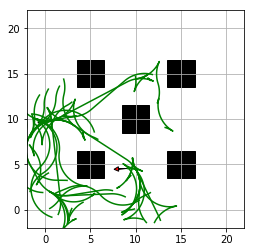

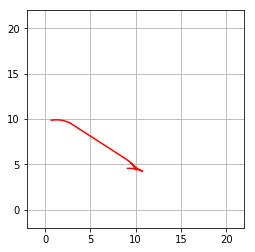

Paths planned: 463
Time taken: 85.867940s


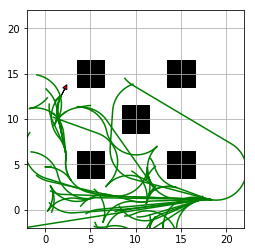

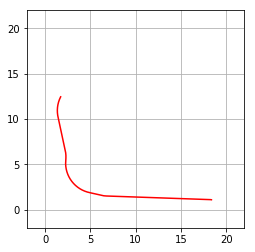

Paths planned: 464
Time taken: 107.846828s
Planning failed
Time taken: 0.001269s


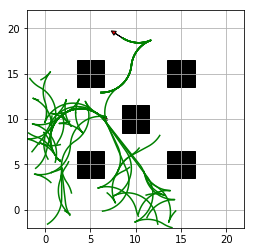

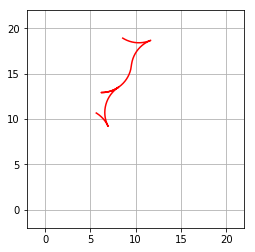

Paths planned: 465
Time taken: 97.446188s


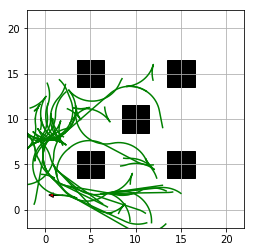

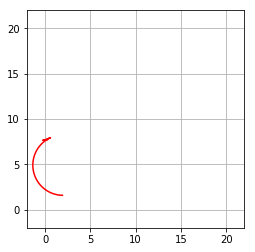

Paths planned: 466
Time taken: 108.141396s
Planning failed
Time taken: 0.000875s


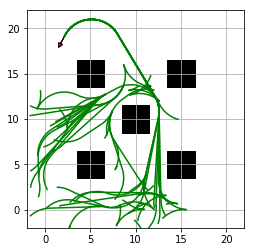

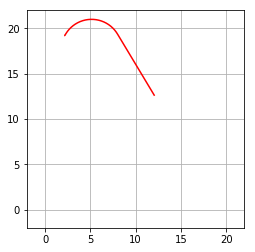

Paths planned: 467
Time taken: 134.144267s


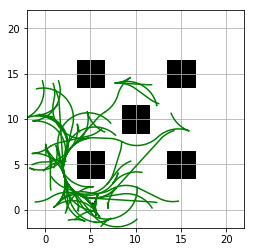

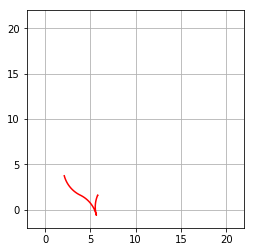

Paths planned: 468
Time taken: 136.497405s
Planning failed
Time taken: 0.000591s
Planning failed
Time taken: 0.000346s


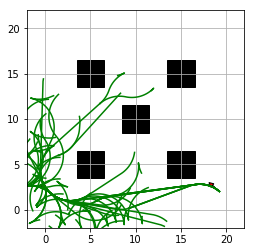

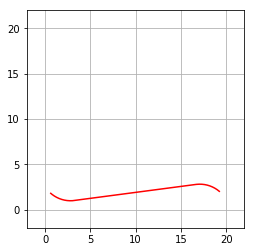

Paths planned: 469
Time taken: 126.133495s
Planning failed
Time taken: 0.001357s
Planning failed
Time taken: 0.001245s
Planning failed
Time taken: 0.000253s


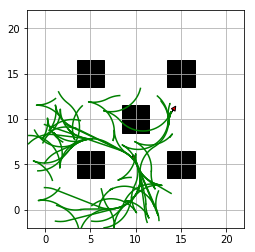

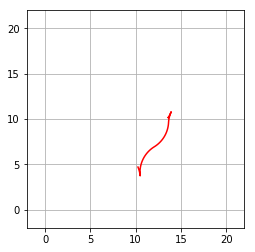

Paths planned: 470
Time taken: 118.516985s


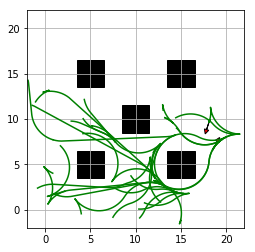

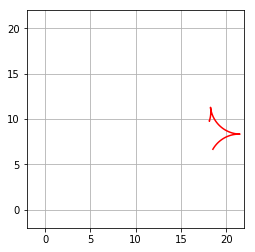

Paths planned: 471
Time taken: 75.679689s


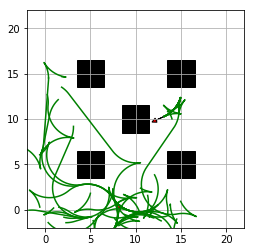

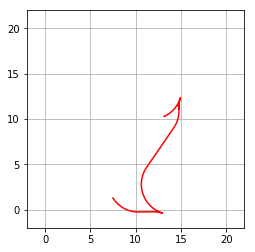

Paths planned: 472
Time taken: 92.991076s
Planning failed
Time taken: 0.001040s
Planning failed
Time taken: 0.001147s


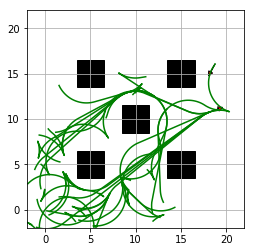

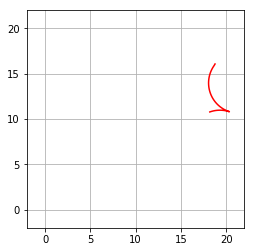

Paths planned: 473
Time taken: 95.159085s
Planning failed
Time taken: 0.001057s


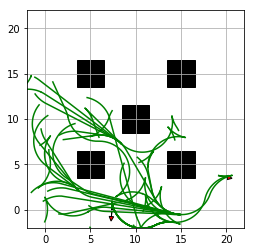

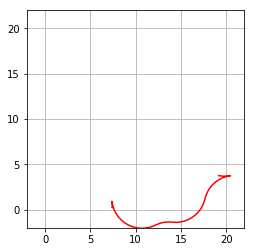

Paths planned: 474
Time taken: 89.866752s
Planning failed
Time taken: 0.000795s
Planning failed
Time taken: 0.000201s
Planning failed
Time taken: 0.000661s
Planning failed
Time taken: 0.000365s
Planning failed
Time taken: 0.000292s
Planning failed
Time taken: 0.000820s


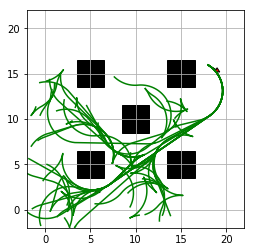

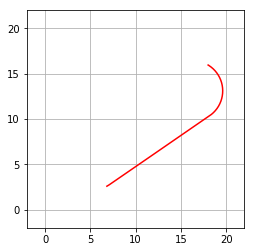

Paths planned: 475
Time taken: 172.721364s
Planning failed
Time taken: 0.001216s
Planning failed
Time taken: 0.001077s


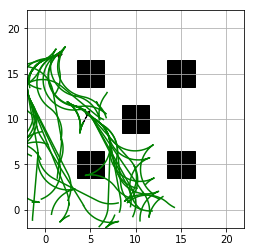

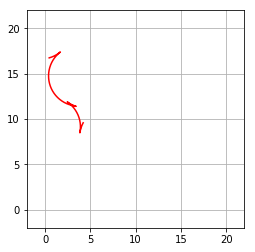

Paths planned: 476
Time taken: 112.473008s
Planning failed
Time taken: 55.752493s
Planning failed
Time taken: 123.527782s


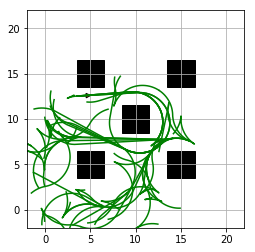

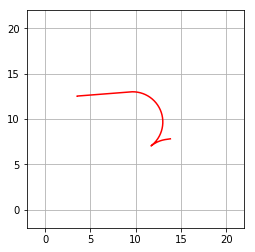

Paths planned: 477
Time taken: 112.493151s


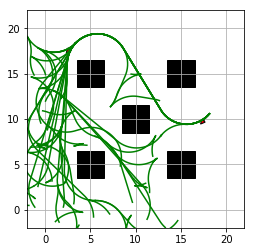

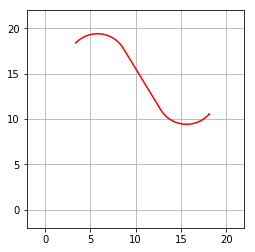

Paths planned: 478
Time taken: 126.682854s
Planning failed
Time taken: 0.000973s


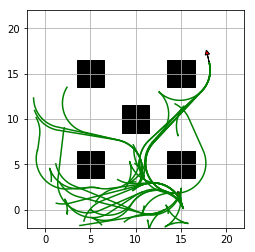

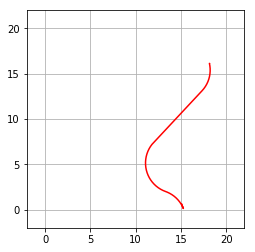

Paths planned: 479
Time taken: 72.868795s


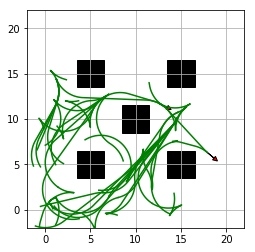

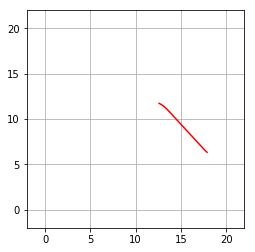

Paths planned: 480
Time taken: 77.049324s


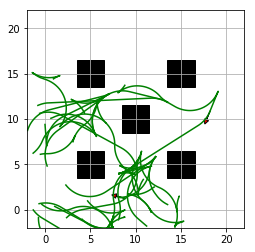

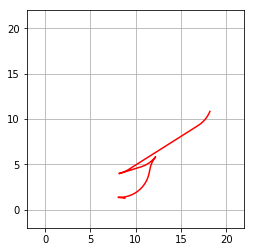

Paths planned: 481
Time taken: 68.538678s
Planning failed
Time taken: 0.001132s


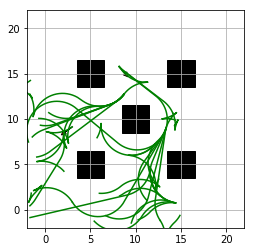

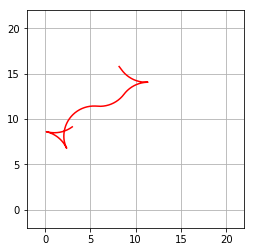

Paths planned: 482
Time taken: 51.054406s
Planning failed
Time taken: 0.000677s
Planning failed
Time taken: 0.000790s


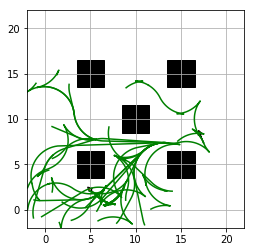

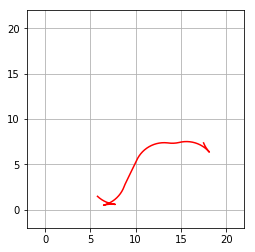

Paths planned: 483
Time taken: 95.052832s
Planning failed
Time taken: 0.000757s


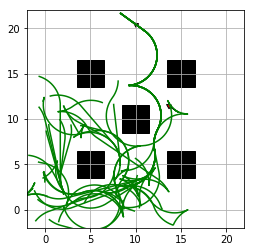

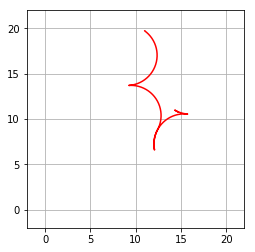

Paths planned: 484
Time taken: 117.088678s
Planning failed
Time taken: 51.611721s
mincost is inf


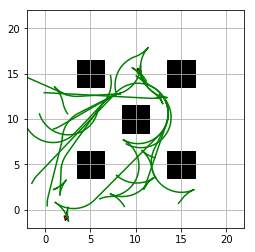

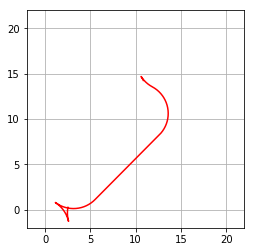

Paths planned: 485
Time taken: 40.482743s


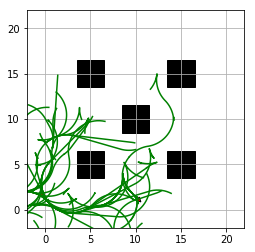

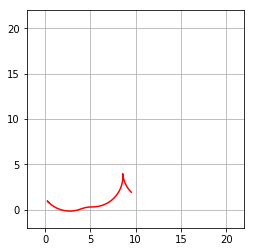

Paths planned: 486
Time taken: 96.205954s


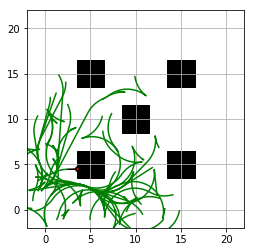

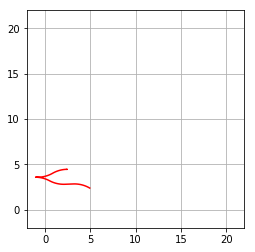

Paths planned: 487
Time taken: 116.709413s
Planning failed
Time taken: 0.001184s


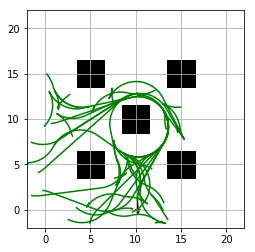

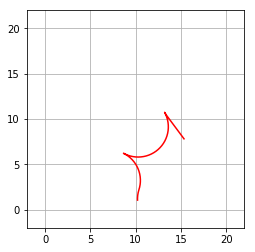

Paths planned: 488
Time taken: 76.105097s
Planning failed
Time taken: 0.000747s
Planning failed
Time taken: 0.001014s
Planning failed
Time taken: 89.671506s


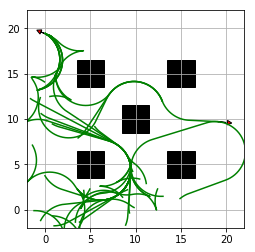

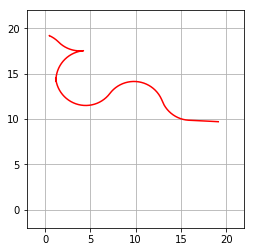

Paths planned: 489
Time taken: 75.136477s


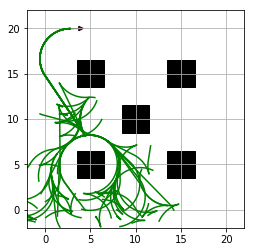

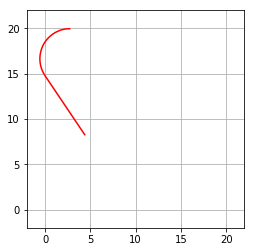

Paths planned: 490
Time taken: 134.391019s
Planning failed
Time taken: 0.000998s
Planning failed
Time taken: 0.000202s
Planning failed
Time taken: 41.349865s


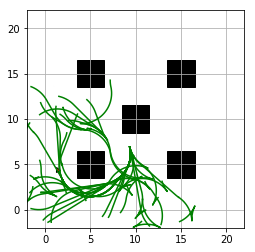

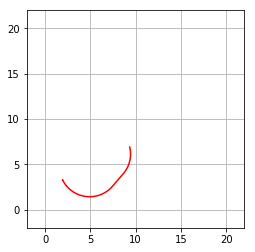

Paths planned: 491
Time taken: 145.021366s


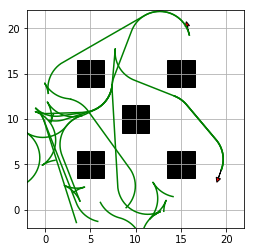

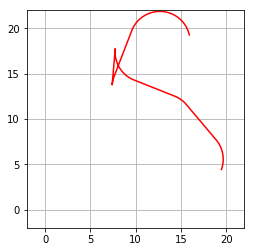

Paths planned: 492
Time taken: 28.985703s


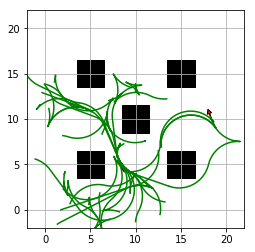

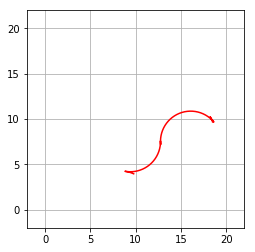

Paths planned: 493
Time taken: 83.692765s
Planning failed
Time taken: 0.000939s
Planning failed
Time taken: 0.000641s
Planning failed
Time taken: 0.000358s
Planning failed
Time taken: 0.000635s
Planning failed
Time taken: 0.000694s
Planning failed
Time taken: 0.000250s
Planning failed
Time taken: 0.000610s


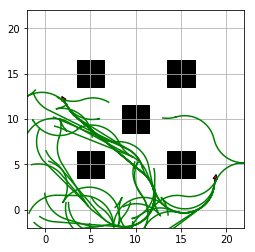

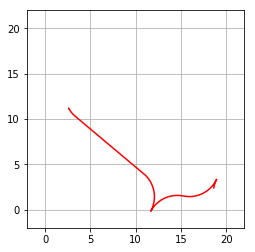

Paths planned: 494
Time taken: 107.211690s
Planning failed
Time taken: 79.385862s


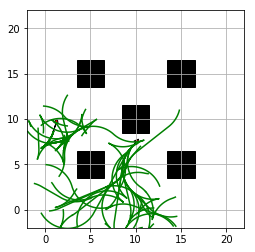

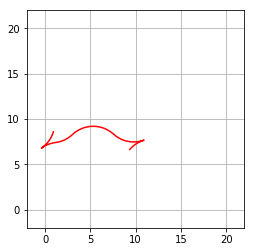

Paths planned: 495
Time taken: 111.422795s


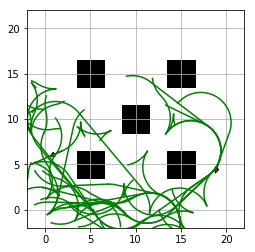

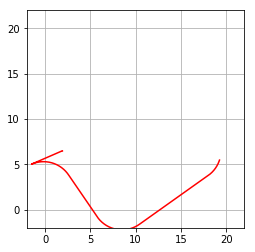

Paths planned: 496
Time taken: 87.878348s


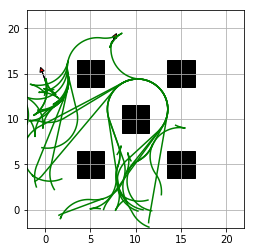

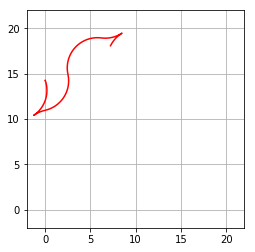

Paths planned: 497
Time taken: 58.650683s


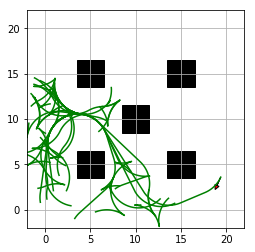

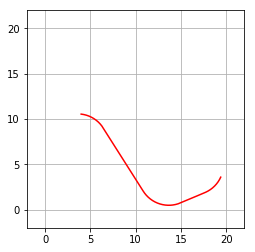

Paths planned: 498
Time taken: 85.551304s
Planning failed
Time taken: 0.001178s
Planning failed
Time taken: 0.001143s
Planning failed
Time taken: 0.000707s
Planning failed
Time taken: 0.000535s


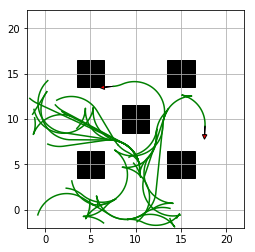

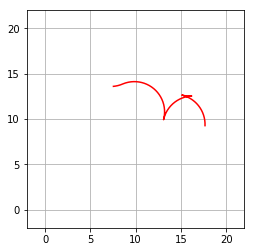

Paths planned: 499
Time taken: 40.942509s
Planning failed
Time taken: 0.001029s
Planning failed
Time taken: 0.000208s


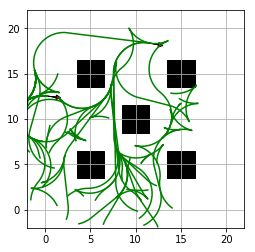

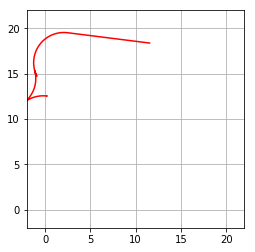

Paths planned: 500
Time taken: 114.348957s
Planning failed
Time taken: 0.000897s
Planning failed
Time taken: 0.000747s


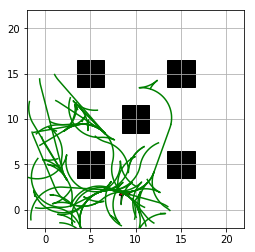

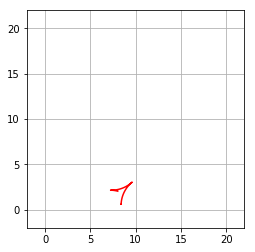

Paths planned: 501
Time taken: 106.355951s
Planning failed
Time taken: 2.339836s
Planning failed
Time taken: 0.000198s


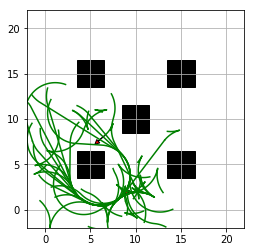

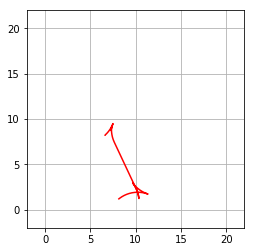

Paths planned: 502
Time taken: 72.750094s


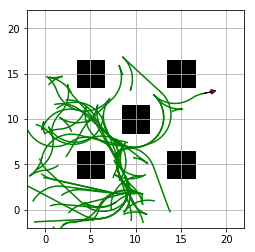

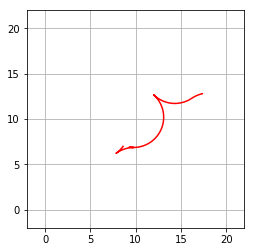

Paths planned: 503
Time taken: 114.835402s


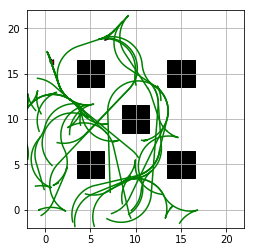

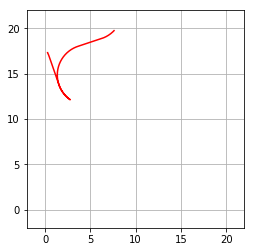

Paths planned: 504
Time taken: 97.668843s


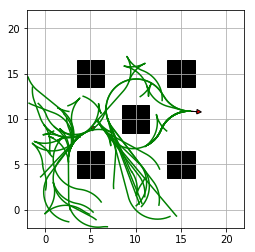

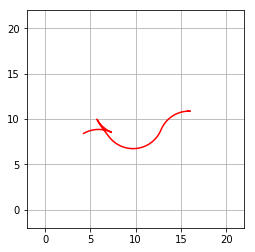

Paths planned: 505
Time taken: 136.138952s
Planning failed
Time taken: 0.001023s
Planning failed
Time taken: 0.000242s
Planning failed
Time taken: 0.000214s
Planning failed
Time taken: 0.000790s
Planning failed
Time taken: 0.000770s
Planning failed
Time taken: 0.000966s
Planning failed
Time taken: 0.000391s
Planning failed
Time taken: 0.000203s
Planning failed
Time taken: 0.000695s


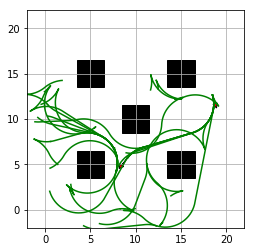

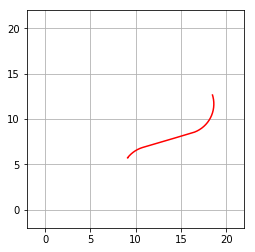

Paths planned: 506
Time taken: 50.875131s
Planning failed
Time taken: 86.275569s
mincost is inf


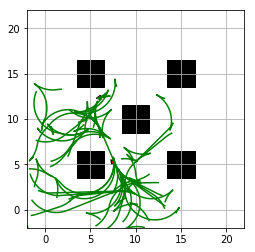

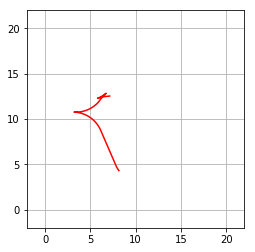

Paths planned: 507
Time taken: 122.445229s


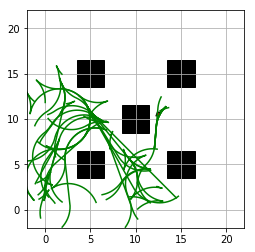

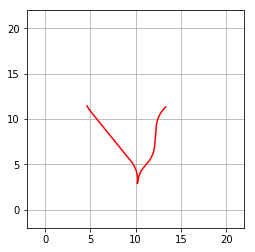

Paths planned: 508
Time taken: 105.162595s


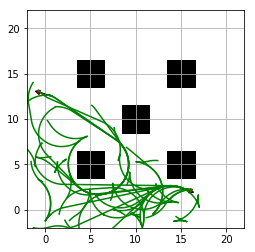

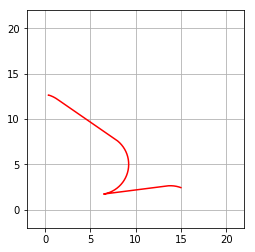

Paths planned: 509
Time taken: 83.204619s
Planning failed
Time taken: 0.001635s
Planning failed
Time taken: 0.001070s
Planning failed
Time taken: 91.546654s


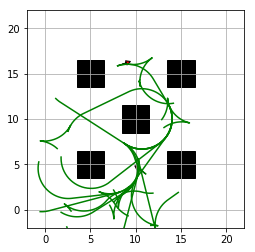

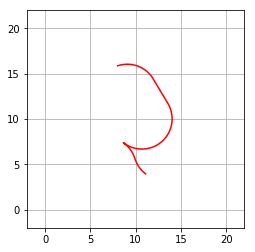

Paths planned: 510
Time taken: 26.164079s
Planning failed
Time taken: 0.001142s


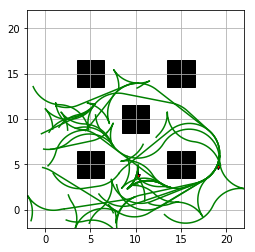

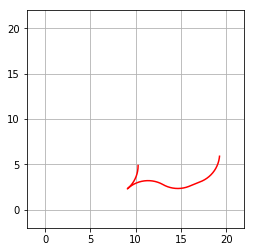

Paths planned: 511
Time taken: 107.293139s
Planning failed
Time taken: 137.861529s
Planning failed
Time taken: 0.000726s
Planning failed
Time taken: 0.000903s
Planning failed
Time taken: 0.000963s
Planning failed
Time taken: 0.000466s
Planning failed
Time taken: 3.078453s


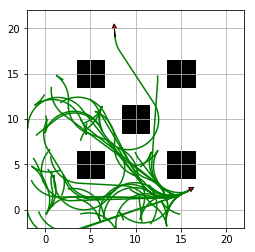

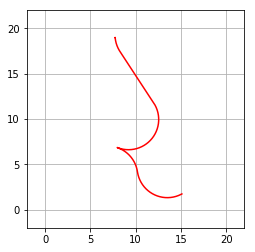

Paths planned: 512
Time taken: 87.608691s
Planning failed
Time taken: 0.001012s
Planning failed
Time taken: 0.000972s
Planning failed
Time taken: 71.429100s


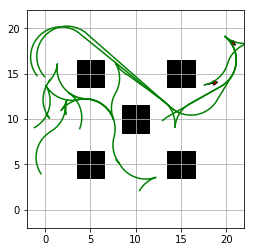

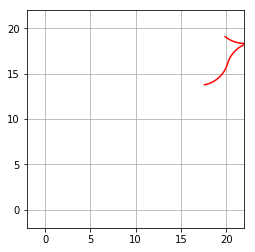

Paths planned: 513
Time taken: 13.237639s
Planning failed
Time taken: 0.002045s


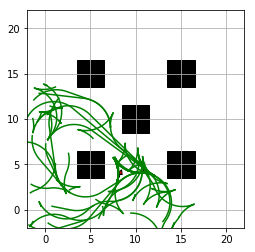

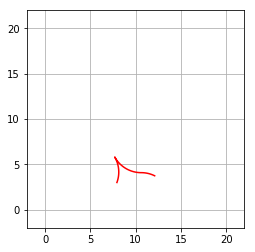

Paths planned: 514
Time taken: 146.555759s


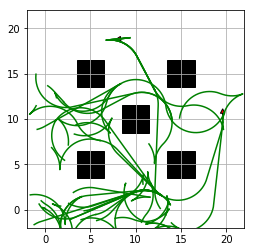

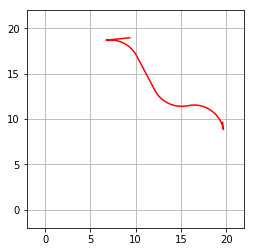

Paths planned: 515
Time taken: 83.849032s
Planning failed
Time taken: 0.000483s
Planning failed
Time taken: 0.000726s


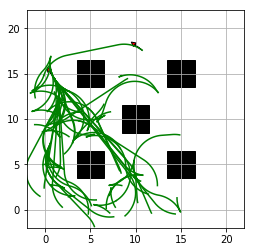

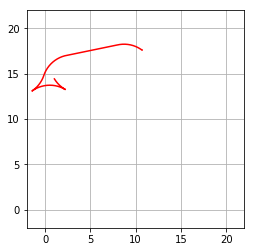

Paths planned: 516
Time taken: 107.590831s
Planning failed
Time taken: 0.001122s
Planning failed
Time taken: 0.000660s
Planning failed
Time taken: 0.000331s
Planning failed
Time taken: 0.001184s
Planning failed
Time taken: 0.001137s


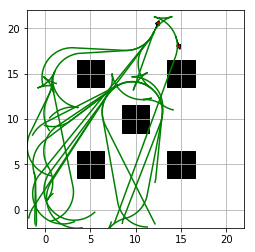

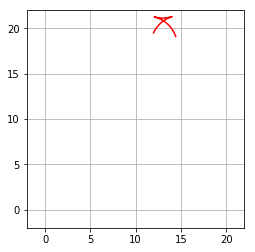

Paths planned: 517
Time taken: 51.464365s
Planning failed
Time taken: 90.381526s
Planning failed
Time taken: 0.000686s
Planning failed
Time taken: 0.000884s
Planning failed
Time taken: 0.000316s
Planning failed
Time taken: 0.000773s


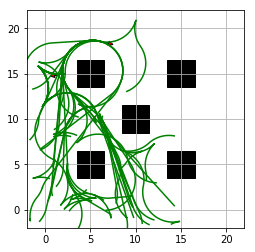

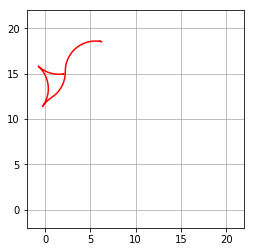

Paths planned: 518
Time taken: 119.648925s
Planning failed
Time taken: 0.000754s


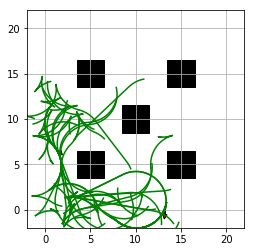

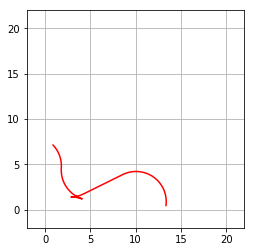

Paths planned: 519
Time taken: 145.658210s
Planning failed
Time taken: 0.001732s


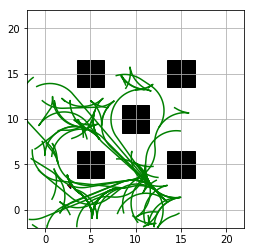

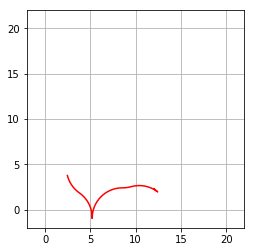

Paths planned: 520
Time taken: 182.525357s
Planning failed
Time taken: 0.000919s
Planning failed
Time taken: 89.979179s
Planning failed
Time taken: 115.455519s
Planning failed
Time taken: 0.000894s
Planning failed
Time taken: 0.001075s


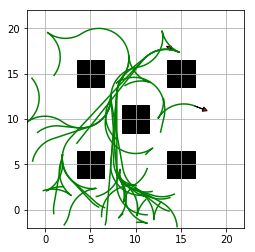

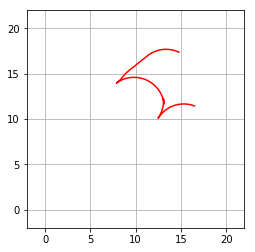

Paths planned: 521
Time taken: 62.588726s


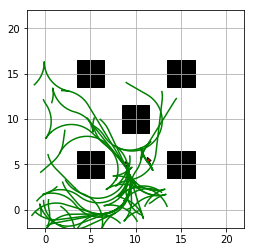

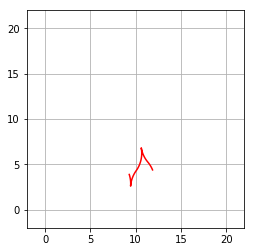

Paths planned: 522
Time taken: 118.170041s


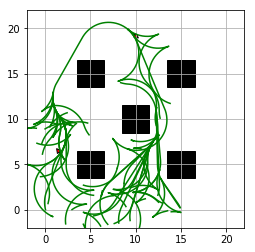

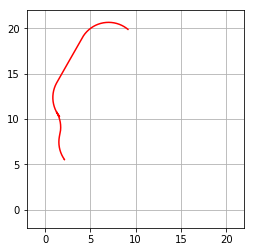

Paths planned: 523
Time taken: 107.637681s
Planning failed
Time taken: 0.000476s
Planning failed
Time taken: 0.000522s
Planning failed
Time taken: 77.154550s
Planning failed
Time taken: 0.001132s
Planning failed
Time taken: 0.000720s
Planning failed
Time taken: 0.000997s
Planning failed
Time taken: 64.770490s


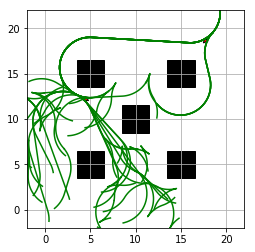

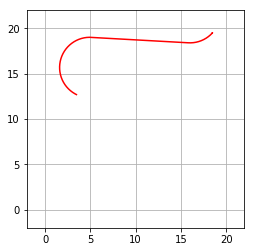

Paths planned: 524
Time taken: 112.736862s
Planning failed
Time taken: 0.001140s


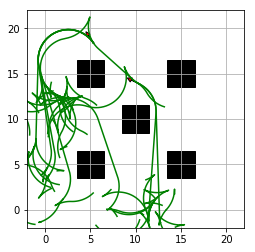

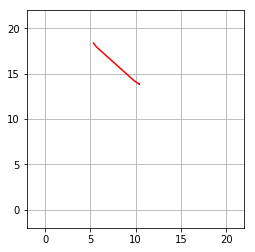

Paths planned: 525
Time taken: 98.819883s


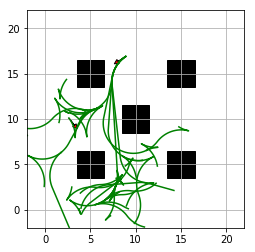

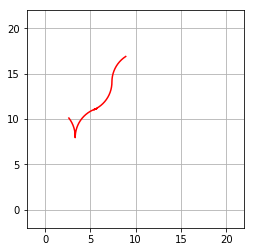

Paths planned: 526
Time taken: 44.405511s


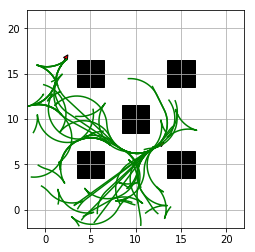

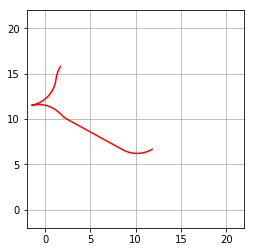

Paths planned: 527
Time taken: 115.118234s
Planning failed
Time taken: 0.000775s
Planning failed
Time taken: 0.000276s
Planning failed
Time taken: 0.001309s
Planning failed
Time taken: 0.001411s


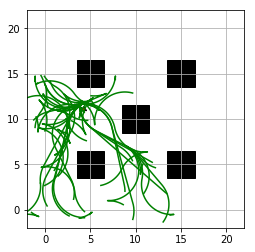

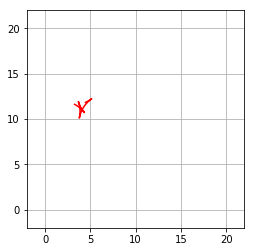

Paths planned: 528
Time taken: 96.139569s
Planning failed
Time taken: 51.798807s


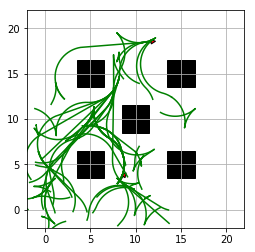

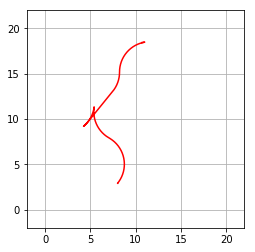

Paths planned: 529
Time taken: 138.533867s


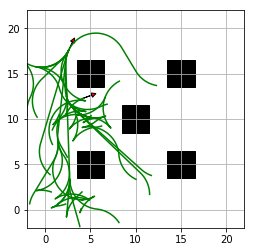

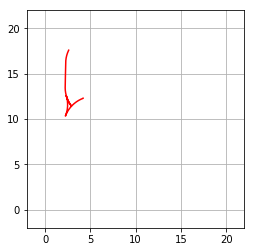

Paths planned: 530
Time taken: 39.857194s
Planning failed
Time taken: 0.000481s
Planning failed
Time taken: 70.004352s


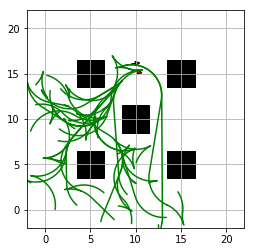

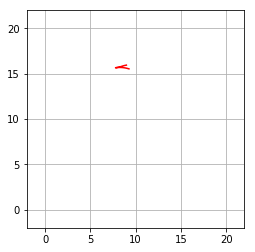

Paths planned: 531
Time taken: 79.616592s
Planning failed
Time taken: 0.000423s


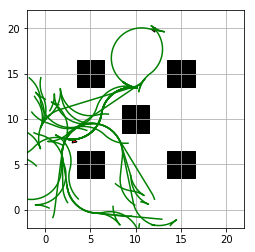

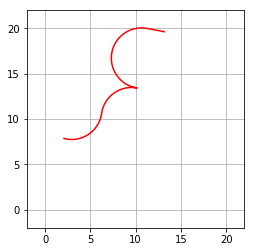

Paths planned: 532
Time taken: 71.675491s
Planning failed
Time taken: 0.000863s
Planning failed
Time taken: 107.088777s
Planning failed
Time taken: 0.001137s
Planning failed
Time taken: 0.000334s


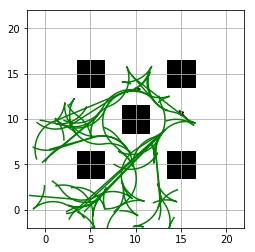

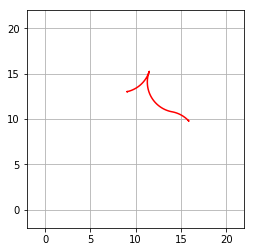

Paths planned: 533
Time taken: 105.108457s
Planning failed
Time taken: 0.000579s


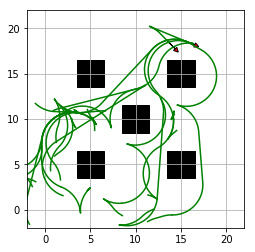

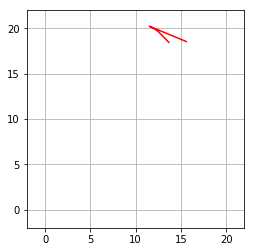

Paths planned: 534
Time taken: 47.576307s


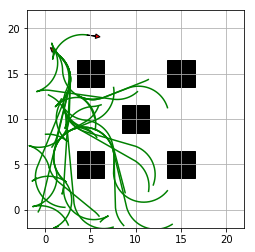

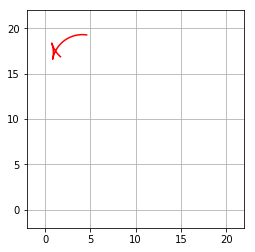

Paths planned: 535
Time taken: 51.092766s
Planning failed
Time taken: 0.001133s
Planning failed
Time taken: 0.000981s
Planning failed
Time taken: 0.000620s
Planning failed
Time taken: 0.000218s


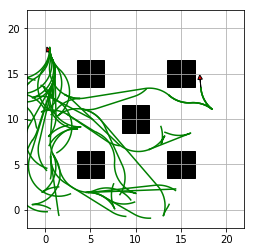

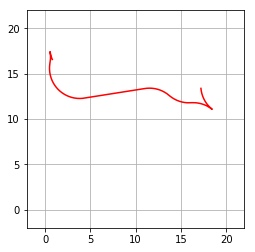

Paths planned: 536
Time taken: 94.772686s
Planning failed
Time taken: 0.000984s
Planning failed
Time taken: 85.244298s
Planning failed
Time taken: 0.001111s


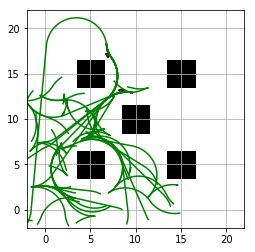

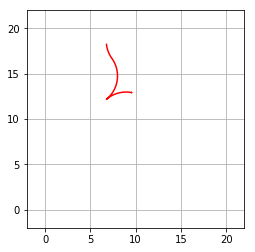

Paths planned: 537
Time taken: 121.802772s


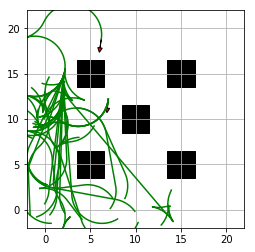

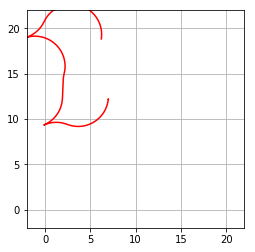

Paths planned: 538
Time taken: 105.223986s


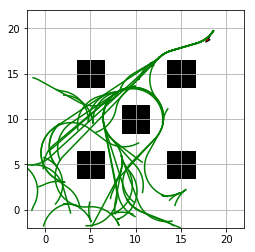

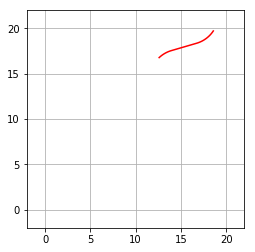

Paths planned: 539
Time taken: 105.825126s


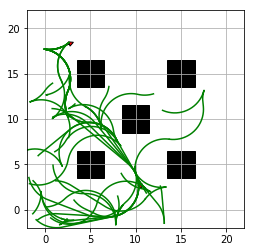

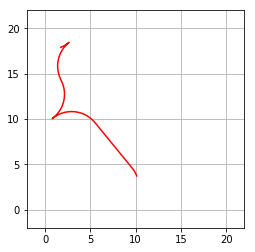

Paths planned: 540
Time taken: 87.978262s


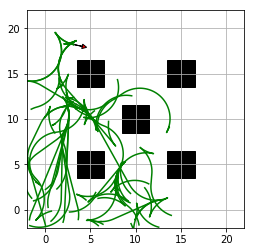

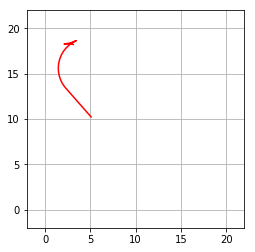

Paths planned: 541
Time taken: 115.657344s
Planning failed
Time taken: 0.000684s
Planning failed
Time taken: 0.000880s
Planning failed
Time taken: 0.000557s


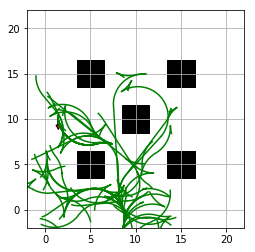

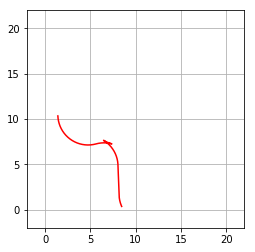

Paths planned: 542
Time taken: 164.451332s


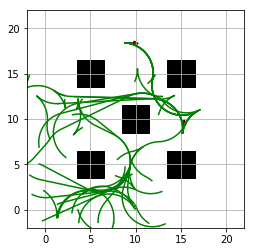

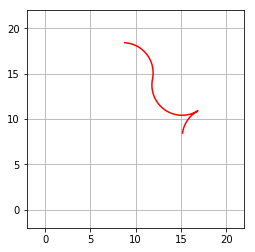

Paths planned: 543
Time taken: 69.549243s


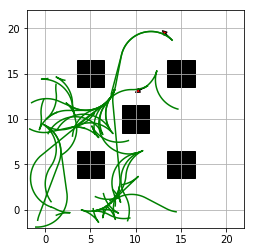

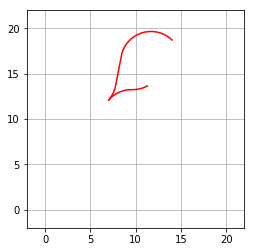

Paths planned: 544
Time taken: 60.517759s
Planning failed
Time taken: 0.000807s


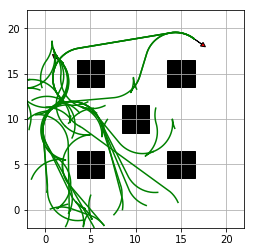

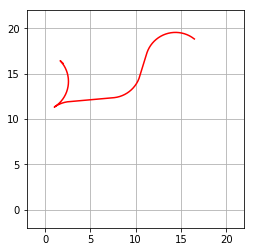

Paths planned: 545
Time taken: 86.511836s
Planning failed
Time taken: 63.605959s


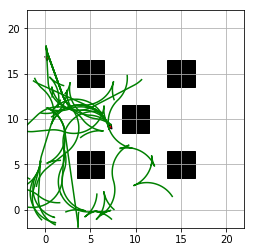

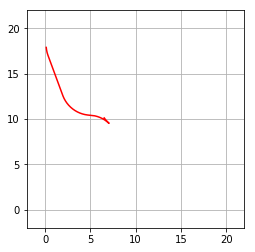

Paths planned: 546
Time taken: 87.484873s
Planning failed
Time taken: 44.033621s
mincost is inf


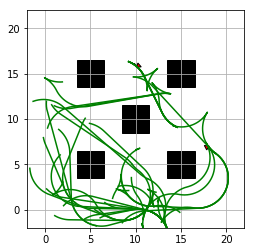

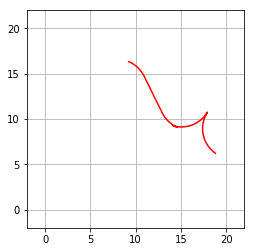

Paths planned: 547
Time taken: 76.851739s
Planning failed
Time taken: 73.386553s
Planning failed
Time taken: 0.001083s
Planning failed
Time taken: 0.000876s
Planning failed
Time taken: 59.086211s
Planning failed
Time taken: 0.000732s


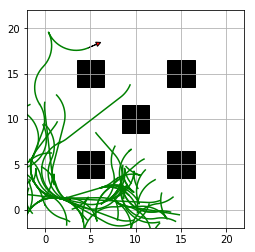

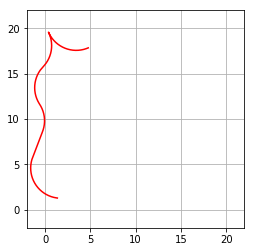

Paths planned: 548
Time taken: 110.941705s


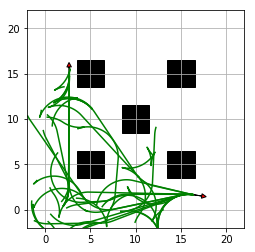

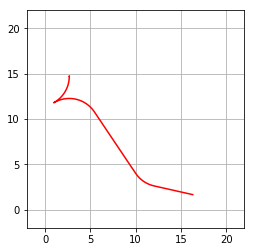

Paths planned: 549
Time taken: 102.688795s


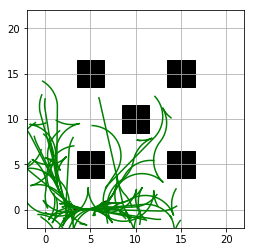

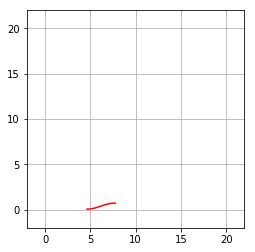

Paths planned: 550
Time taken: 145.820537s


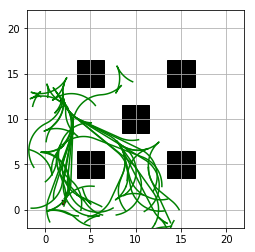

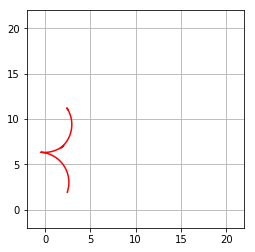

Paths planned: 551
Time taken: 124.749967s
Planning failed
Time taken: 71.932227s


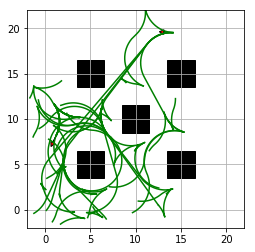

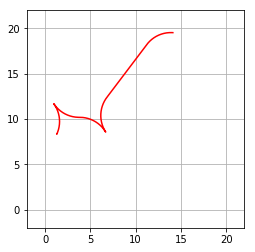

Paths planned: 552
Time taken: 108.148949s
Planning failed
Time taken: 0.001265s
Planning failed
Time taken: 26.250576s
Planning failed
Time taken: 0.000673s
Planning failed
Time taken: 0.000559s


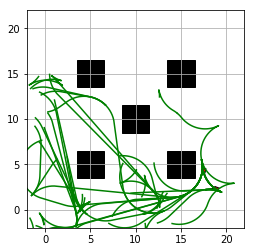

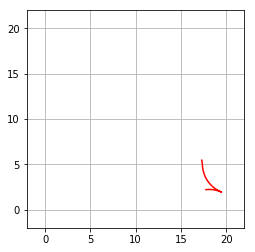

Paths planned: 553
Time taken: 108.685793s


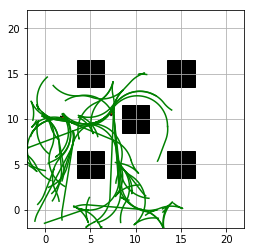

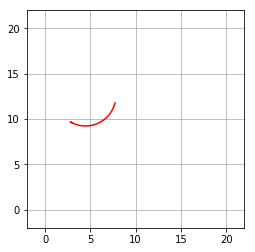

Paths planned: 554
Time taken: 129.124499s
Planning failed
Time taken: 0.000479s


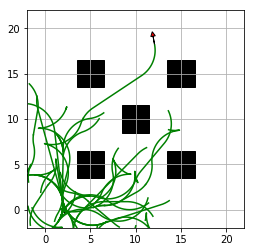

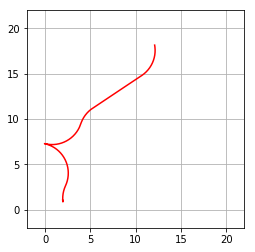

Paths planned: 555
Time taken: 72.530558s


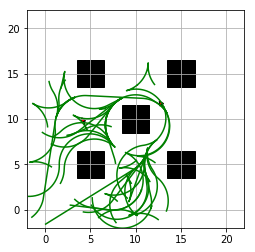

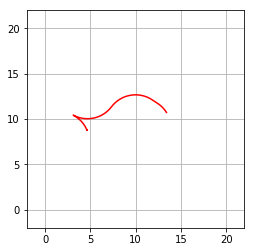

Paths planned: 556
Time taken: 57.528581s
Planning failed
Time taken: 0.000775s
Planning failed
Time taken: 0.000726s


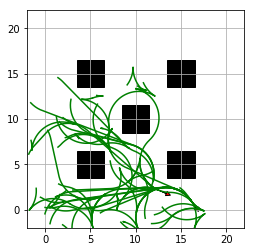

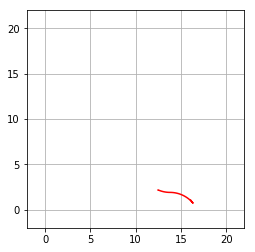

Paths planned: 557
Time taken: 105.284159s
Planning failed
Time taken: 0.001020s
Planning failed
Time taken: 0.000795s
Planning failed
Time taken: 0.000520s
Planning failed
Time taken: 0.000206s


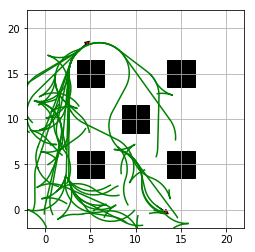

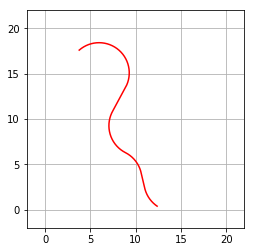

Paths planned: 558
Time taken: 118.269513s
Planning failed
Time taken: 10.649626s
Planning failed
Time taken: 115.855905s
Planning failed
Time taken: 0.001076s
Planning failed
Time taken: 0.000948s
Planning failed
Time taken: 0.000183s
Planning failed
Time taken: 135.356349s


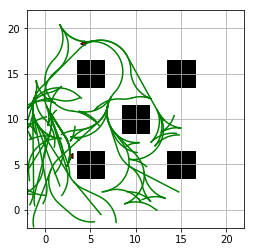

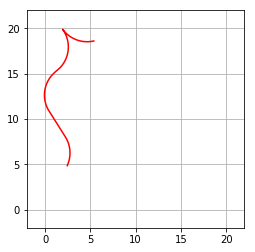

Paths planned: 559
Time taken: 123.022522s
Planning failed
Time taken: 0.000859s
Planning failed
Time taken: 98.814692s
Planning failed
Time taken: 0.000585s


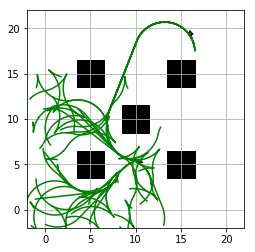

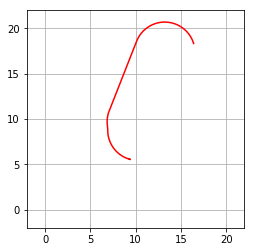

Paths planned: 560
Time taken: 103.422150s


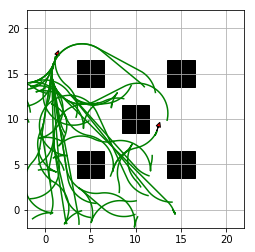

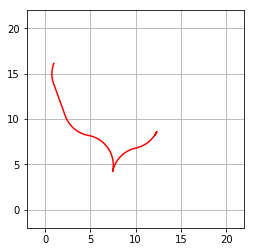

Paths planned: 561
Time taken: 103.538681s
Planning failed
Time taken: 0.000763s
Planning failed
Time taken: 0.000550s
Planning failed
Time taken: 0.000893s
Planning failed
Time taken: 0.000440s
Planning failed
Time taken: 0.000438s
Planning failed
Time taken: 0.000184s
Planning failed
Time taken: 0.000186s
Planning failed
Time taken: 0.000305s
Planning failed
Time taken: 71.019603s
Planning failed
Time taken: 0.001215s
Planning failed
Time taken: 0.000987s


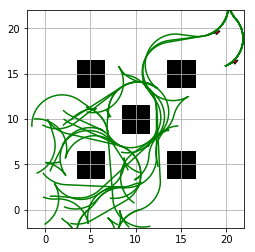

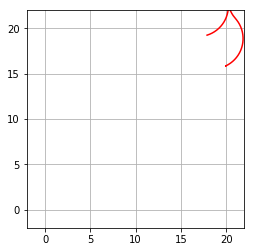

Paths planned: 562
Time taken: 102.250842s
Planning failed
Time taken: 0.000606s
Planning failed
Time taken: 37.799287s


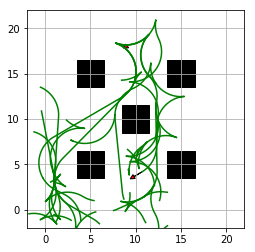

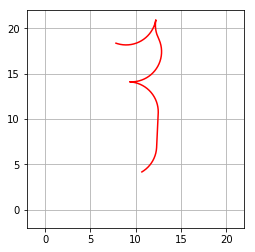

Paths planned: 563
Time taken: 54.647731s


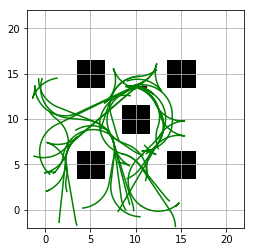

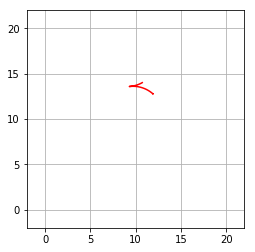

Paths planned: 564
Time taken: 113.463810s


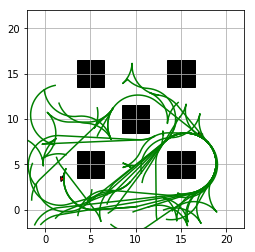

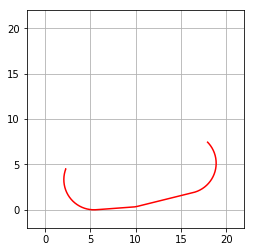

Paths planned: 565
Time taken: 94.998992s
Planning failed
Time taken: 0.000763s
Planning failed
Time taken: 0.000449s
Planning failed
Time taken: 0.000677s
Planning failed
Time taken: 0.000222s
Planning failed
Time taken: 0.000521s
Planning failed
Time taken: 0.000217s


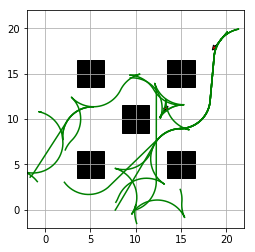

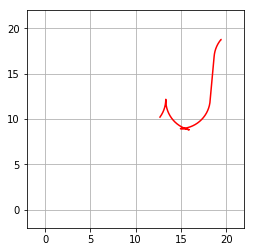

Paths planned: 566
Time taken: 29.592924s
Planning failed
Time taken: 0.002553s
Planning failed
Time taken: 0.000667s


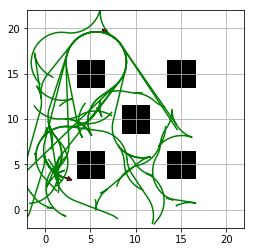

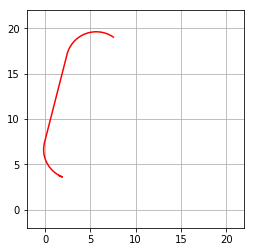

Paths planned: 567
Time taken: 172.663748s


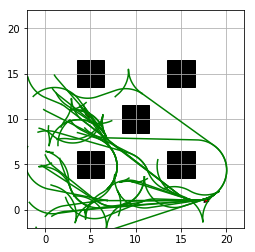

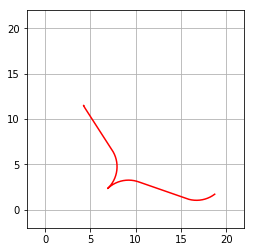

Paths planned: 568
Time taken: 108.072397s


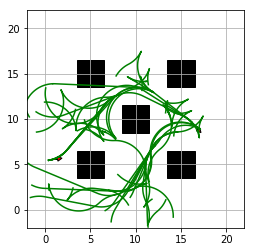

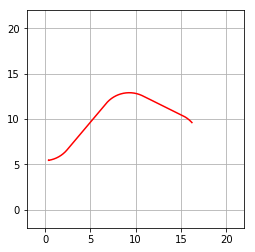

Paths planned: 569
Time taken: 87.101169s
Planning failed
Time taken: 0.000649s
Planning failed
Time taken: 1.863794s
Planning failed
Time taken: 0.000664s
Planning failed
Time taken: 0.000298s


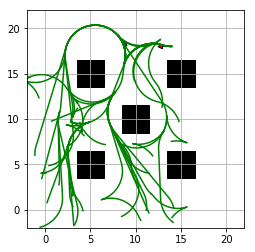

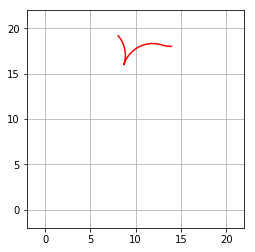

Paths planned: 570
Time taken: 89.173475s
Planning failed
Time taken: 0.000499s


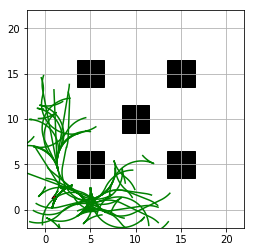

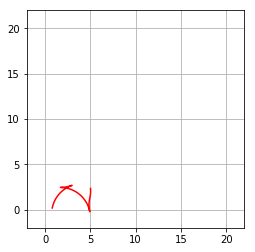

Paths planned: 571
Time taken: 178.074429s
Planning failed
Time taken: 0.002057s
Planning failed
Time taken: 0.002772s


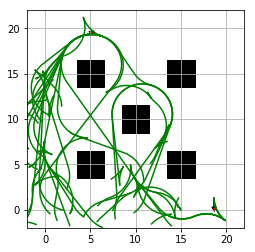

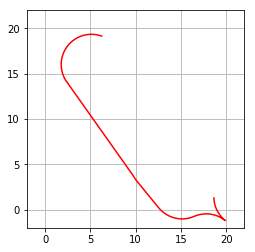

Paths planned: 572
Time taken: 120.061278s
Planning failed
Time taken: 44.636783s
Planning failed
Time taken: 4.580480s
Planning failed
Time taken: 0.000705s


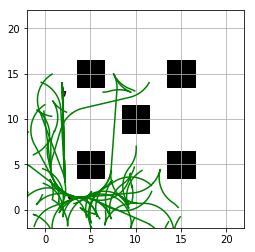

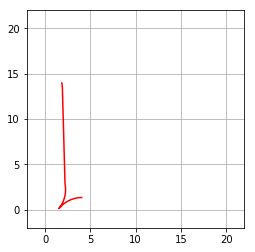

Paths planned: 573
Time taken: 123.690621s
Planning failed
Time taken: 0.001176s
Planning failed
Time taken: 0.000727s


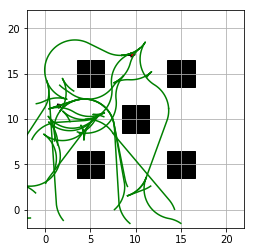

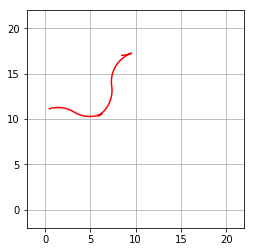

Paths planned: 574
Time taken: 46.895612s
Planning failed
Time taken: 0.000834s
Planning failed
Time taken: 0.000965s


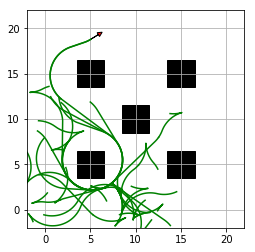

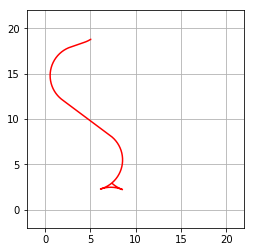

Paths planned: 575
Time taken: 48.123570s
Planning failed
Time taken: 0.000433s
Planning failed
Time taken: 93.778024s


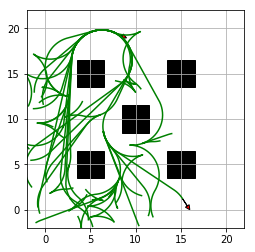

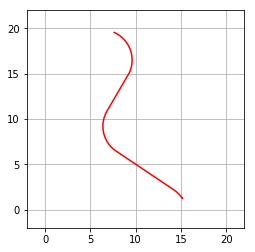

Paths planned: 576
Time taken: 97.354452s


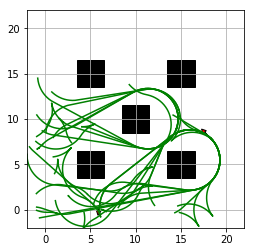

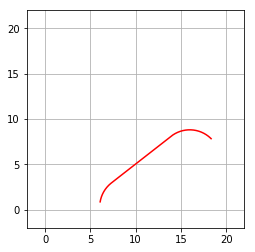

Paths planned: 577
Time taken: 85.597610s


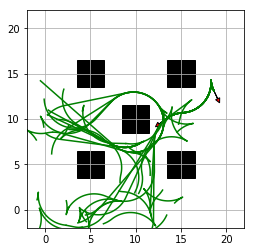

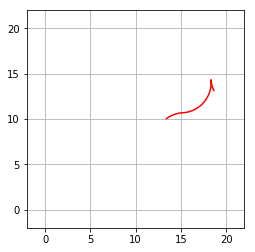

Paths planned: 578
Time taken: 130.802760s
Planning failed
Time taken: 0.000713s
Planning failed
Time taken: 0.000242s
Planning failed
Time taken: 0.000842s
Planning failed
Time taken: 0.000342s
Planning failed
Time taken: 0.000328s
Planning failed
Time taken: 0.001057s
Planning failed
Time taken: 0.000745s
Planning failed
Time taken: 0.000750s
Planning failed
Time taken: 0.000817s
Planning failed
Time taken: 0.000336s
Planning failed
Time taken: 0.000214s


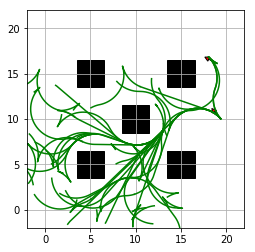

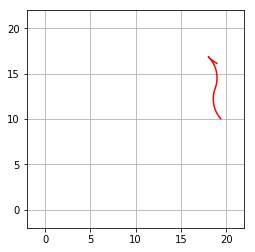

Paths planned: 579
Time taken: 90.854499s
Planning failed
Time taken: 85.716110s
Planning failed
Time taken: 0.000912s
Planning failed
Time taken: 0.000430s


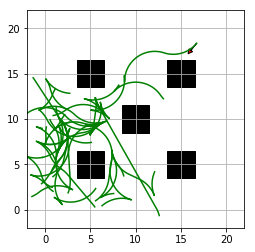

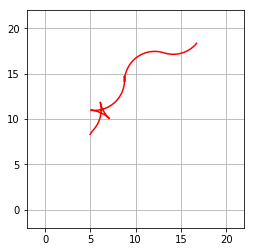

Paths planned: 580
Time taken: 70.688398s
Planning failed
Time taken: 61.041933s


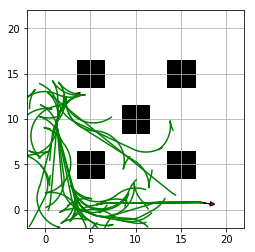

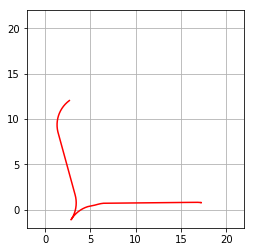

Paths planned: 581
Time taken: 185.013592s
Planning failed
Time taken: 0.000876s


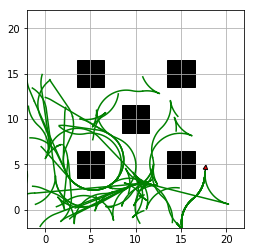

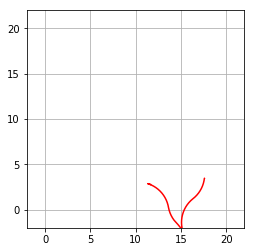

Paths planned: 582
Time taken: 145.064901s


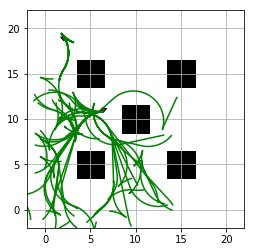

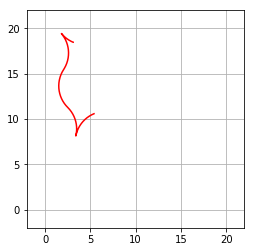

Paths planned: 583
Time taken: 144.522479s
Planning failed
Time taken: 77.250364s
Planning failed
Time taken: 0.001158s


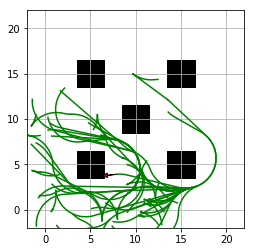

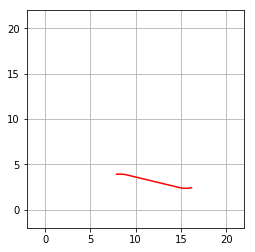

Paths planned: 584
Time taken: 100.736806s
Planning failed
Time taken: 0.000654s


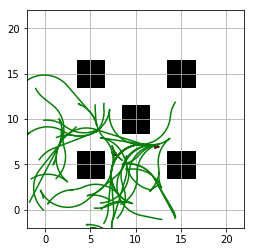

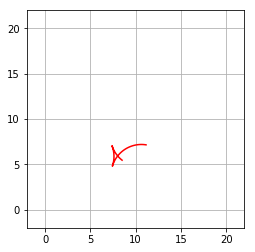

Paths planned: 585
Time taken: 83.818512s


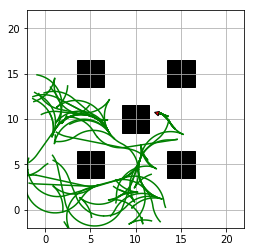

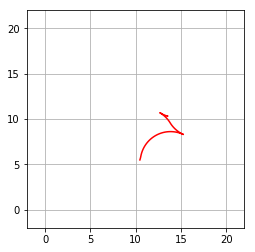

Paths planned: 586
Time taken: 116.530296s
Planning failed
Time taken: 0.000833s
Planning failed
Time taken: 0.000715s


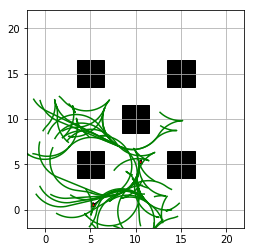

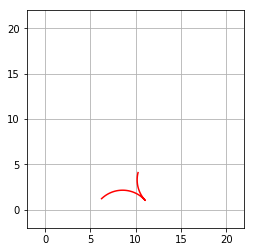

Paths planned: 587
Time taken: 148.982020s


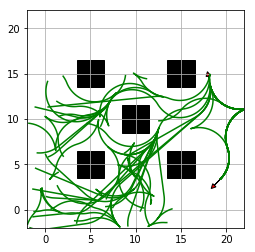

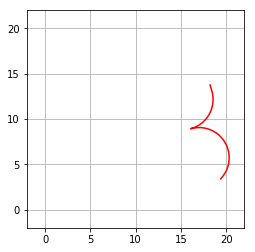

Paths planned: 588
Time taken: 166.782491s
Planning failed
Time taken: 0.001215s


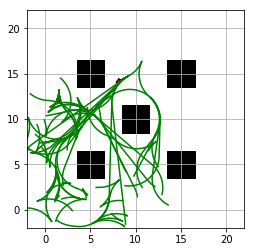

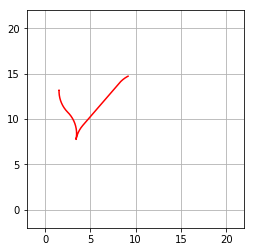

Paths planned: 589
Time taken: 119.196508s
Planning failed
Time taken: 72.963078s
Planning failed
Time taken: 0.000754s
Planning failed
Time taken: 0.000335s


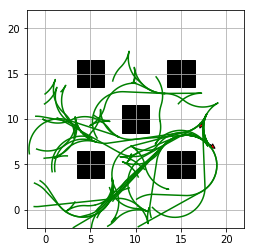

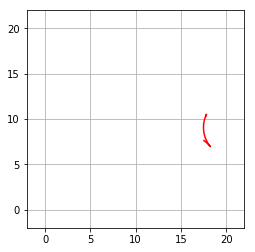

Paths planned: 590
Time taken: 139.186315s
Planning failed
Time taken: 0.001037s


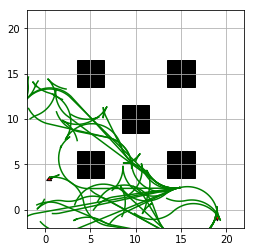

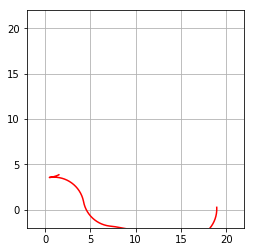

Paths planned: 591
Time taken: 75.538217s
Planning failed
Time taken: 0.001074s
Planning failed
Time taken: 0.000361s


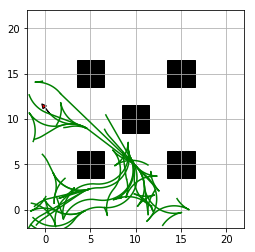

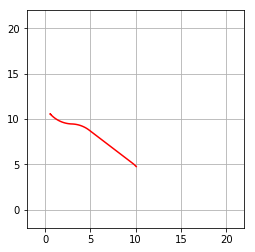

Paths planned: 592
Time taken: 80.108245s


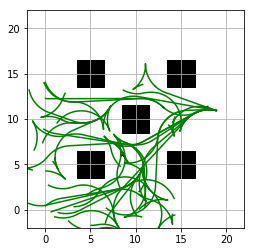

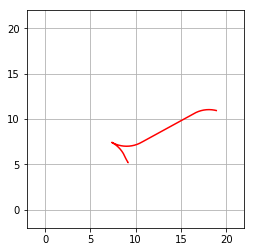

Paths planned: 593
Time taken: 134.348837s


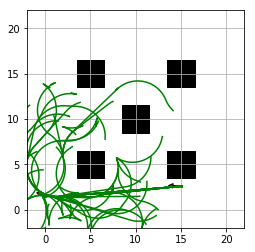

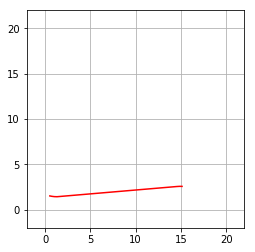

Paths planned: 594
Time taken: 132.143850s
Planning failed
Time taken: 93.580458s
Planning failed
Time taken: 0.001284s
mincost is inf
Planning failed
Time taken: 62.763743s


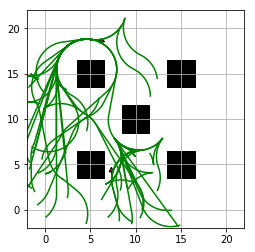

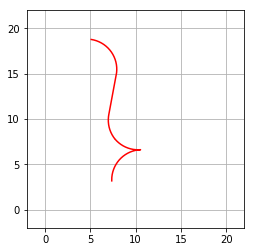

Paths planned: 595
Time taken: 104.874712s
Planning failed
Time taken: 0.000880s
Planning failed
Time taken: 56.478940s
Planning failed
Time taken: 0.001164s
Planning failed
Time taken: 3.714962s


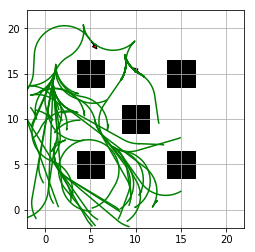

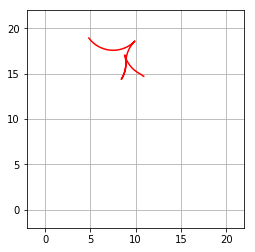

Paths planned: 596
Time taken: 137.839011s
Planning failed
Time taken: 0.000859s


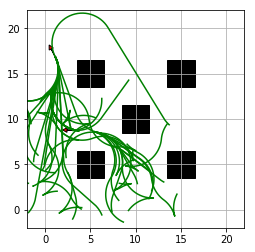

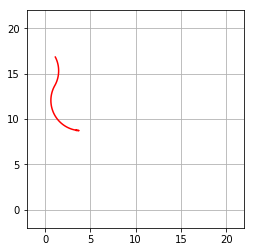

Paths planned: 597
Time taken: 107.307586s


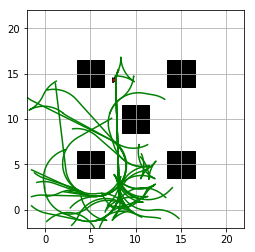

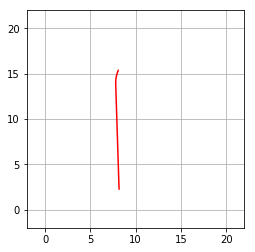

Paths planned: 598
Time taken: 106.492488s


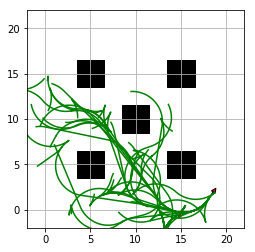

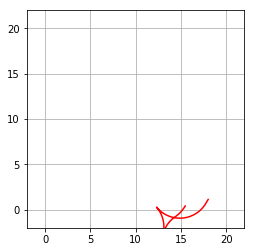

Paths planned: 599
Time taken: 117.536495s
Planning failed
Time taken: 0.001371s
Planning failed
Time taken: 0.001075s


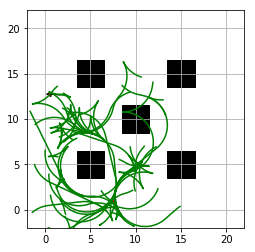

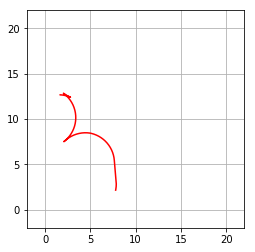

Paths planned: 600
Time taken: 110.246571s
Planning failed
Time taken: 0.000524s
Planning failed
Time taken: 0.000544s
Planning failed
Time taken: 0.000445s
Planning failed
Time taken: 0.000785s
Planning failed
Time taken: 0.000717s
Planning failed
Time taken: 0.000269s
Planning failed
Time taken: 0.000572s
Planning failed
Time taken: 0.000377s
Planning failed
Time taken: 81.887690s
Planning failed
Time taken: 61.981256s


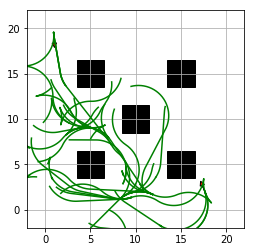

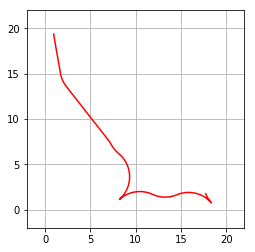

Paths planned: 601
Time taken: 101.686566s
Planning failed
Time taken: 62.867663s
Planning failed
Time taken: 0.001026s
Planning failed
Time taken: 0.000376s


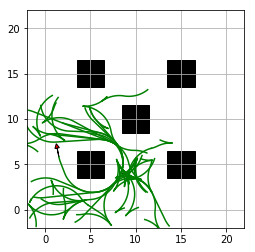

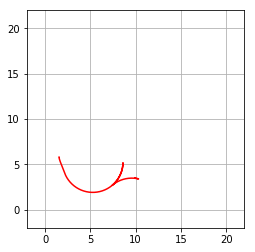

Paths planned: 602
Time taken: 85.717451s
Planning failed
Time taken: 0.000613s
Planning failed
Time taken: 0.000434s
Planning failed
Time taken: 0.000663s
Planning failed
Time taken: 0.000325s
Planning failed
Time taken: 0.000946s
Planning failed
Time taken: 0.001058s
Planning failed
Time taken: 0.000971s
Planning failed
Time taken: 0.000591s


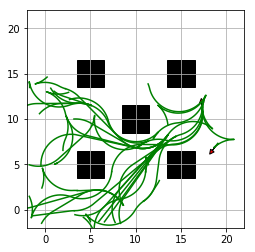

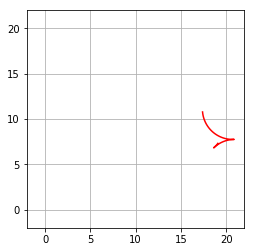

Paths planned: 603
Time taken: 73.894487s
Planning failed
Time taken: 74.659049s


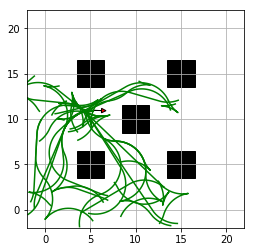

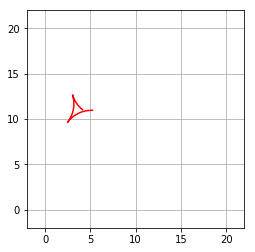

Paths planned: 604
Time taken: 88.977145s
Planning failed
Time taken: 0.000887s
Planning failed
Time taken: 0.000438s
Planning failed
Time taken: 0.000617s


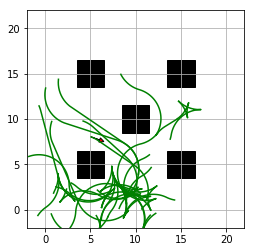

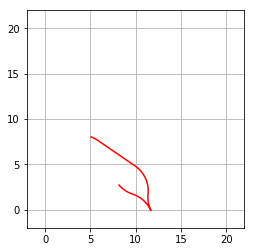

Paths planned: 605
Time taken: 66.853471s
Planning failed
Time taken: 61.340325s
Planning failed
Time taken: 0.000997s


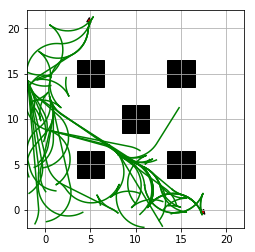

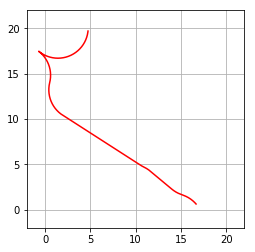

Paths planned: 606
Time taken: 102.237038s
Planning failed
Time taken: 87.675204s
Planning failed
Time taken: 0.001223s
Planning failed
Time taken: 0.000291s
Planning failed
Time taken: 0.000681s
Planning failed
Time taken: 0.001091s
Planning failed
Time taken: 0.000945s


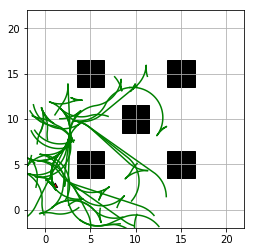

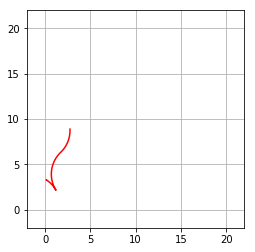

Paths planned: 607
Time taken: 137.189608s
Planning failed
Time taken: 0.001188s


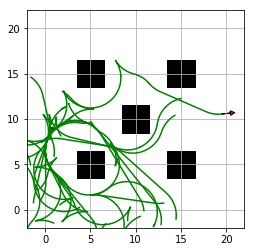

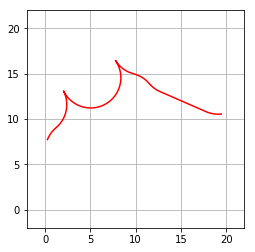

Paths planned: 608
Time taken: 76.670357s


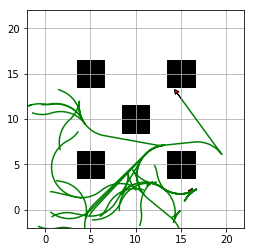

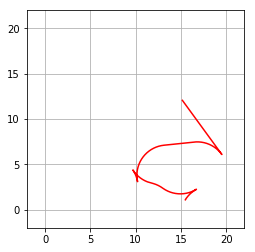

Paths planned: 609
Time taken: 52.599795s


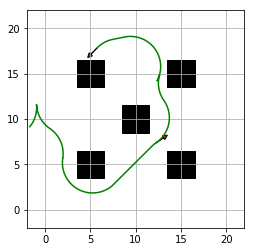

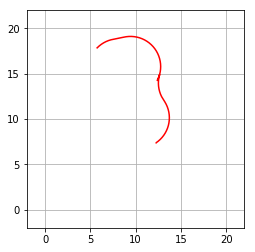

Paths planned: 610
Time taken: 3.552017s
Planning failed
Time taken: 0.000340s
Planning failed
Time taken: 0.000908s
Planning failed
Time taken: 58.282613s


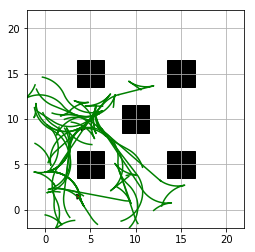

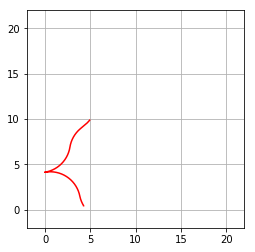

Paths planned: 611
Time taken: 107.638386s
Planning failed
Time taken: 0.000499s
Planning failed
Time taken: 0.000420s
Planning failed
Time taken: 0.000680s
Planning failed
Time taken: 0.000327s
Planning failed
Time taken: 0.000196s


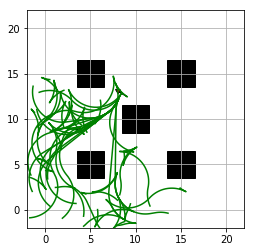

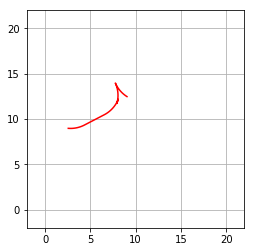

Paths planned: 612
Time taken: 89.562342s
Planning failed
Time taken: 0.000589s


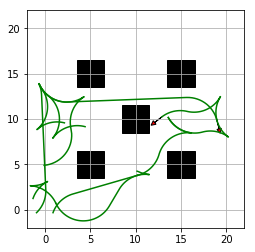

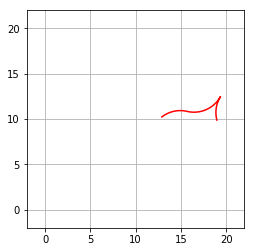

Paths planned: 613
Time taken: 8.657083s
Planning failed
Time taken: 0.000817s
Planning failed
Time taken: 100.085314s
Planning failed
Time taken: 0.000620s
Planning failed
Time taken: 3.651841s
Planning failed
Time taken: 0.000893s
Planning failed
Time taken: 0.000351s
Planning failed
Time taken: 0.000893s
Planning failed
Time taken: 43.546765s
Planning failed
Time taken: 0.000866s


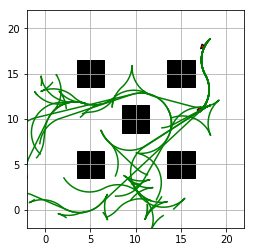

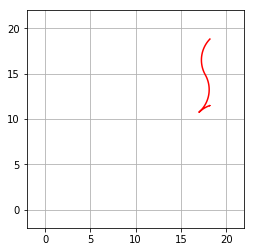

Paths planned: 614
Time taken: 104.411913s
Planning failed
Time taken: 0.001026s
Planning failed
Time taken: 0.000832s
Planning failed
Time taken: 0.000941s


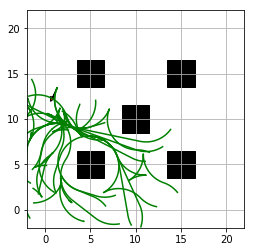

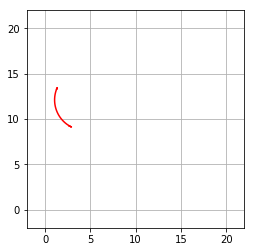

Paths planned: 615
Time taken: 87.869803s


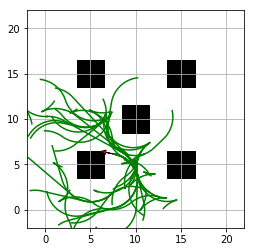

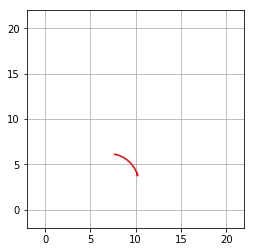

Paths planned: 616
Time taken: 102.106015s
Planning failed
Time taken: 0.000827s
mincost is inf


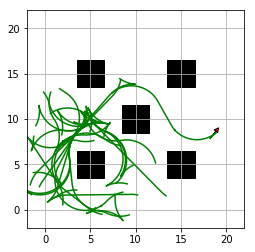

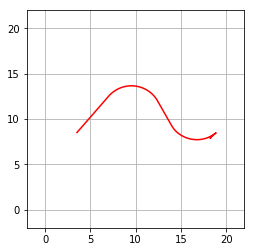

Paths planned: 617
Time taken: 67.874409s


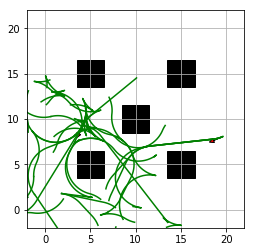

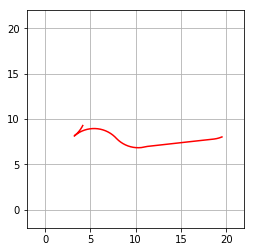

Paths planned: 618
Time taken: 66.274594s
Planning failed
Time taken: 0.000577s


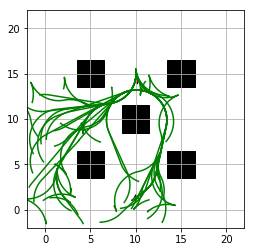

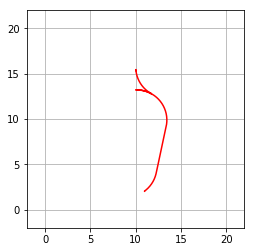

Paths planned: 619
Time taken: 112.845870s


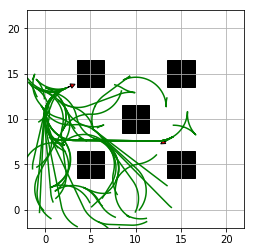

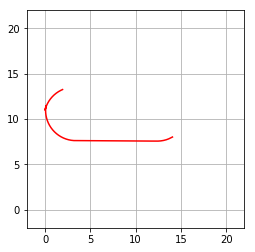

Paths planned: 620
Time taken: 119.742371s


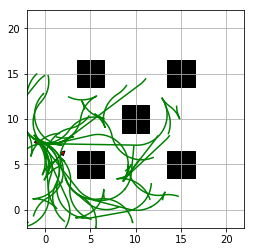

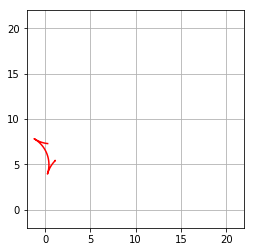

Paths planned: 621
Time taken: 88.110600s
Planning failed
Time taken: 0.000699s


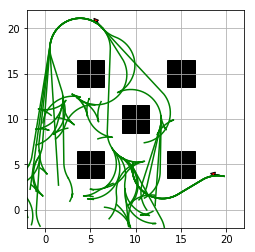

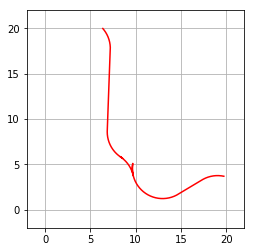

Paths planned: 622
Time taken: 102.848700s


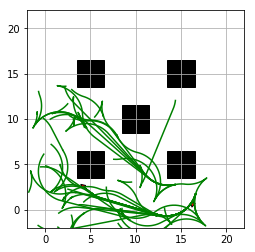

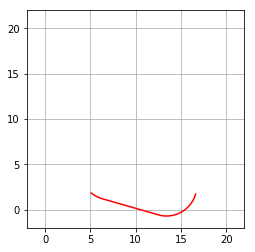

Paths planned: 623
Time taken: 109.307006s
Planning failed
Time taken: 113.835890s
Planning failed
Time taken: 0.000476s
mincost is inf


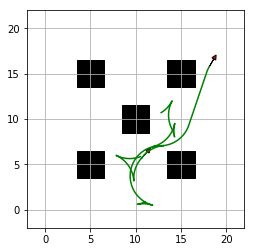

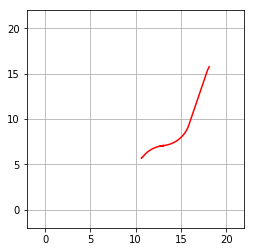

Paths planned: 624
Time taken: 7.739059s
Planning failed
Time taken: 0.000302s
Planning failed
Time taken: 0.000860s
Planning failed
Time taken: 0.000865s
Planning failed
Time taken: 77.284815s


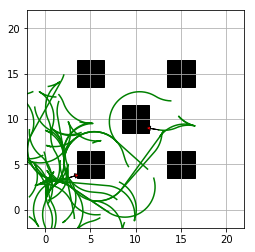

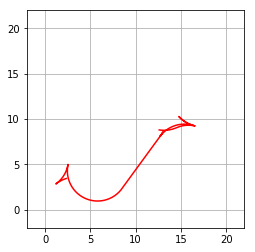

Paths planned: 625
Time taken: 83.827986s
Planning failed
Time taken: 0.000789s


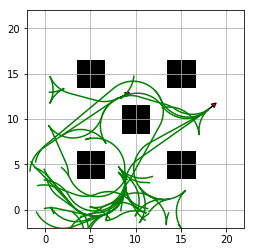

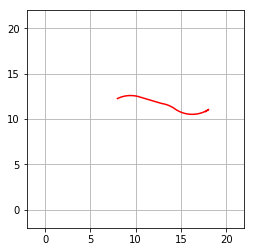

Paths planned: 626
Time taken: 85.631251s


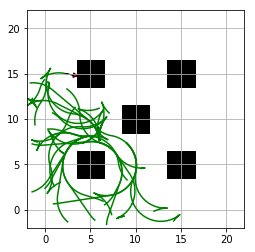

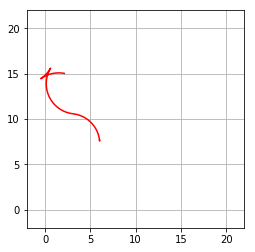

Paths planned: 627
Time taken: 71.149222s


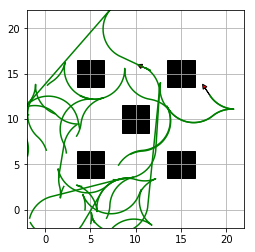

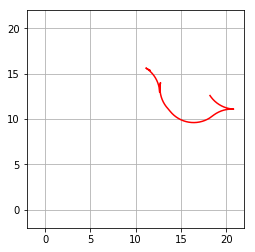

Paths planned: 628
Time taken: 36.978233s
Planning failed
Time taken: 0.000710s
Planning failed
Time taken: 0.000367s
Planning failed
Time taken: 0.001013s
Planning failed
Time taken: 0.000270s
Planning failed
Time taken: 0.000563s
Planning failed
Time taken: 0.001127s


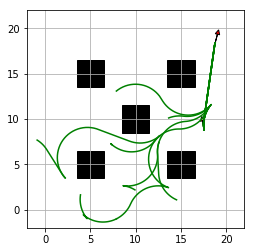

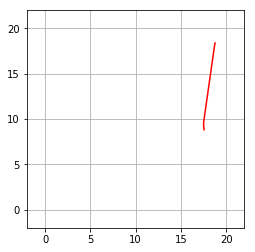

Paths planned: 629
Time taken: 24.945726s
Planning failed
Time taken: 0.001098s
Planning failed
Time taken: 0.000205s


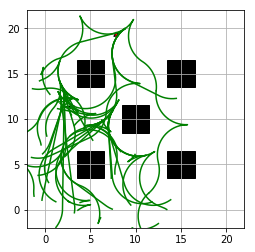

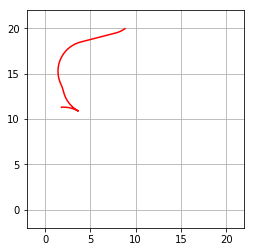

Paths planned: 630
Time taken: 93.996440s
Planning failed
Time taken: 3.897086s
Planning failed
Time taken: 66.505926s
Planning failed
Time taken: 4.266796s


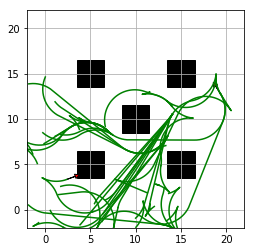

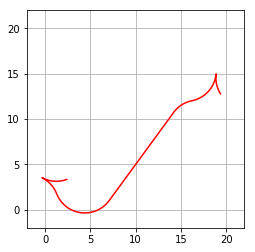

Paths planned: 631
Time taken: 69.576638s


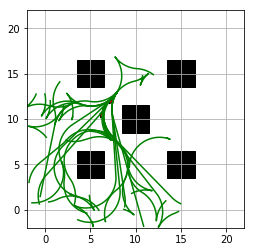

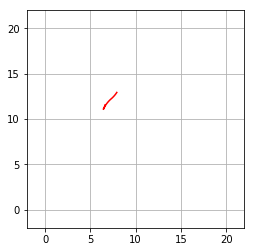

Paths planned: 632
Time taken: 107.731668s


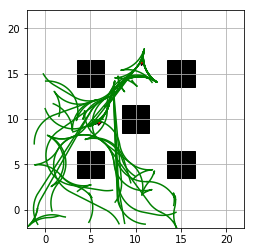

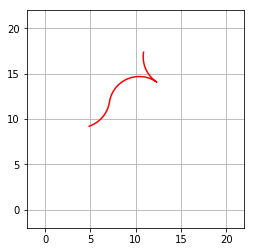

Paths planned: 633
Time taken: 115.014752s


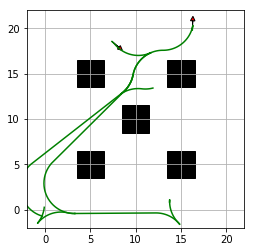

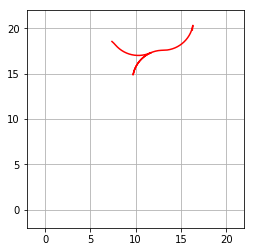

Paths planned: 634
Time taken: 7.745395s


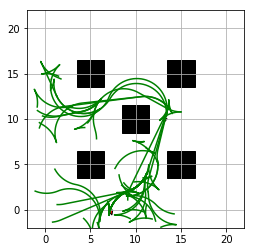

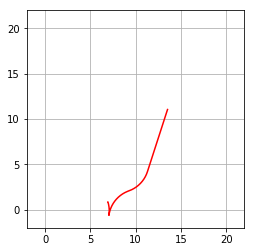

Paths planned: 635
Time taken: 96.671675s
Planning failed
Time taken: 85.786222s
Planning failed
Time taken: 0.001208s
Planning failed
Time taken: 0.001059s
Planning failed
Time taken: 84.821484s


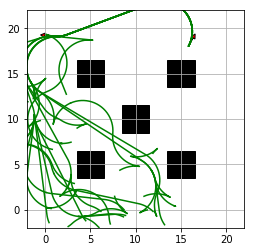

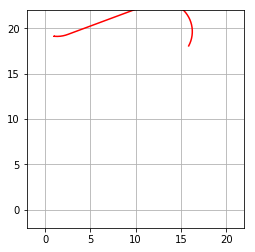

Paths planned: 636
Time taken: 88.096747s
Planning failed
Time taken: 0.001025s


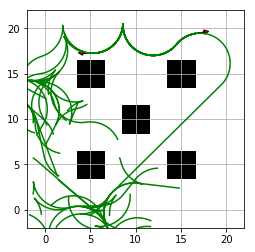

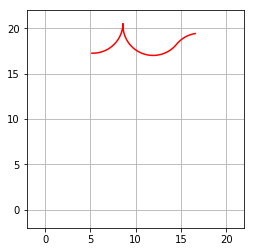

Paths planned: 637
Time taken: 95.554836s


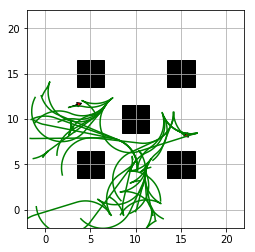

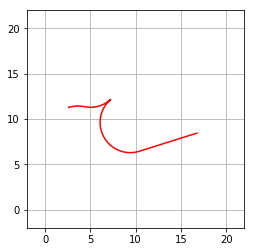

Paths planned: 638
Time taken: 74.260300s
Planning failed
Time taken: 0.001232s
Planning failed
Time taken: 0.000532s


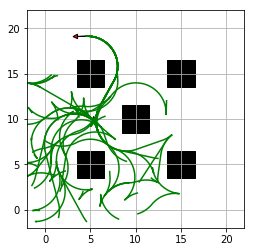

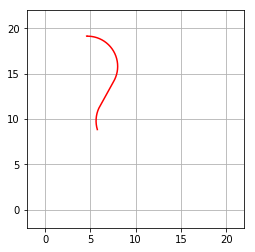

Paths planned: 639
Time taken: 143.216389s
Planning failed
Time taken: 0.000832s
Planning failed
Time taken: 0.000458s


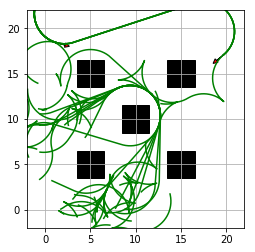

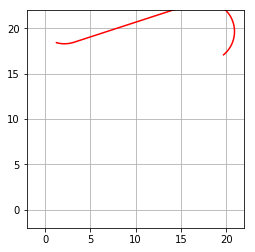

Paths planned: 640
Time taken: 105.987497s
Planning failed
Time taken: 0.000935s
Planning failed
Time taken: 56.784334s
Planning failed
Time taken: 0.001115s


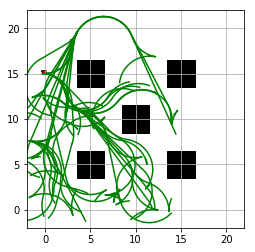

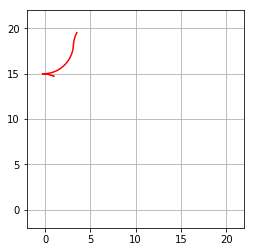

Paths planned: 641
Time taken: 147.068325s
Planning failed
Time taken: 0.000846s
Planning failed
Time taken: 0.000673s


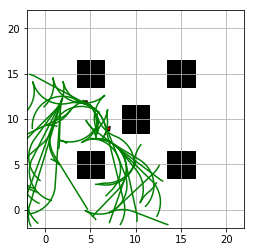

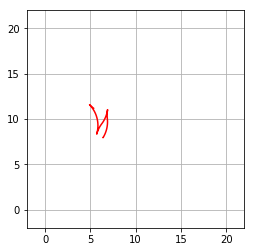

Paths planned: 642
Time taken: 70.645959s
Planning failed
Time taken: 0.001122s


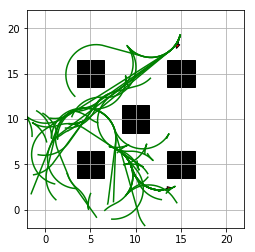

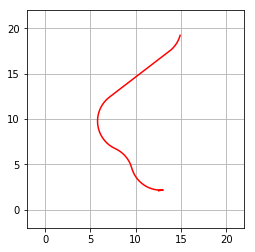

Paths planned: 643
Time taken: 96.930649s
Planning failed
Time taken: 0.001080s


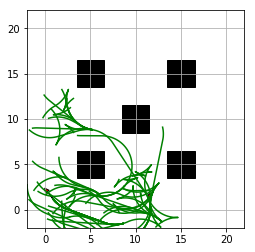

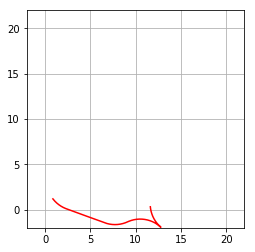

Paths planned: 644
Time taken: 162.081369s
Planning failed
Time taken: 0.000999s
Planning failed
Time taken: 0.000200s
Planning failed
Time taken: 155.331741s
Planning failed
Time taken: 0.000907s


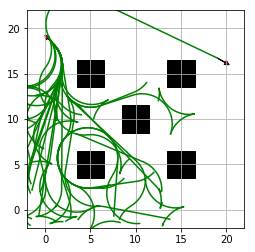

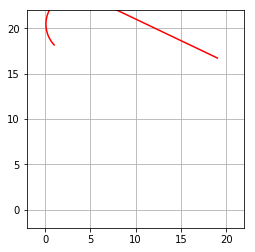

Paths planned: 645
Time taken: 111.399287s


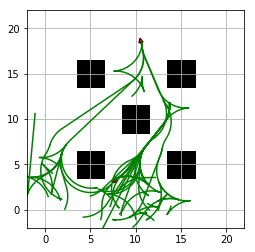

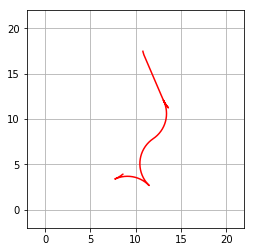

Paths planned: 646
Time taken: 99.666682s
Planning failed
Time taken: 0.001060s
Planning failed
Time taken: 0.000654s
Planning failed
Time taken: 77.304668s


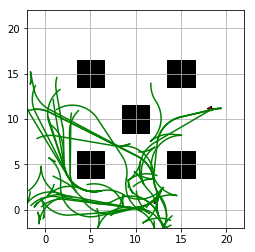

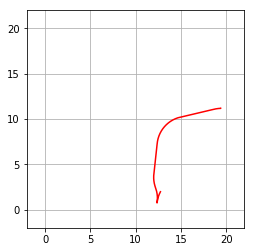

Paths planned: 647
Time taken: 128.992713s
Planning failed
Time taken: 93.415178s
Planning failed
Time taken: 0.001315s


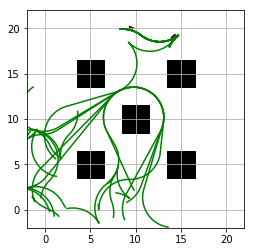

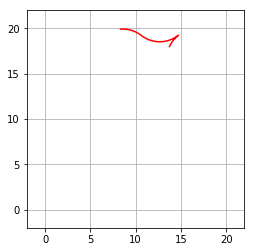

Paths planned: 648
Time taken: 47.891923s
Planning failed
Time taken: 0.000754s
Planning failed
Time taken: 0.000525s
Planning failed
Time taken: 30.043122s
Planning failed
Time taken: 0.001354s


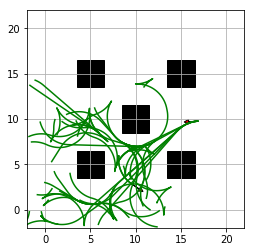

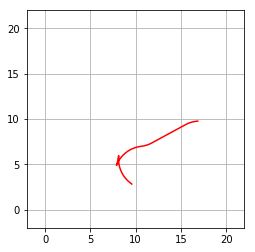

Paths planned: 649
Time taken: 90.603120s


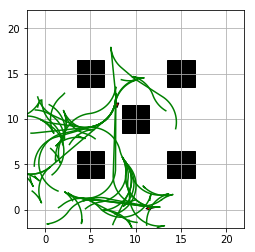

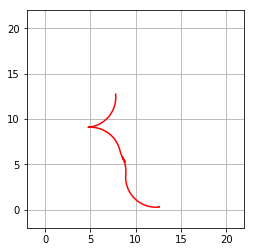

Paths planned: 650
Time taken: 99.033571s


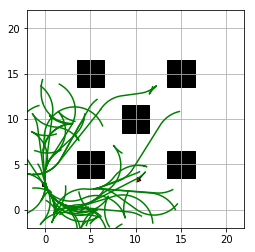

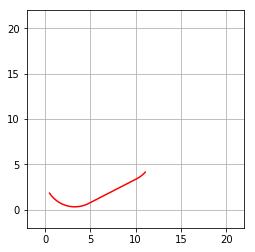

Paths planned: 651
Time taken: 115.801049s
Planning failed
Time taken: 0.001243s


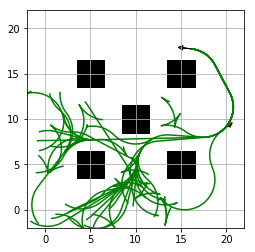

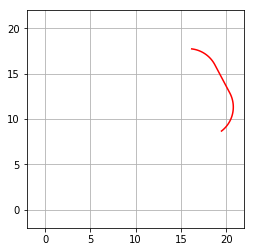

Paths planned: 652
Time taken: 109.365613s


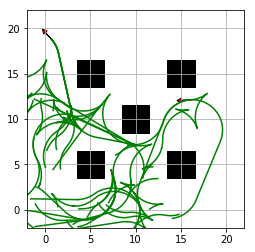

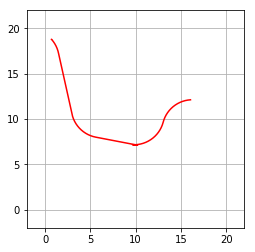

Paths planned: 653
Time taken: 109.007340s
Planning failed
Time taken: 7.635603s
Planning failed
Time taken: 0.000332s
Planning failed
Time taken: 0.000825s
Planning failed
Time taken: 0.000526s
Planning failed
Time taken: 0.000813s


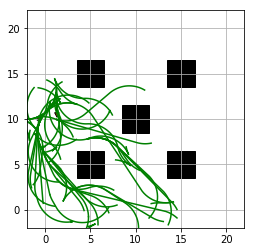

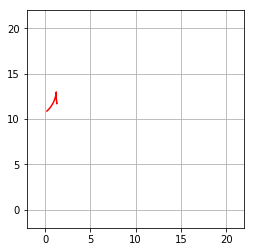

Paths planned: 654
Time taken: 107.605568s
Planning failed
Time taken: 0.001073s
Planning failed
Time taken: 0.001226s


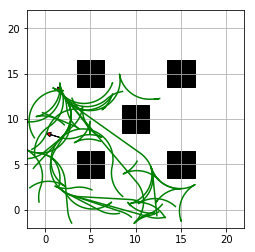

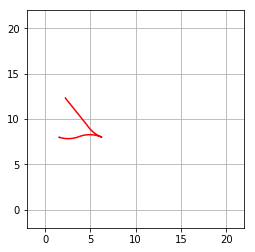

Paths planned: 655
Time taken: 78.831494s
Planning failed
Time taken: 0.001132s
Planning failed
Time taken: 0.000990s
Planning failed
Time taken: 0.000885s


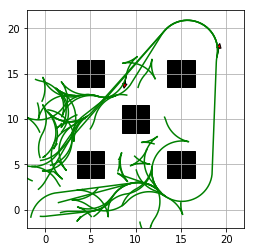

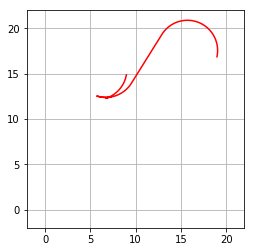

Paths planned: 656
Time taken: 101.805543s
Planning failed
Time taken: 0.001151s


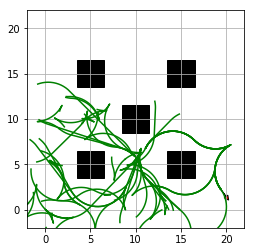

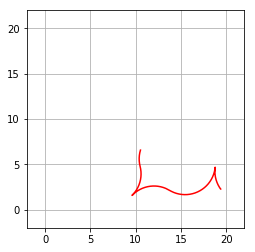

Paths planned: 657
Time taken: 103.027580s
Planning failed
Time taken: 0.000653s


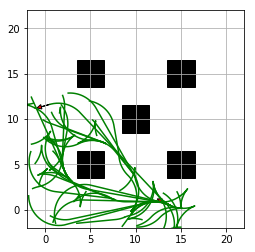

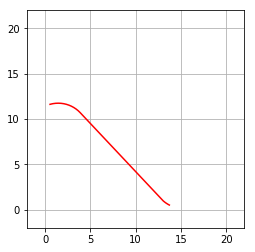

Paths planned: 658
Time taken: 90.467316s
Planning failed
Time taken: 0.000708s


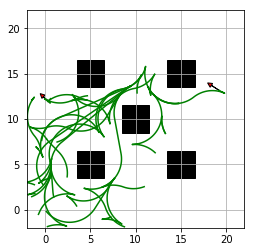

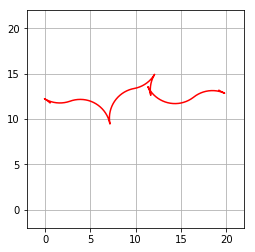

Paths planned: 659
Time taken: 49.674674s
Planning failed
Time taken: 0.000507s
Planning failed
Time taken: 0.000397s
Planning failed
Time taken: 0.000466s
Planning failed
Time taken: 88.638648s


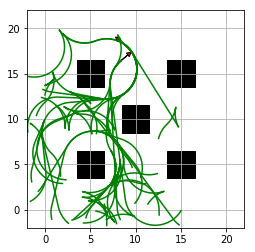

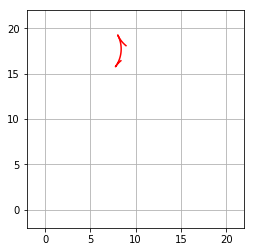

Paths planned: 660
Time taken: 100.081009s
Planning failed
Time taken: 0.001300s
Planning failed
Time taken: 45.911166s
Planning failed
Time taken: 0.001047s
Planning failed
Time taken: 0.000228s
Planning failed
Time taken: 0.000408s


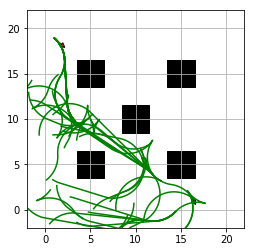

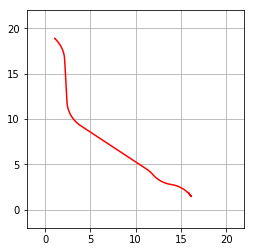

Paths planned: 661
Time taken: 107.378608s
Planning failed
Time taken: 0.000892s
mincost is inf
Planning failed
Time taken: 59.069660s
Planning failed
Time taken: 0.000675s
mincost is inf
Planning failed
Time taken: 66.373713s
Planning failed
Time taken: 0.000678s
Planning failed
Time taken: 0.000287s


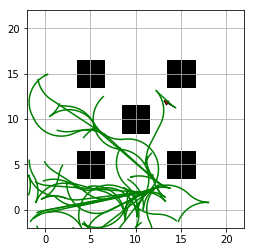

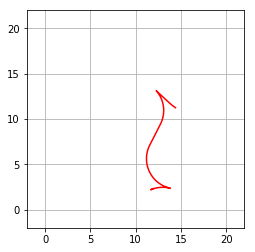

Paths planned: 662
Time taken: 98.240159s
Planning failed
Time taken: 4.326149s


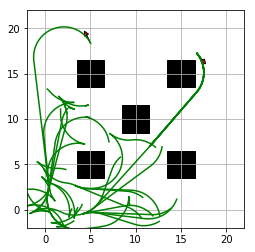

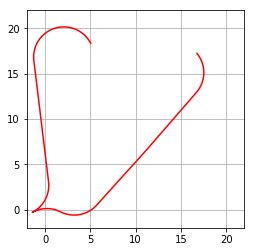

Paths planned: 663
Time taken: 67.048780s
Planning failed
Time taken: 0.000470s
Planning failed
Time taken: 0.000547s
Planning failed
Time taken: 0.000818s
mincost is inf
Planning failed
Time taken: 63.973588s
Planning failed
Time taken: 0.000573s
Planning failed
Time taken: 0.000203s
Planning failed
Time taken: 0.000936s


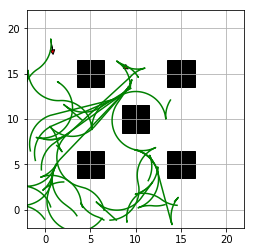

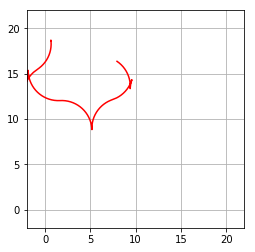

Paths planned: 664
Time taken: 56.112035s
Planning failed
Time taken: 0.001204s


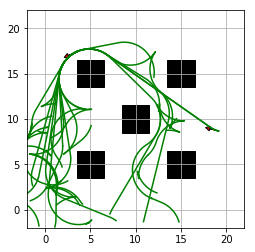

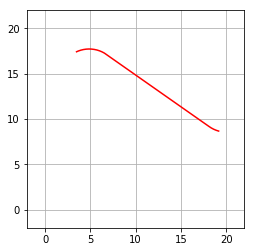

Paths planned: 665
Time taken: 68.597708s
Planning failed
Time taken: 0.001072s


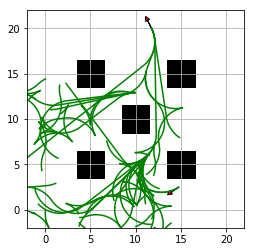

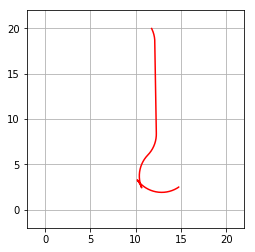

Paths planned: 666
Time taken: 96.851773s
Planning failed
Time taken: 0.000561s
Planning failed
Time taken: 0.000643s


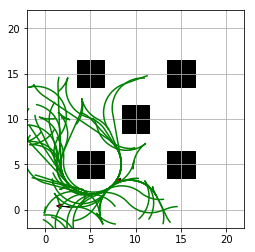

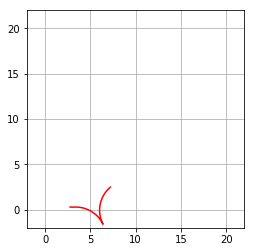

Paths planned: 667
Time taken: 124.008901s


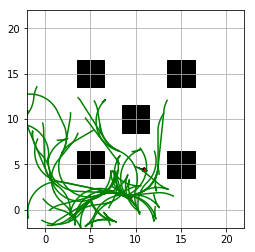

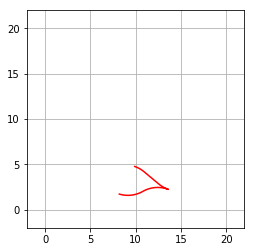

Paths planned: 668
Time taken: 121.895386s


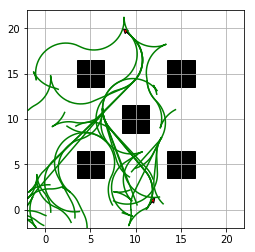

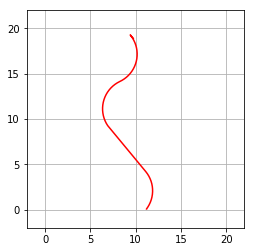

Paths planned: 669
Time taken: 71.784275s


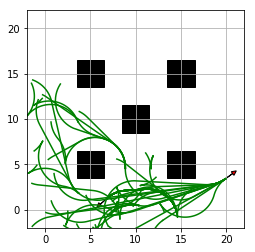

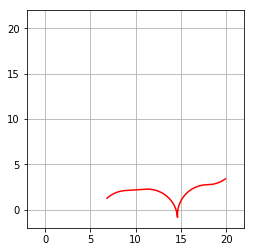

Paths planned: 670
Time taken: 124.740828s
Planning failed
Time taken: 0.001069s
Planning failed
Time taken: 0.000375s


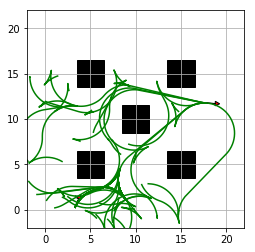

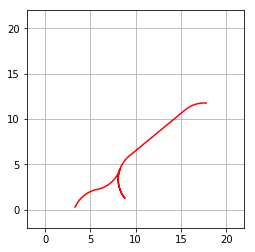

Paths planned: 671
Time taken: 148.302170s


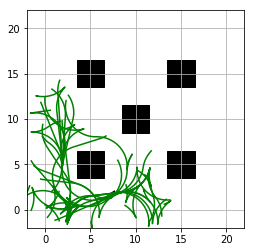

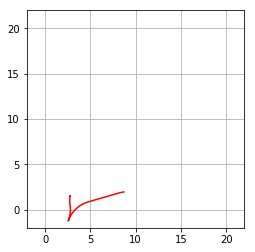

Paths planned: 672
Time taken: 125.322944s
Planning failed
Time taken: 107.928347s
Planning failed
Time taken: 0.000760s
Planning failed
Time taken: 0.000791s


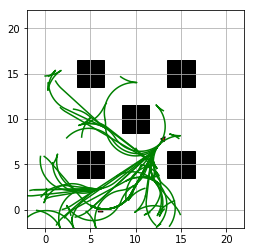

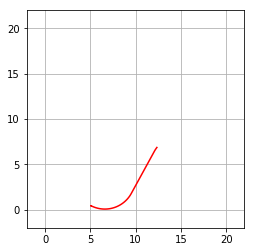

Paths planned: 673
Time taken: 184.440052s


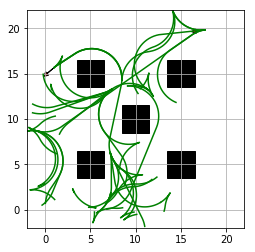

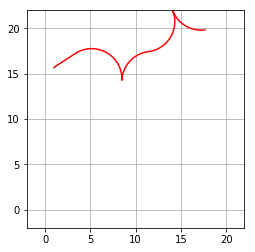

Paths planned: 674
Time taken: 64.173262s


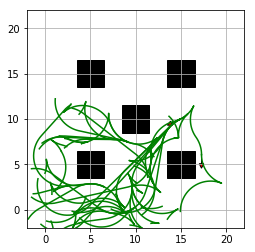

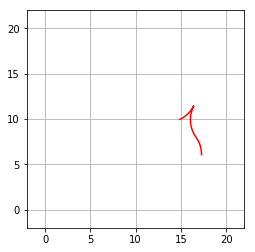

Paths planned: 675
Time taken: 96.211163s


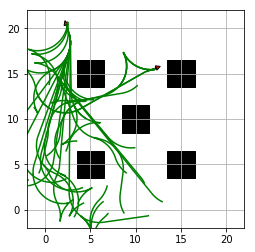

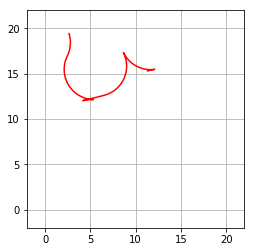

Paths planned: 676
Time taken: 78.973322s
Planning failed
Time taken: 0.001348s


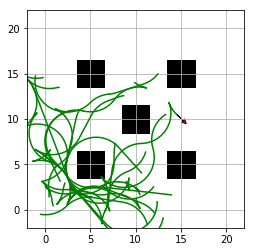

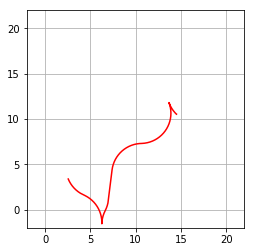

Paths planned: 677
Time taken: 74.376551s
Planning failed
Time taken: 0.001033s
Planning failed
Time taken: 100.957540s
Planning failed
Time taken: 0.001553s
Planning failed
Time taken: 0.000424s


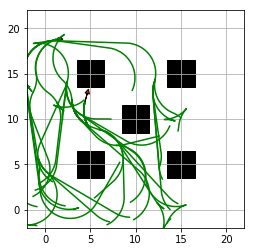

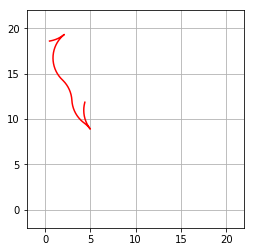

Paths planned: 678
Time taken: 94.742190s


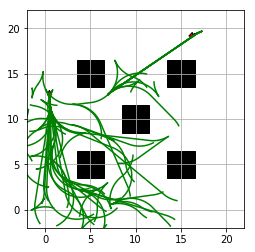

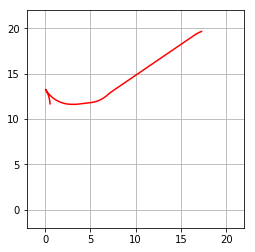

Paths planned: 679
Time taken: 126.888882s
Planning failed
Time taken: 0.001035s
Planning failed
Time taken: 28.691186s


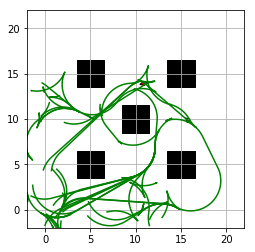

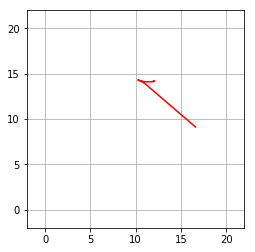

Paths planned: 680
Time taken: 101.395347s


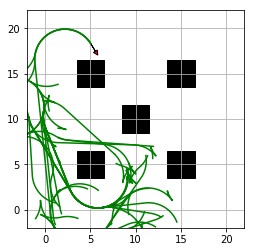

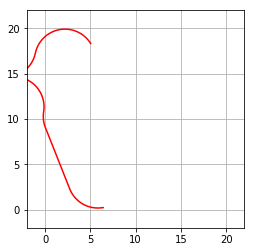

Paths planned: 681
Time taken: 102.760338s
Planning failed
Time taken: 0.000579s
Planning failed
Time taken: 0.000531s
Planning failed
Time taken: 0.000920s


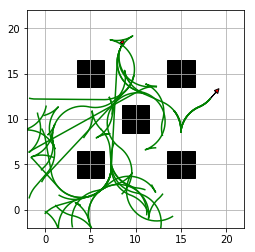

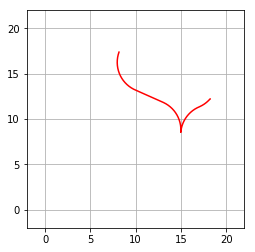

Paths planned: 682
Time taken: 74.457268s


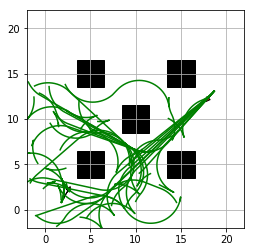

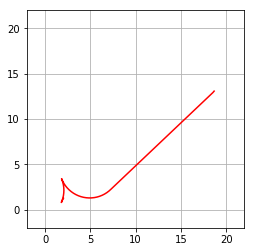

Paths planned: 683
Time taken: 107.845867s
Planning failed
Time taken: 0.000549s
Planning failed
Time taken: 0.000697s


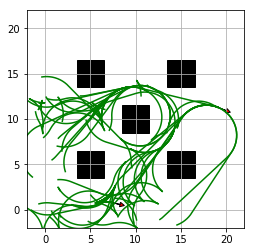

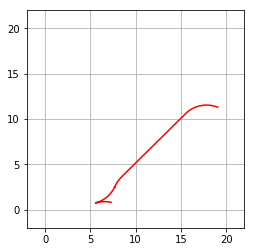

Paths planned: 684
Time taken: 138.911759s
Planning failed
Time taken: 28.994160s
Planning failed
Time taken: 0.000952s


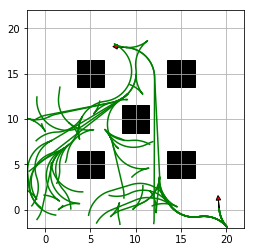

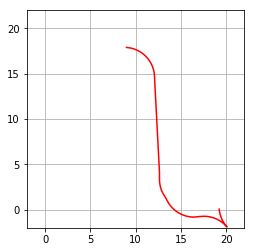

Paths planned: 685
Time taken: 95.847265s
Planning failed
Time taken: 83.379133s


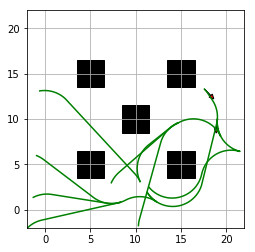

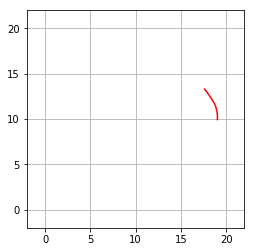

Paths planned: 686
Time taken: 10.888141s


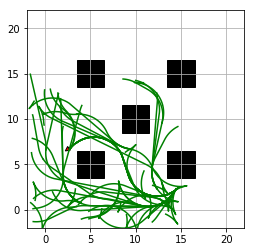

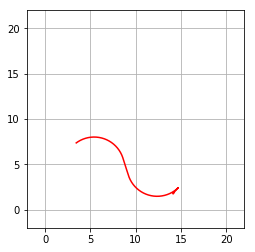

Paths planned: 687
Time taken: 157.705973s
Planning failed
Time taken: 0.000733s


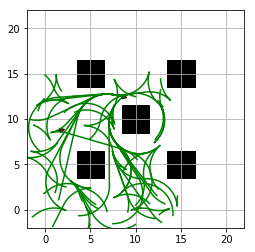

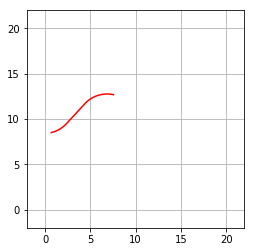

Paths planned: 688
Time taken: 118.106680s
Planning failed
Time taken: 114.461149s


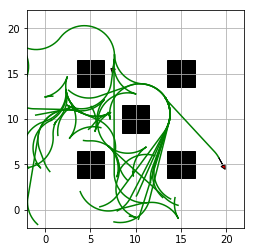

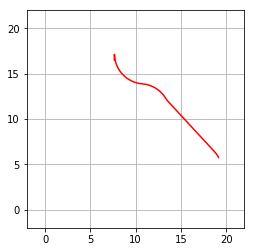

Paths planned: 689
Time taken: 67.421223s


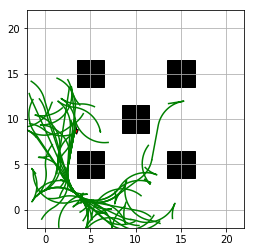

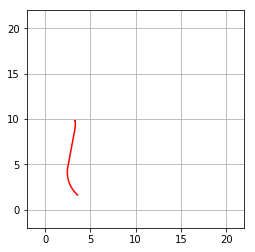

Paths planned: 690
Time taken: 130.584675s
Planning failed
Time taken: 0.001179s
Planning failed
Time taken: 0.000831s
Planning failed
Time taken: 0.000897s


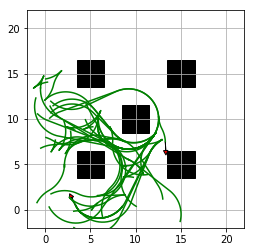

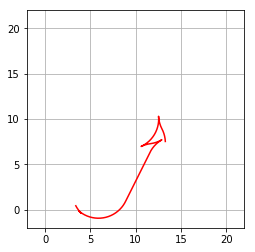

Paths planned: 691
Time taken: 81.719457s
Planning failed
Time taken: 0.000993s
Planning failed
Time taken: 0.000454s
Planning failed
Time taken: 0.000721s


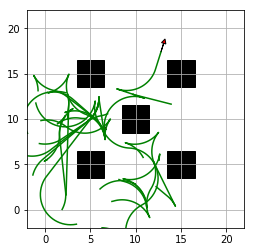

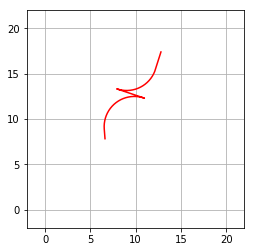

Paths planned: 692
Time taken: 49.738393s


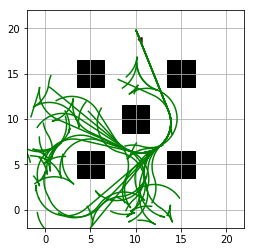

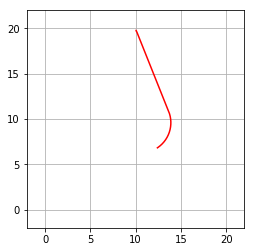

Paths planned: 693
Time taken: 157.118657s
Planning failed
Time taken: 0.000880s
Planning failed
Time taken: 0.000937s


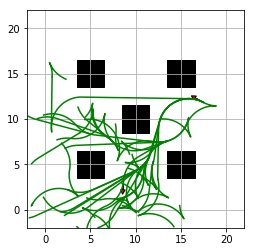

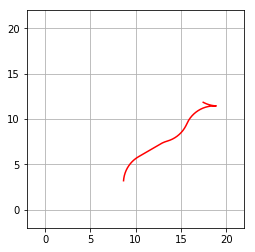

Paths planned: 694
Time taken: 85.846252s
Planning failed
Time taken: 0.000587s
Planning failed
Time taken: 0.000638s


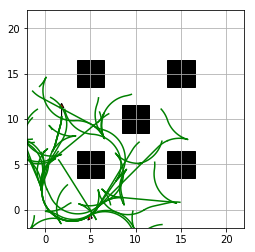

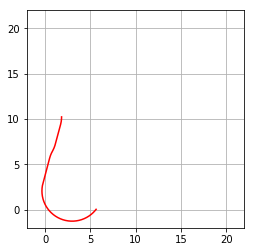

Paths planned: 695
Time taken: 81.597626s


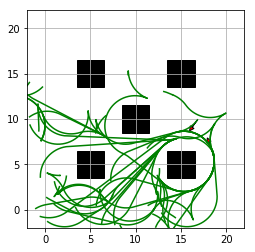

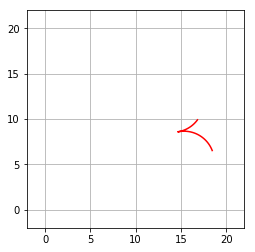

Paths planned: 696
Time taken: 88.880229s
Planning failed
Time taken: 0.000479s
Planning failed
Time taken: 144.093842s
Planning failed
Time taken: 0.000955s
Planning failed
Time taken: 0.000626s


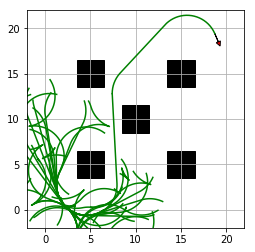

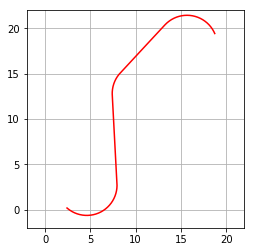

Paths planned: 697
Time taken: 84.320575s
Planning failed
Time taken: 0.001288s


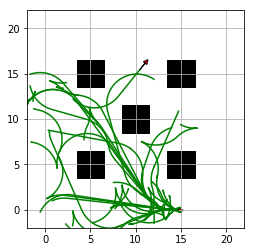

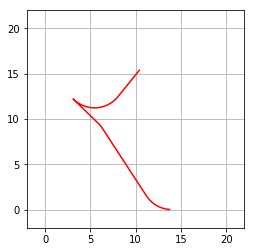

Paths planned: 698
Time taken: 85.826238s
Planning failed
Time taken: 0.000730s


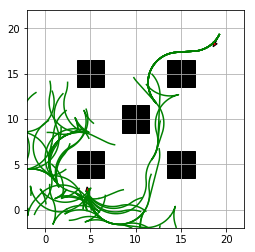

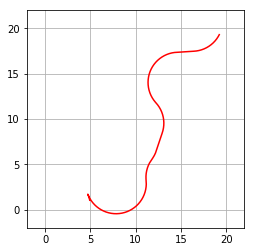

Paths planned: 699
Time taken: 110.274082s
Planning failed
Time taken: 0.001437s
Planning failed
Time taken: 0.000874s


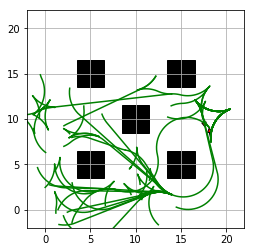

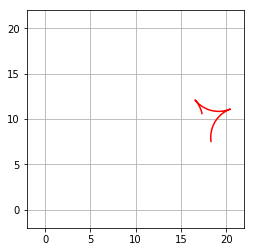

Paths planned: 700
Time taken: 134.581789s


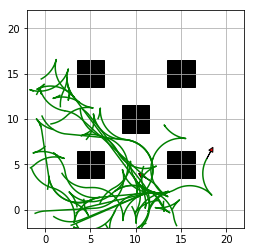

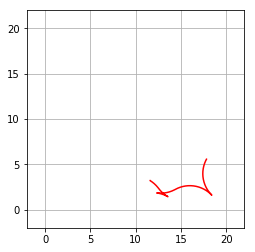

Paths planned: 701
Time taken: 99.547025s
Planning failed
Time taken: 0.001417s


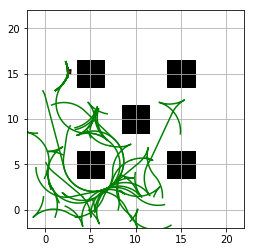

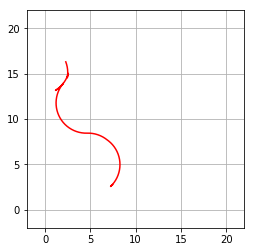

Paths planned: 702
Time taken: 105.336531s
Planning failed
Time taken: 102.033453s
Planning failed
Time taken: 0.001046s
Planning failed
Time taken: 0.001354s


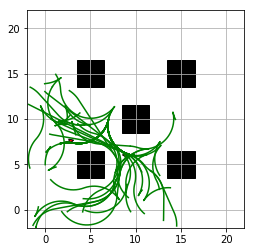

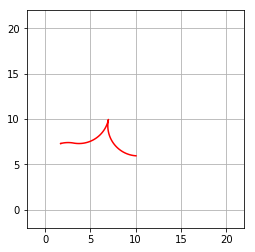

Paths planned: 703
Time taken: 119.318413s


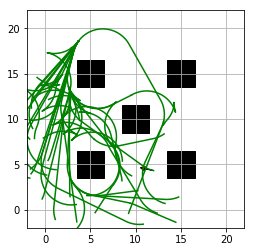

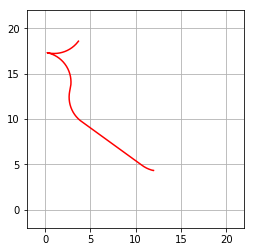

Paths planned: 704
Time taken: 105.007537s


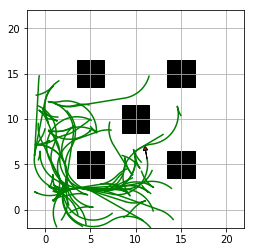

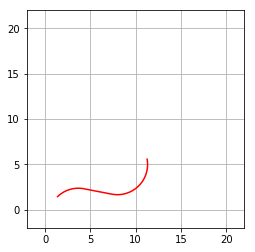

Paths planned: 705
Time taken: 136.315475s
mincost is inf


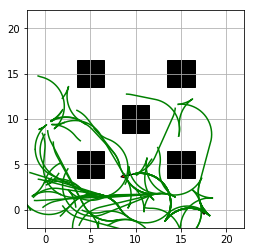

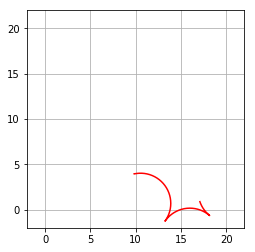

Paths planned: 706
Time taken: 117.965203s
Planning failed
Time taken: 0.001283s


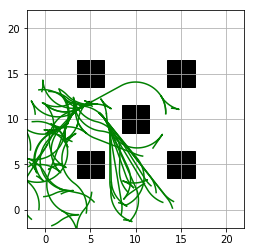

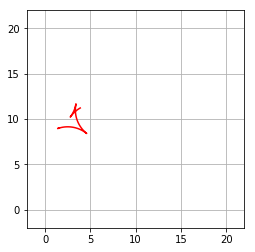

Paths planned: 707
Time taken: 130.042069s


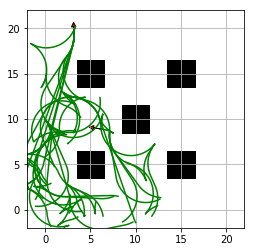

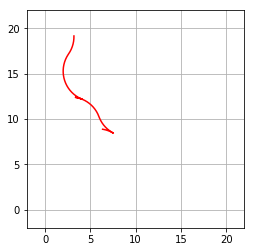

Paths planned: 708
Time taken: 103.138811s
Planning failed
Time taken: 90.194741s


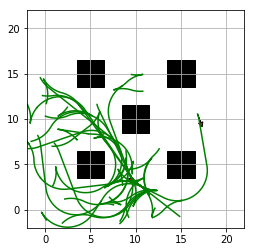

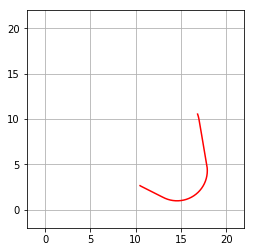

Paths planned: 709
Time taken: 82.761370s
Planning failed
Time taken: 0.001077s
Planning failed
Time taken: 0.001015s
Planning failed
Time taken: 104.995293s


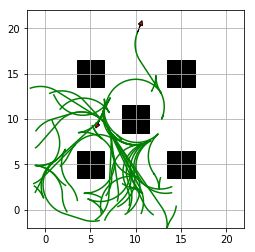

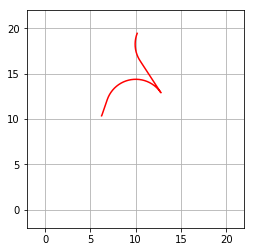

Paths planned: 710
Time taken: 74.264255s
Planning failed
Time taken: 0.000618s
Planning failed
Time taken: 0.000664s
Planning failed
Time taken: 0.000797s
Planning failed
Time taken: 0.000471s
mincost is inf


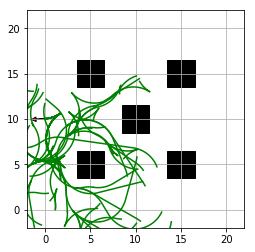

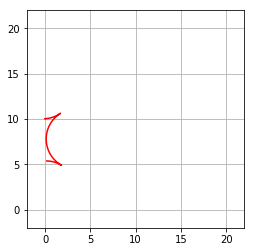

Paths planned: 711
Time taken: 138.053547s


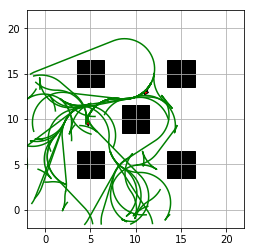

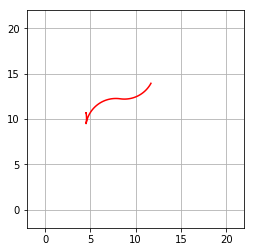

Paths planned: 712
Time taken: 136.965798s
Planning failed
Time taken: 0.001274s
Planning failed
Time taken: 103.473803s


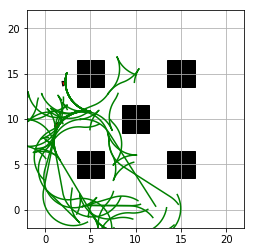

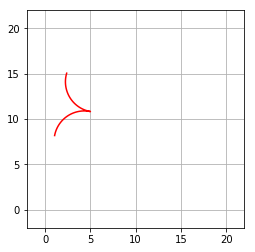

Paths planned: 713
Time taken: 118.237894s


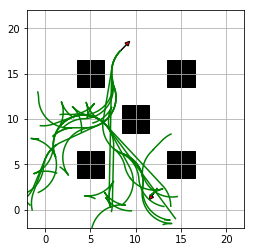

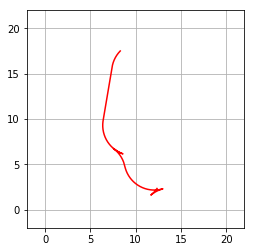

Paths planned: 714
Time taken: 52.114089s


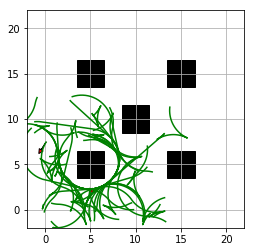

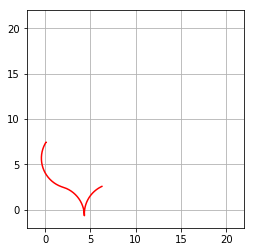

Paths planned: 715
Time taken: 157.122924s


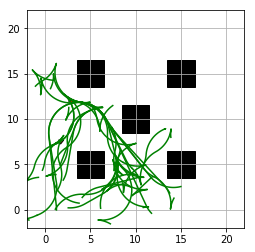

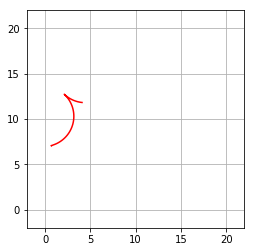

Paths planned: 716
Time taken: 79.667023s


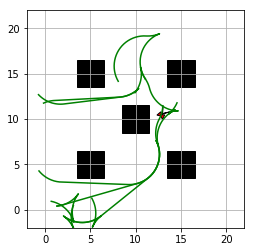

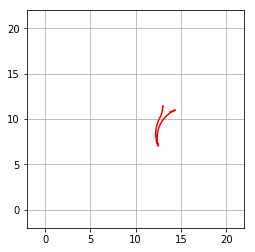

Paths planned: 717
Time taken: 13.329948s
mincost is inf


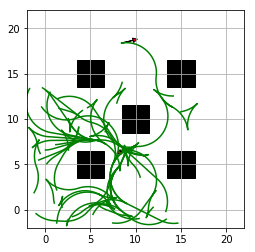

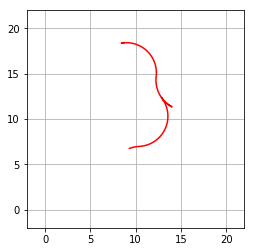

Paths planned: 718
Time taken: 106.025717s
Planning failed
Time taken: 0.000888s


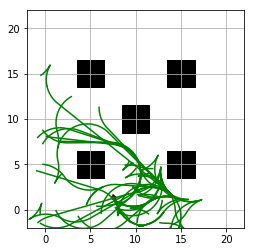

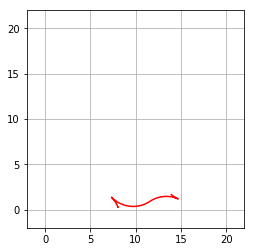

Paths planned: 719
Time taken: 107.764754s
Planning failed
Time taken: 0.000535s
Planning failed
Time taken: 0.000237s


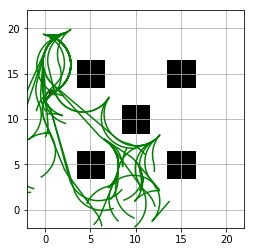

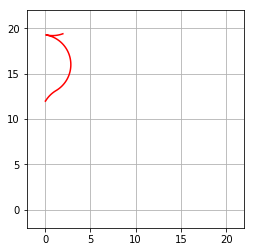

Paths planned: 720
Time taken: 96.545576s
Planning failed
Time taken: 0.000694s
Planning failed
Time taken: 0.000369s


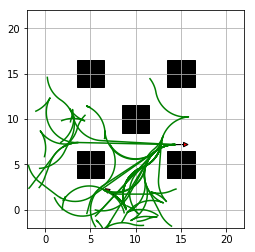

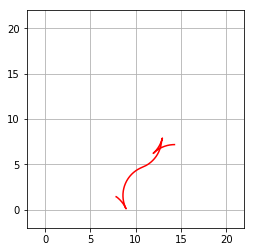

Paths planned: 721
Time taken: 86.456663s
Planning failed
Time taken: 0.000614s
Planning failed
Time taken: 0.000637s
Planning failed
Time taken: 0.000543s


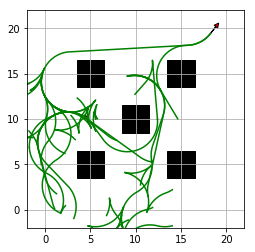

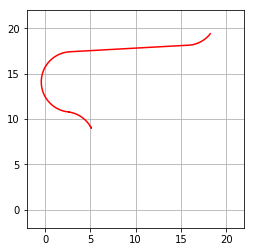

Paths planned: 722
Time taken: 49.245735s


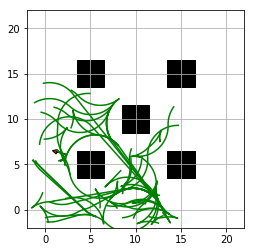

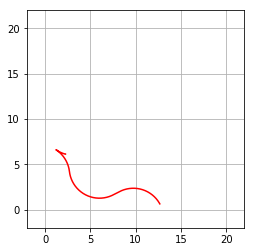

Paths planned: 723
Time taken: 99.866916s
Planning failed
Time taken: 0.000663s


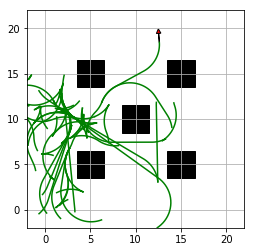

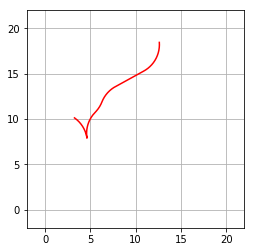

Paths planned: 724
Time taken: 73.768793s
Planning failed
Time taken: 0.001189s
Planning failed
Time taken: 0.001140s


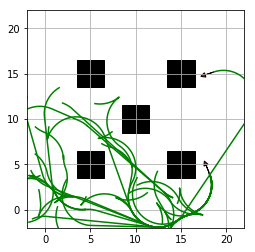

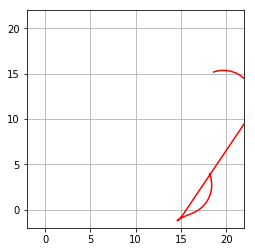

Paths planned: 725
Time taken: 81.133988s
Planning failed
Time taken: 0.000654s
Planning failed
Time taken: 0.000523s


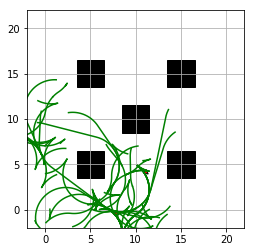

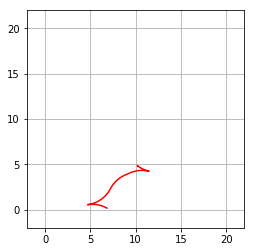

Paths planned: 726
Time taken: 92.646130s


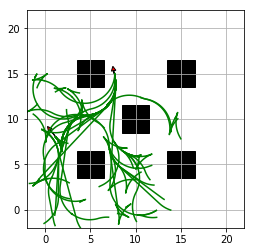

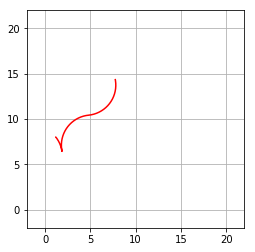

Paths planned: 727
Time taken: 125.259672s
Planning failed
Time taken: 0.000881s
Planning failed
Time taken: 0.000545s


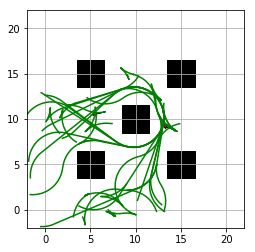

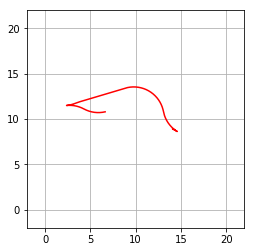

Paths planned: 728
Time taken: 59.112826s
Planning failed
Time taken: 0.000792s
Planning failed
Time taken: 0.000945s
Planning failed
Time taken: 112.816195s


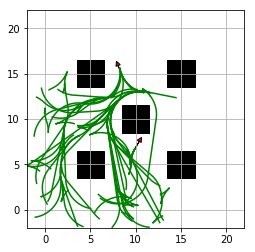

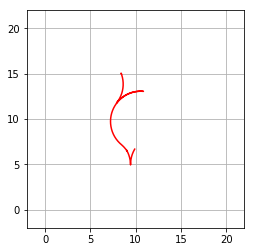

Paths planned: 729
Time taken: 150.101862s


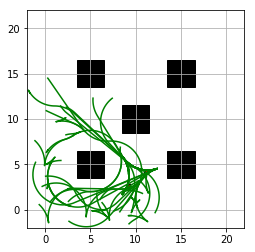

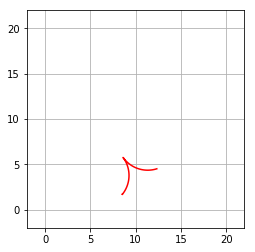

Paths planned: 730
Time taken: 152.422600s
Planning failed
Time taken: 0.000598s


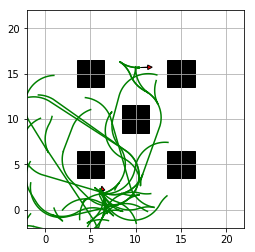

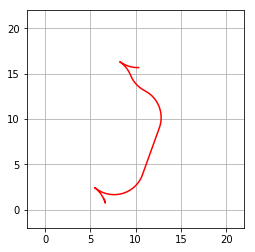

Paths planned: 731
Time taken: 68.053574s


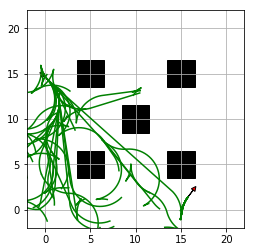

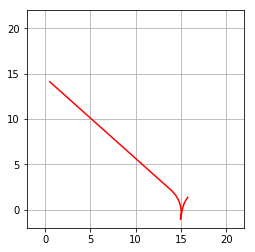

Paths planned: 732
Time taken: 131.508930s


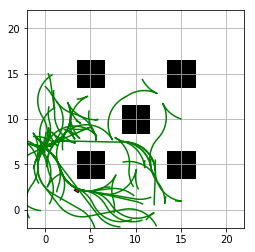

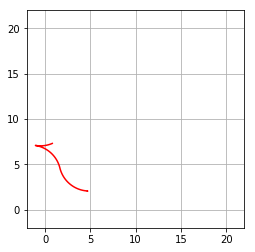

Paths planned: 733
Time taken: 162.506698s


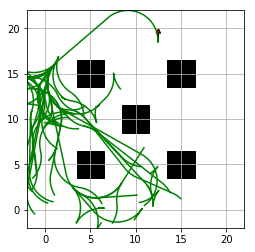

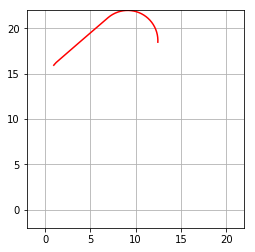

Paths planned: 734
Time taken: 78.895351s


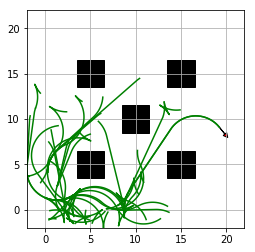

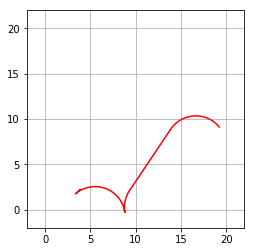

Paths planned: 735
Time taken: 83.913268s
Planning failed
Time taken: 5.298210s
Planning failed
Time taken: 0.000527s
Planning failed
Time taken: 0.000919s
Planning failed
Time taken: 83.014014s
Planning failed
Time taken: 0.001495s
Planning failed
Time taken: 83.117108s


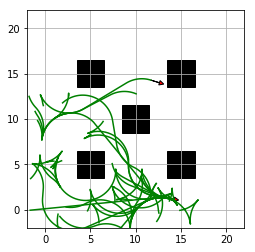

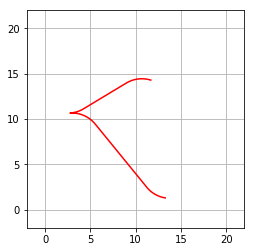

Paths planned: 736
Time taken: 60.083602s
Planning failed
Time taken: 0.001239s
Planning failed
Time taken: 0.000894s
Planning failed
Time taken: 0.000451s
Planning failed
Time taken: 0.000998s
Planning failed
Time taken: 0.000353s


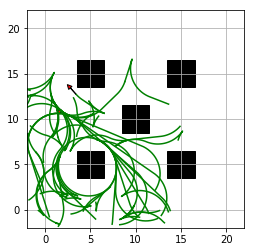

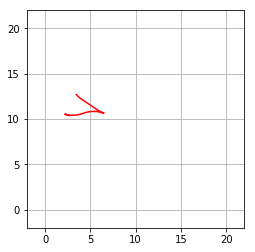

Paths planned: 737
Time taken: 111.543204s
Planning failed
Time taken: 88.147966s


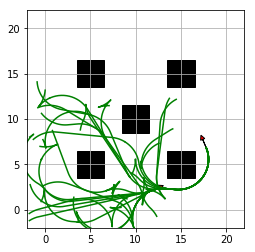

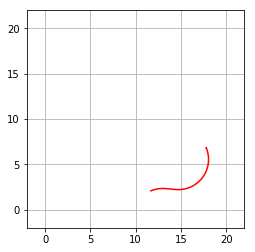

Paths planned: 738
Time taken: 570.053334s
Planning failed
Time taken: 0.000942s
Planning failed
Time taken: 0.000543s
Planning failed
Time taken: 0.000602s
Planning failed
Time taken: 0.000947s


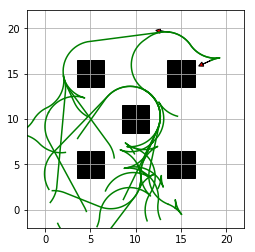

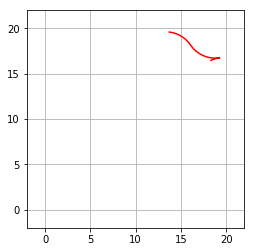

Paths planned: 739
Time taken: 37.518924s


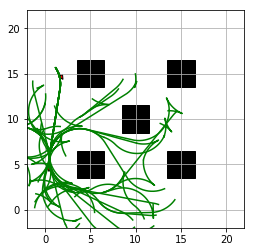

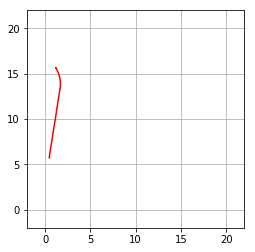

Paths planned: 740
Time taken: 151.997621s
Planning failed
Time taken: 0.000582s


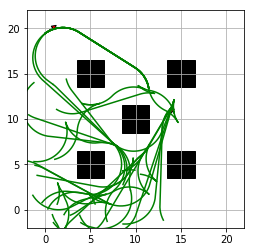

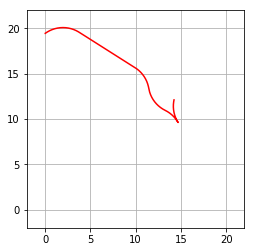

Paths planned: 741
Time taken: 84.966184s


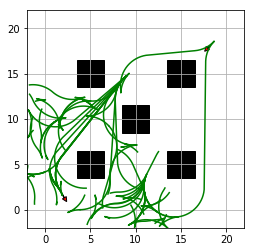

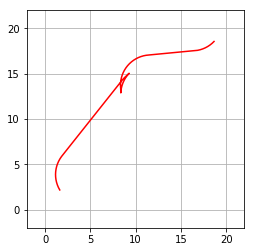

Paths planned: 742
Time taken: 144.853105s
Planning failed
Time taken: 0.000635s
mincost is inf


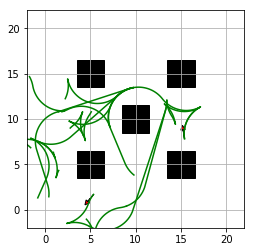

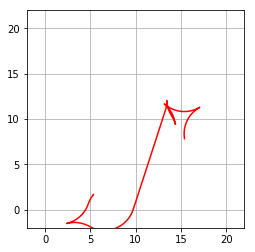

Paths planned: 743
Time taken: 18.860047s


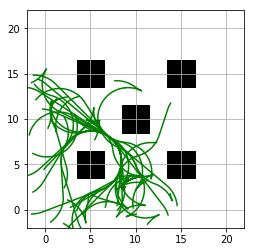

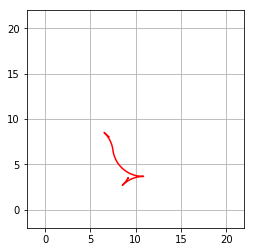

Paths planned: 744
Time taken: 144.055050s


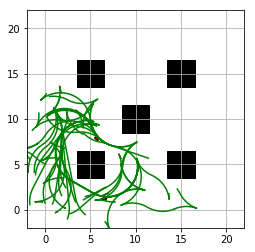

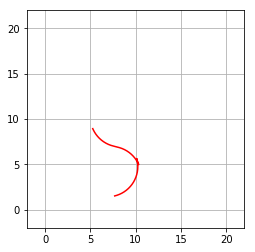

Paths planned: 745
Time taken: 124.283617s
Planning failed
Time taken: 0.001515s
Planning failed
Time taken: 0.000780s


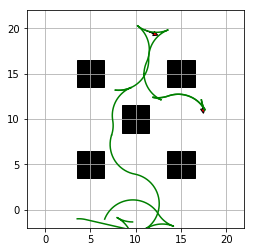

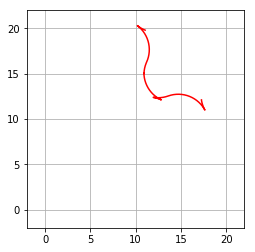

Paths planned: 746
Time taken: 7.683464s
Planning failed
Time taken: 0.001026s
Planning failed
Time taken: 0.001063s


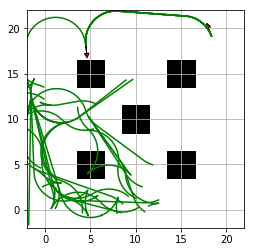

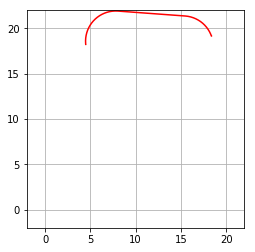

Paths planned: 747
Time taken: 64.015399s


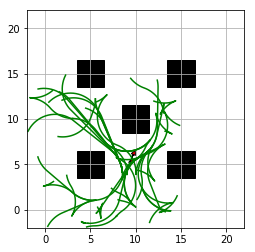

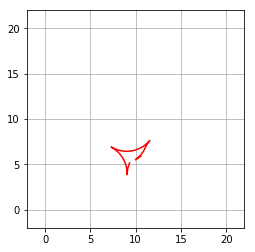

Paths planned: 748
Time taken: 65.878514s
Planning failed
Time taken: 91.705077s


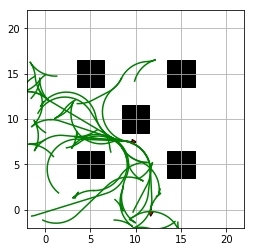

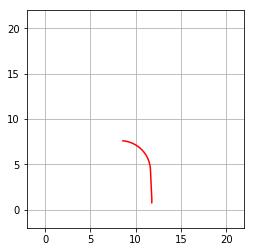

Paths planned: 749
Time taken: 56.008645s
Planning failed
Time taken: 113.037782s
Planning failed
Time taken: 0.001048s
Planning failed
Time taken: 0.000834s


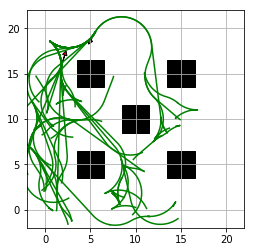

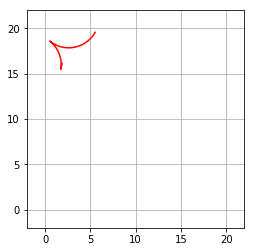

Paths planned: 750
Time taken: 188.058675s
Planning failed
Time taken: 0.000733s
Planning failed
Time taken: 0.000804s


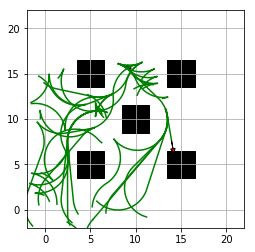

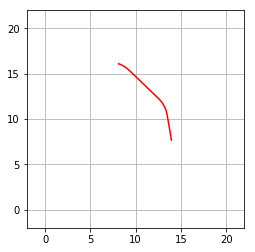

Paths planned: 751
Time taken: 54.390752s


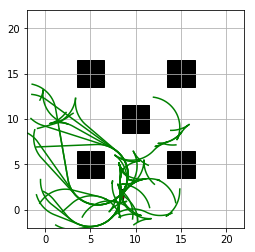

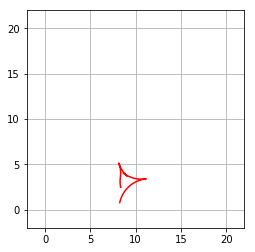

Paths planned: 752
Time taken: 92.337718s
Planning failed
Time taken: 0.001227s


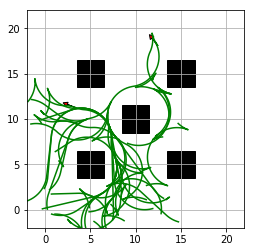

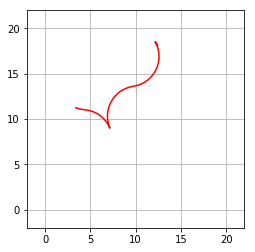

Paths planned: 753
Time taken: 99.486912s
Planning failed
Time taken: 0.001069s
Planning failed
Time taken: 0.000991s


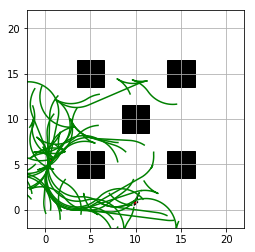

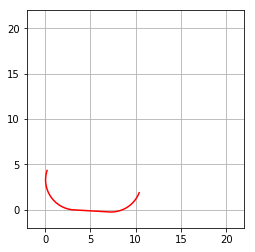

Paths planned: 754
Time taken: 90.480304s
Planning failed
Time taken: 0.000569s
Planning failed
Time taken: 77.018437s
Planning failed
Time taken: 0.000829s


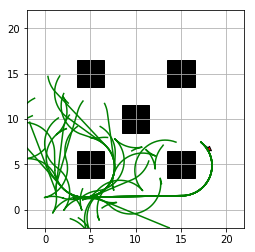

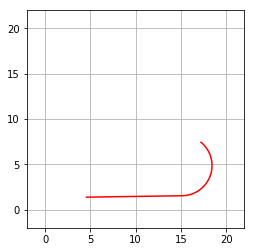

Paths planned: 755
Time taken: 75.595092s
Planning failed
Time taken: 0.000798s
Planning failed
Time taken: 64.002131s


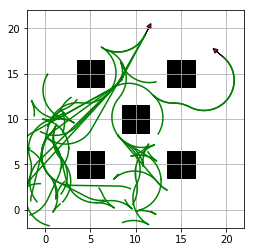

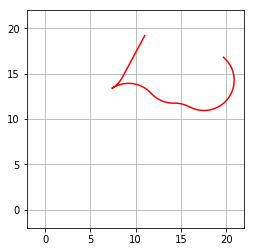

Paths planned: 756
Time taken: 70.656277s
Planning failed
Time taken: 0.000612s
Planning failed
Time taken: 36.312934s


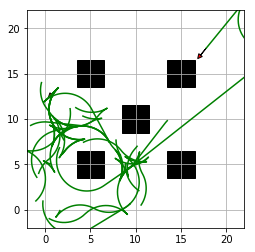

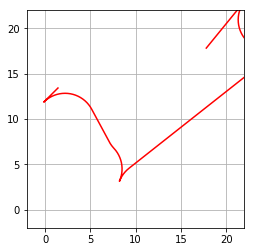

Paths planned: 757
Time taken: 50.842170s


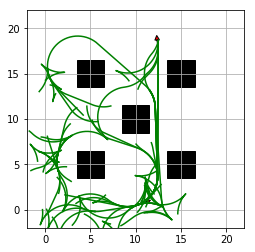

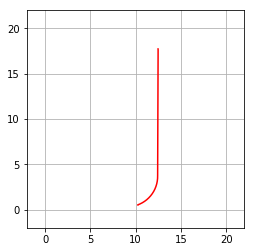

Paths planned: 758
Time taken: 132.463350s
Planning failed
Time taken: 0.001266s


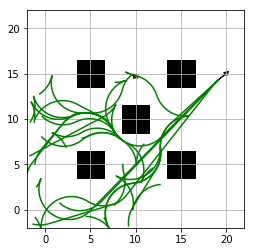

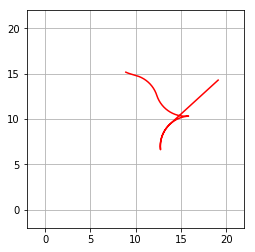

Paths planned: 759
Time taken: 52.837279s


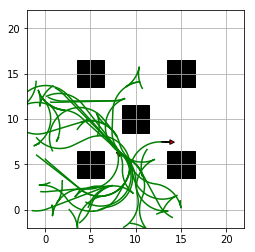

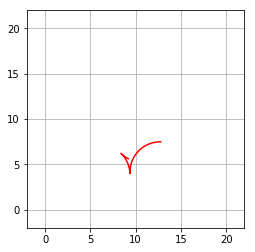

Paths planned: 760
Time taken: 81.271369s


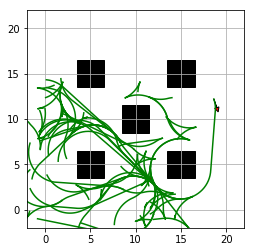

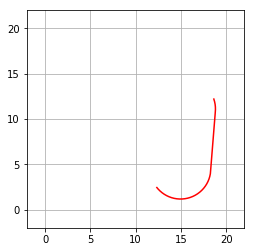

Paths planned: 761
Time taken: 126.278967s


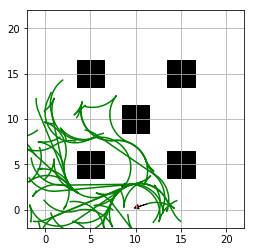

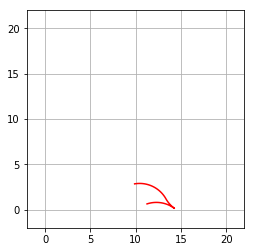

Paths planned: 762
Time taken: 77.509940s
Planning failed
Time taken: 31.171222s


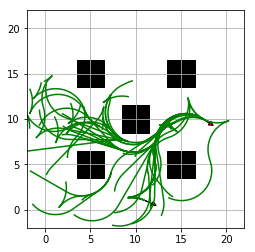

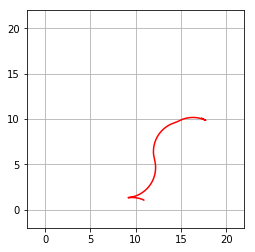

Paths planned: 763
Time taken: 101.487387s
Planning failed
Time taken: 0.001025s


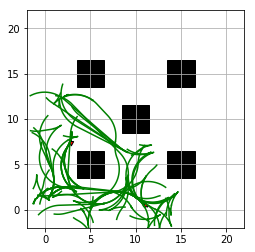

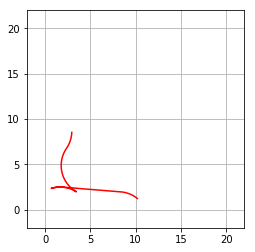

Paths planned: 764
Time taken: 136.172340s
Planning failed
Time taken: 0.000707s


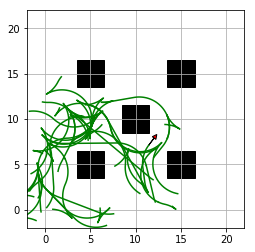

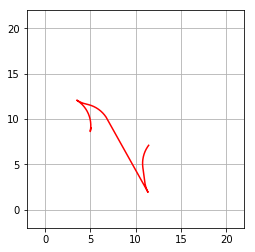

Paths planned: 765
Time taken: 70.198512s
Planning failed
Time taken: 0.000665s


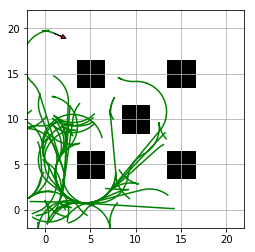

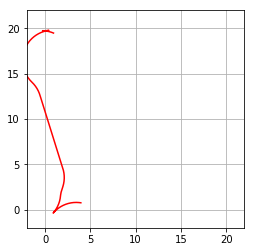

Paths planned: 766
Time taken: 104.495087s
Planning failed
Time taken: 69.742027s


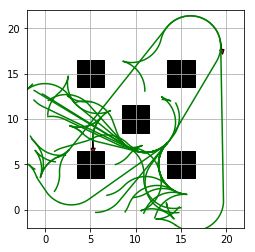

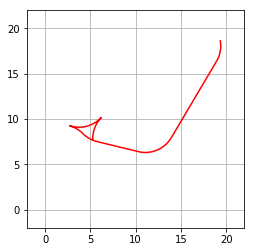

Paths planned: 767
Time taken: 61.843704s
Planning failed
Time taken: 0.001128s
Planning failed
Time taken: 0.001118s


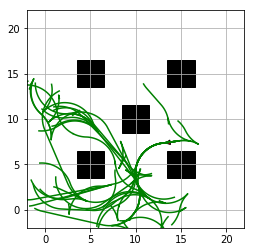

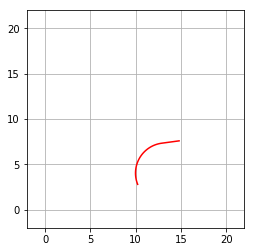

Paths planned: 768
Time taken: 126.885831s


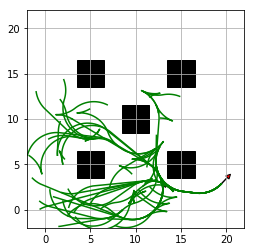

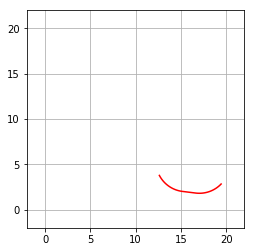

Paths planned: 769
Time taken: 134.385213s


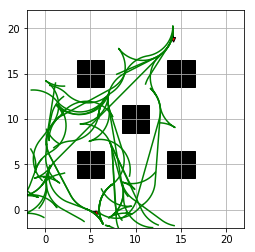

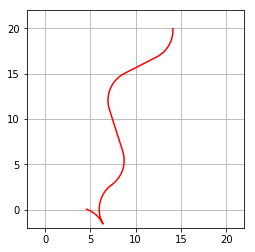

Paths planned: 770
Time taken: 112.633933s
Planning failed
Time taken: 0.001513s


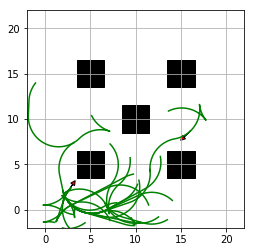

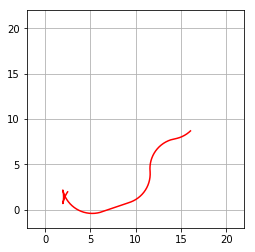

Paths planned: 771
Time taken: 34.945254s
Planning failed
Time taken: 0.000877s
Planning failed
Time taken: 57.687728s
Planning failed
Time taken: 0.000984s


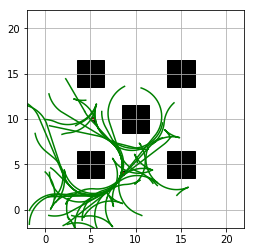

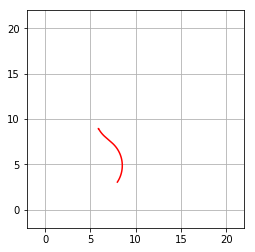

Paths planned: 772
Time taken: 96.195225s


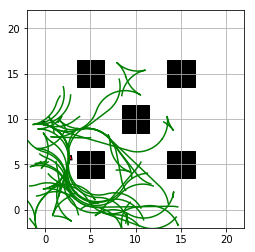

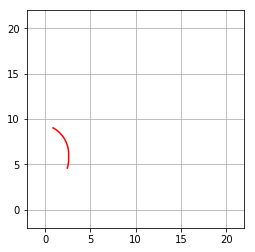

Paths planned: 773
Time taken: 127.777795s


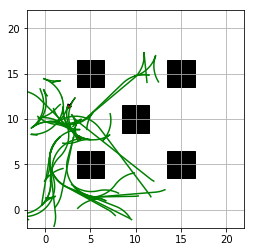

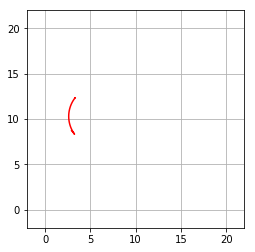

Paths planned: 774
Time taken: 67.198105s
Planning failed
Time taken: 0.000465s
Planning failed
Time taken: 6.150606s
Planning failed
Time taken: 77.143497s
Planning failed
Time taken: 0.001004s


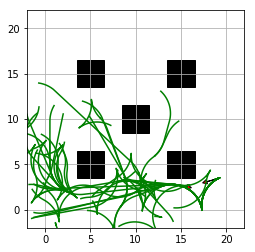

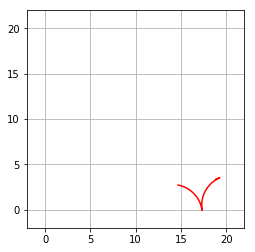

Paths planned: 775
Time taken: 128.580989s


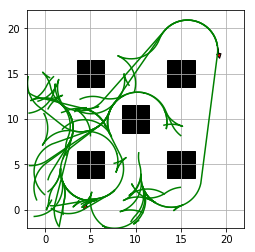

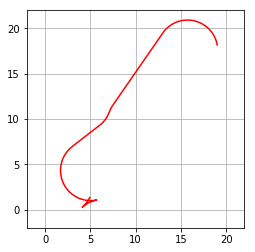

Paths planned: 776
Time taken: 122.867213s
Planning failed
Time taken: 0.000814s


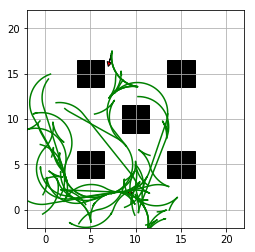

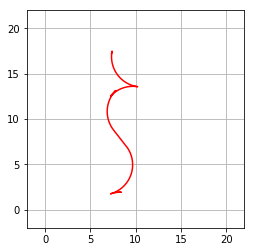

Paths planned: 777
Time taken: 107.741360s


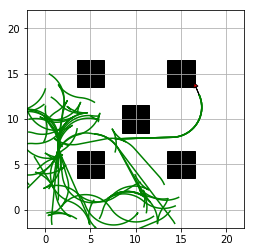

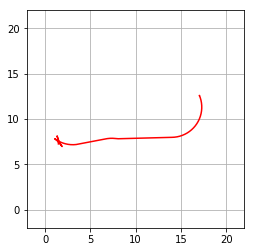

Paths planned: 778
Time taken: 131.046330s
Planning failed
Time taken: 0.000475s
Planning failed
Time taken: 0.000987s


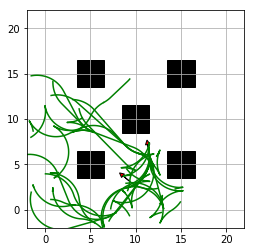

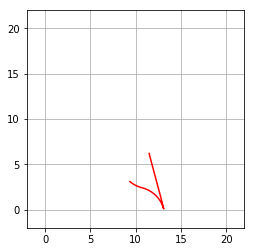

Paths planned: 779
Time taken: 63.984741s
Planning failed
Time taken: 0.000907s


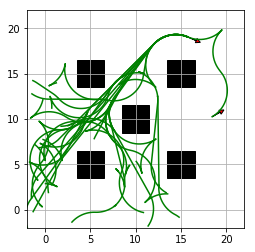

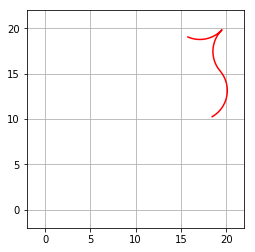

Paths planned: 780
Time taken: 70.674720s
Planning failed
Time taken: 62.646674s


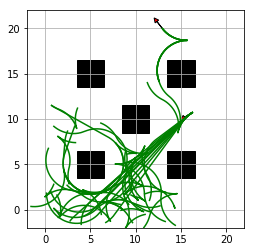

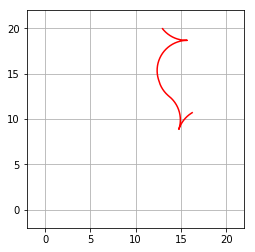

Paths planned: 781
Time taken: 105.929405s


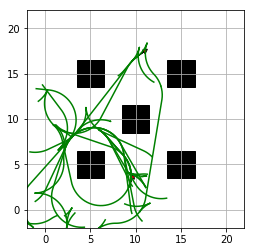

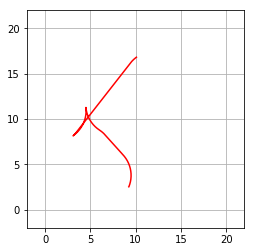

Paths planned: 782
Time taken: 131.700375s


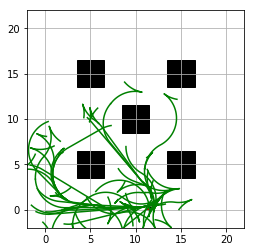

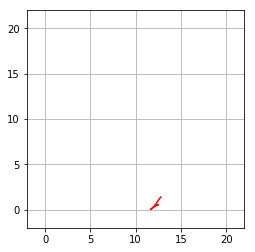

Paths planned: 783
Time taken: 126.892579s
Planning failed
Time taken: 0.000758s


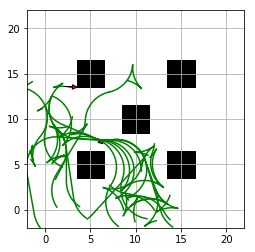

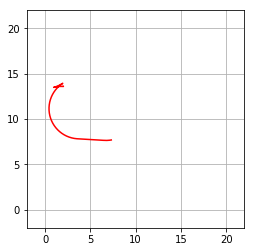

Paths planned: 784
Time taken: 59.378788s
Planning failed
Time taken: 0.000598s
Planning failed
Time taken: 0.000362s
Planning failed
Time taken: 0.000364s


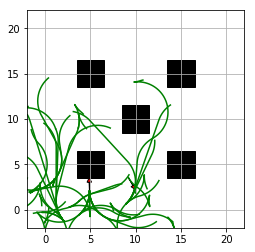

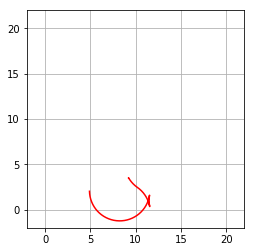

Paths planned: 785
Time taken: 66.210943s


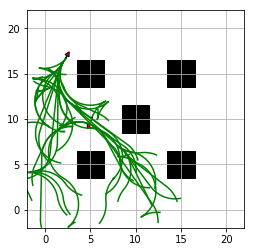

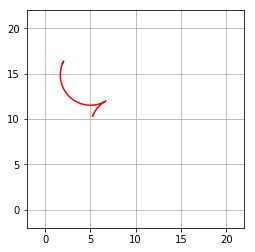

Paths planned: 786
Time taken: 87.058936s


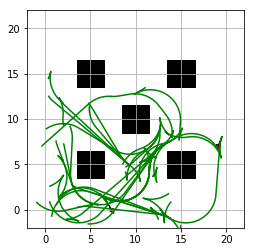

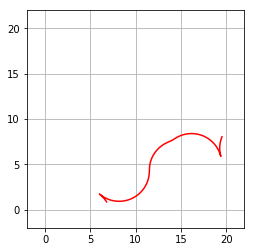

Paths planned: 787
Time taken: 84.711971s
Planning failed
Time taken: 0.001291s
Planning failed
Time taken: 0.000712s


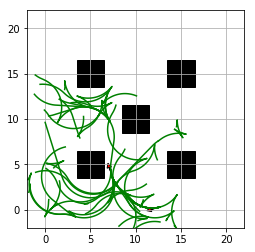

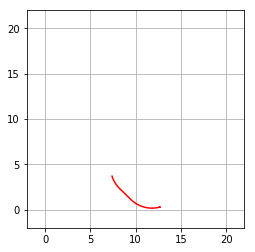

Paths planned: 788
Time taken: 105.378314s
Planning failed
Time taken: 0.000957s


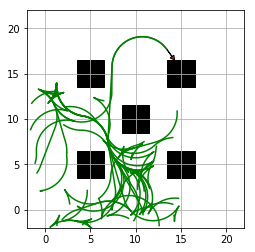

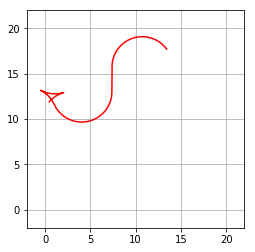

Paths planned: 789
Time taken: 104.829720s
Planning failed
Time taken: 0.000754s
Planning failed
Time taken: 0.000477s
Planning failed
Time taken: 0.000702s
Planning failed
Time taken: 19.681561s
Planning failed
Time taken: 73.141989s


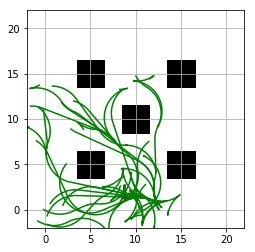

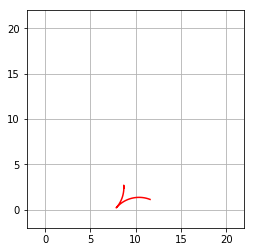

Paths planned: 790
Time taken: 87.040994s


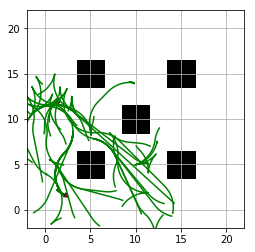

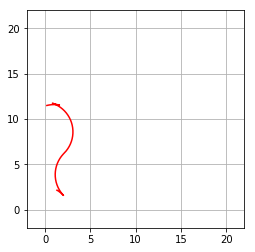

Paths planned: 791
Time taken: 122.054430s
Planning failed
Time taken: 0.000808s
Planning failed
Time taken: 0.001179s
Planning failed
Time taken: 0.000481s


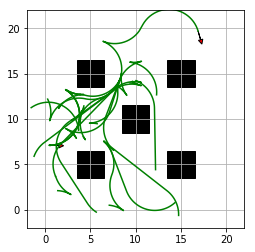

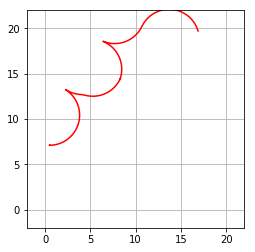

Paths planned: 792
Time taken: 30.139982s
Planning failed
Time taken: 0.000979s
Planning failed
Time taken: 0.000721s


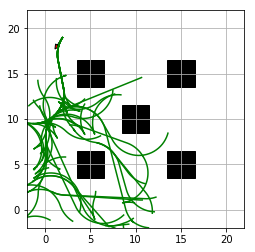

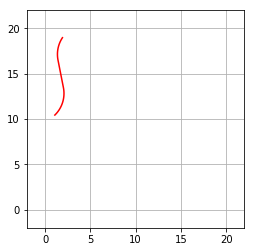

Paths planned: 793
Time taken: 120.401398s
Planning failed
Time taken: 0.001176s


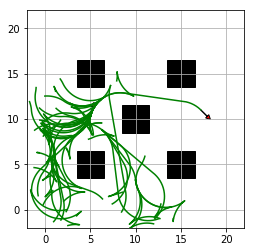

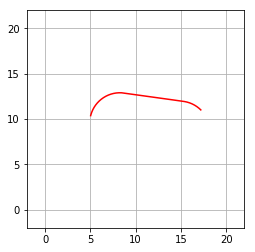

Paths planned: 794
Time taken: 106.403665s
Planning failed
Time taken: 0.000862s


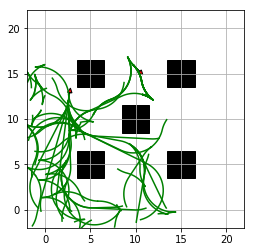

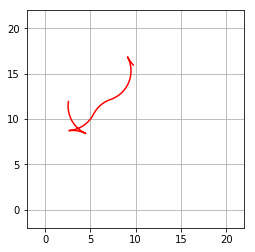

Paths planned: 795
Time taken: 129.138552s
Planning failed
Time taken: 0.000921s
Planning failed
Time taken: 0.000758s
Planning failed
Time taken: 0.000458s


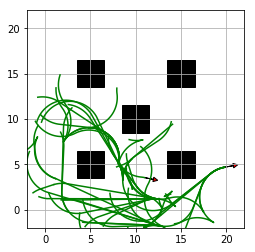

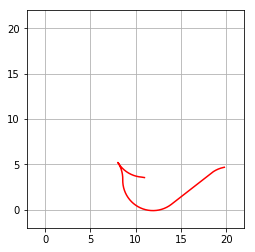

Paths planned: 796
Time taken: 107.126716s
Planning failed
Time taken: 98.119494s


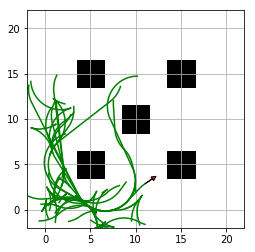

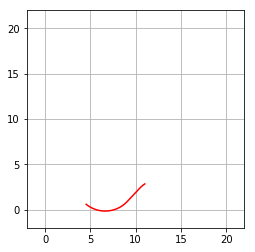

Paths planned: 797
Time taken: 100.413748s
Planning failed
Time taken: 0.001216s
Planning failed
Time taken: 0.000805s
Planning failed
Time taken: 0.000449s


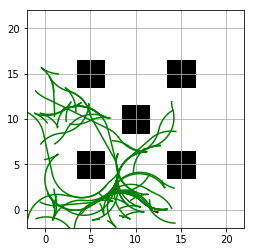

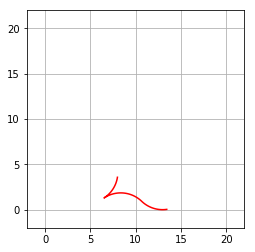

Paths planned: 798
Time taken: 138.679668s


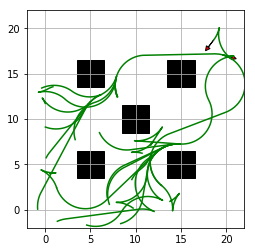

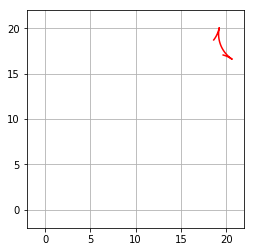

Paths planned: 799
Time taken: 33.017944s
Planning failed
Time taken: 50.668555s
Planning failed
Time taken: 0.001018s
mincost is inf


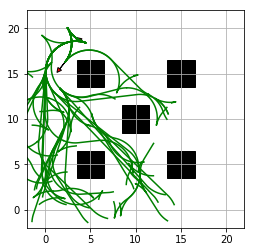

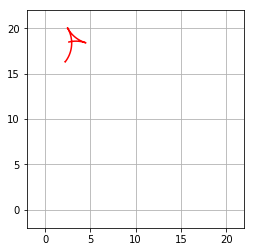

Paths planned: 800
Time taken: 149.271373s
Planning failed
Time taken: 0.001075s
Planning failed
Time taken: 89.615452s
Planning failed
Time taken: 20.462936s


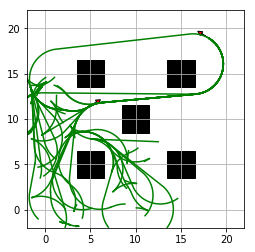

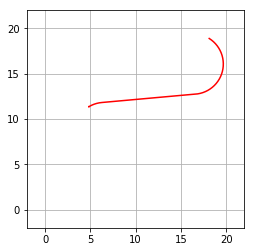

Paths planned: 801
Time taken: 161.316692s


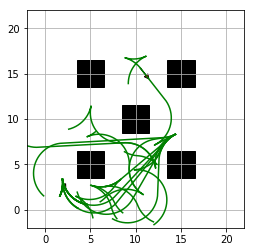

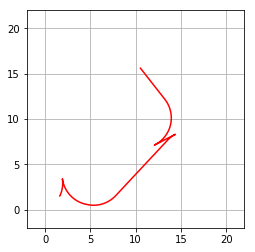

Paths planned: 802
Time taken: 33.879741s
Planning failed
Time taken: 85.535720s
Planning failed
Time taken: 0.000698s
Planning failed
Time taken: 0.000610s
Planning failed
Time taken: 0.000320s


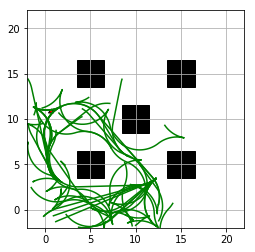

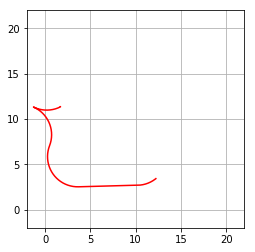

Paths planned: 803
Time taken: 125.206989s


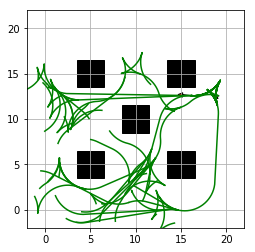

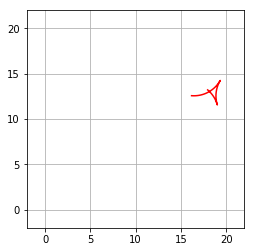

Paths planned: 804
Time taken: 133.117988s
Planning failed
Time taken: 0.000777s
Planning failed
Time taken: 0.000390s


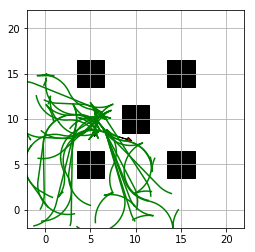

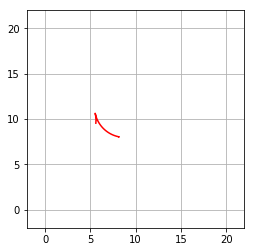

Paths planned: 805
Time taken: 91.271605s
Planning failed
Time taken: 0.001165s
Planning failed
Time taken: 0.000526s


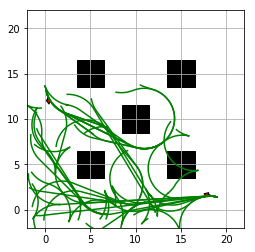

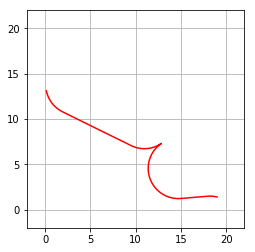

Paths planned: 806
Time taken: 111.203630s
Planning failed
Time taken: 0.001255s
Planning failed
Time taken: 0.001302s


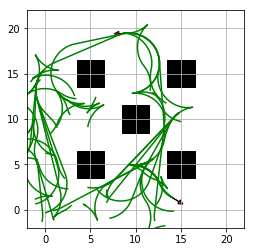

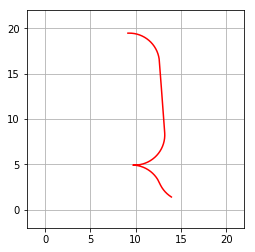

Paths planned: 807
Time taken: 104.169136s


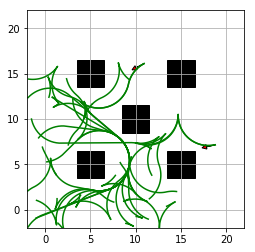

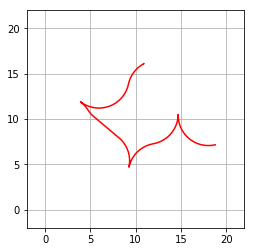

Paths planned: 808
Time taken: 68.145997s


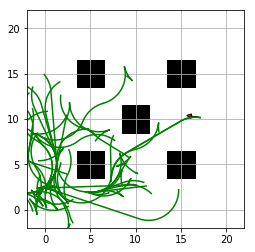

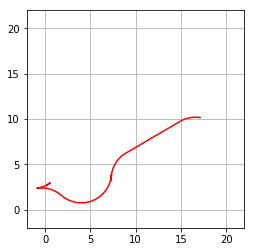

Paths planned: 809
Time taken: 91.179919s


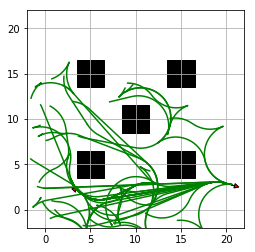

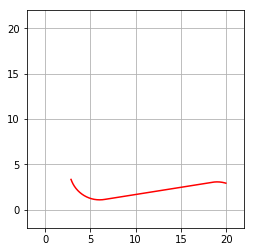

Paths planned: 810
Time taken: 128.343311s


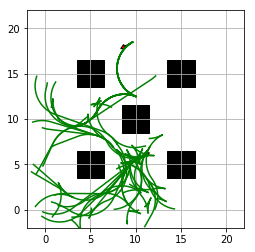

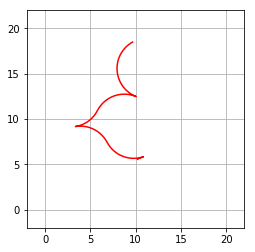

Paths planned: 811
Time taken: 125.660258s
Planning failed
Time taken: 0.000832s
Planning failed
Time taken: 0.001145s


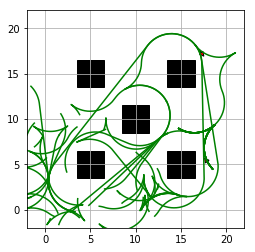

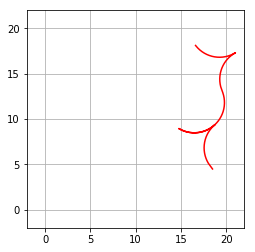

Paths planned: 812
Time taken: 94.934573s
Planning failed
Time taken: 0.001479s


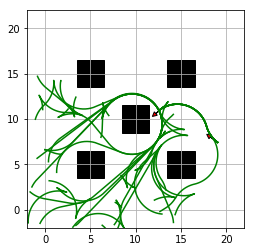

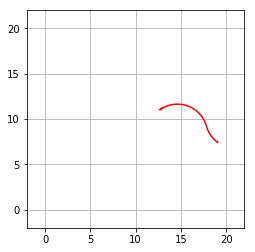

Paths planned: 813
Time taken: 98.183740s
Planning failed
Time taken: 0.001061s
Planning failed
Time taken: 0.000681s
Planning failed
Time taken: 0.000378s
Planning failed
Time taken: 2.521530s
Planning failed
Time taken: 0.000323s
Planning failed
Time taken: 88.438727s


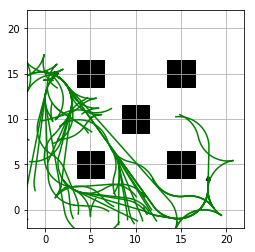

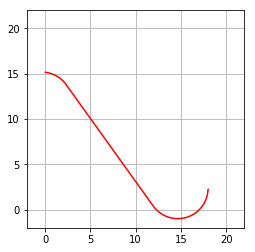

Paths planned: 814
Time taken: 201.364572s
Planning failed
Time taken: 0.001735s


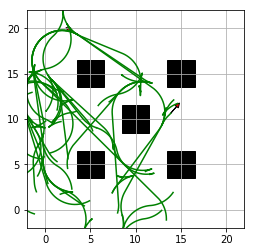

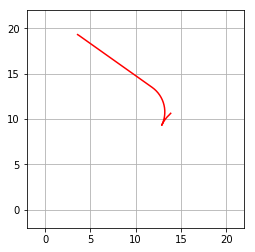

Paths planned: 815
Time taken: 102.120899s
Planning failed
Time taken: 0.000875s
Planning failed
Time taken: 0.000739s
Planning failed
Time taken: 0.000294s


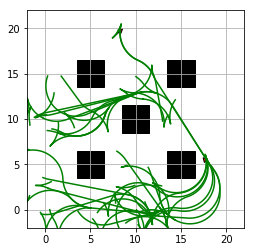

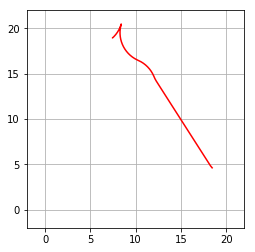

Paths planned: 816
Time taken: 112.631436s
Planning failed
Time taken: 0.001629s
Planning failed
Time taken: 0.000498s
Planning failed
Time taken: 82.305363s


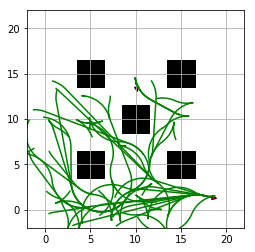

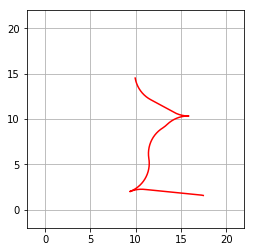

Paths planned: 817
Time taken: 94.364510s


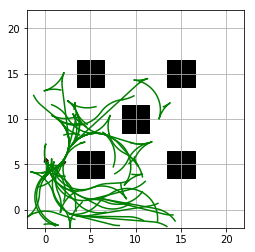

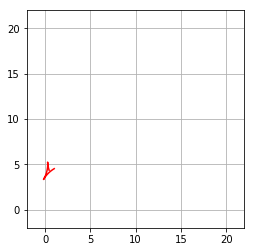

Paths planned: 818
Time taken: 153.363007s
Planning failed
Time taken: 0.000551s


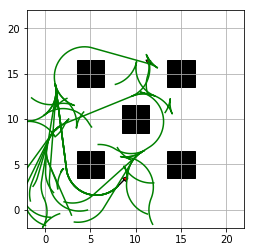

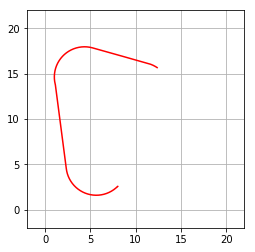

Paths planned: 819
Time taken: 59.326134s
Planning failed
Time taken: 0.001632s
Planning failed
Time taken: 102.419662s
Planning failed
Time taken: 58.922099s


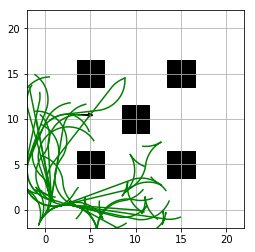

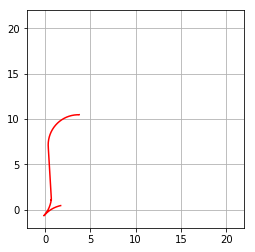

Paths planned: 820
Time taken: 75.476430s
Planning failed
Time taken: 0.000436s


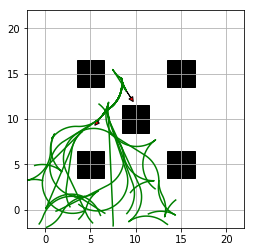

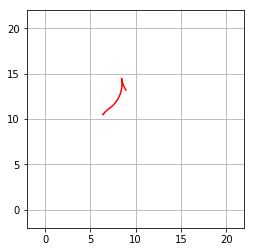

Paths planned: 821
Time taken: 65.401069s
Planning failed
Time taken: 0.000458s


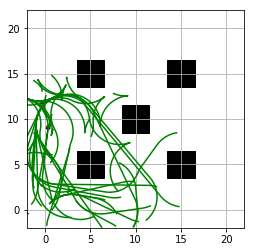

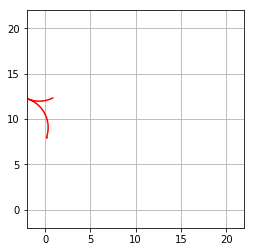

Paths planned: 822
Time taken: 92.107217s


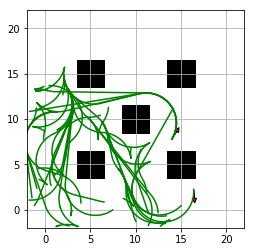

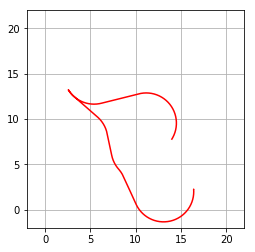

Paths planned: 823
Time taken: 96.027051s
Planning failed
Time taken: 0.000465s


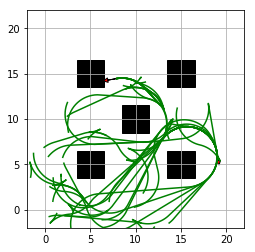

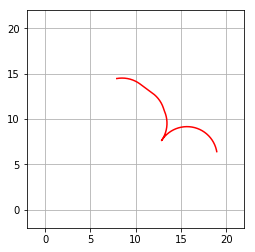

Paths planned: 824
Time taken: 98.286321s
Planning failed
Time taken: 0.000586s
Planning failed
Time taken: 4.609459s
Planning failed
Time taken: 0.000752s
Planning failed
Time taken: 102.893407s
Planning failed
Time taken: 79.227060s


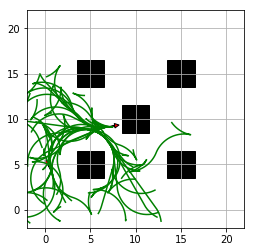

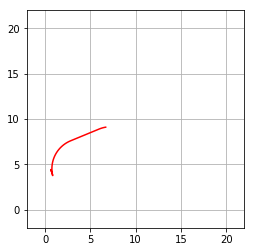

Paths planned: 825
Time taken: 132.635543s
Planning failed
Time taken: 0.000898s


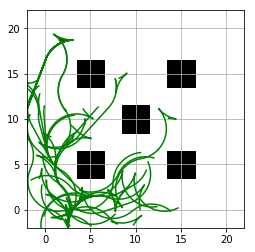

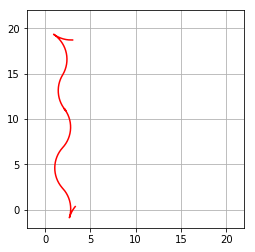

Paths planned: 826
Time taken: 145.054661s


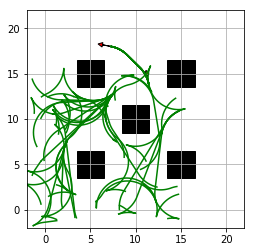

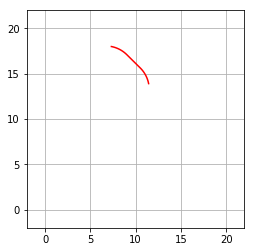

Paths planned: 827
Time taken: 133.228622s


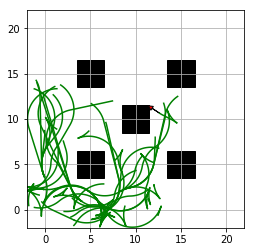

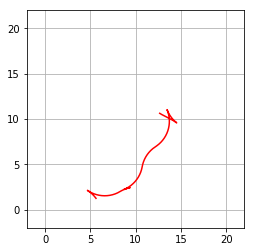

Paths planned: 828
Time taken: 98.673036s


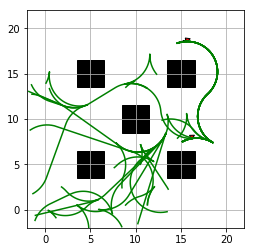

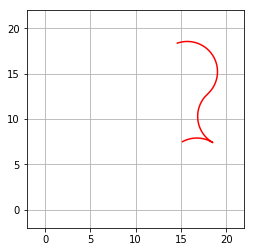

Paths planned: 829
Time taken: 74.291852s
mincost is inf


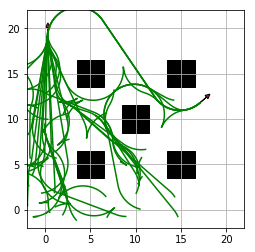

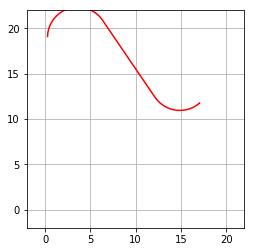

Paths planned: 830
Time taken: 125.315130s
Planning failed
Time taken: 0.000802s


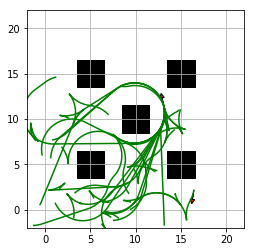

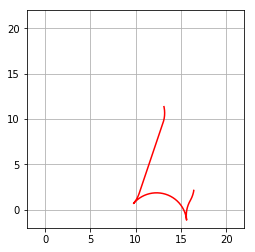

Paths planned: 831
Time taken: 76.176881s
Planning failed
Time taken: 0.000512s


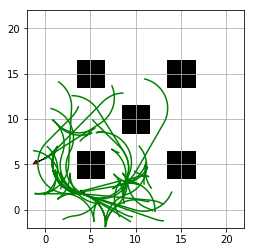

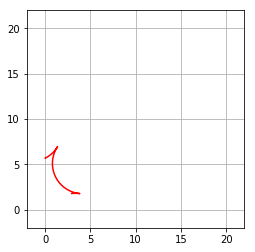

Paths planned: 832
Time taken: 92.749844s
Planning failed
Time taken: 74.381672s


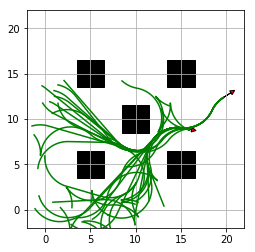

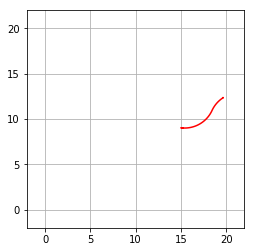

Paths planned: 833
Time taken: 97.098451s
Planning failed
Time taken: 68.034708s


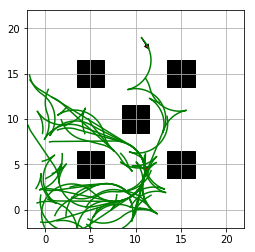

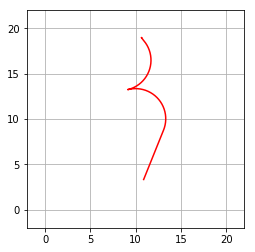

Paths planned: 834
Time taken: 107.956700s


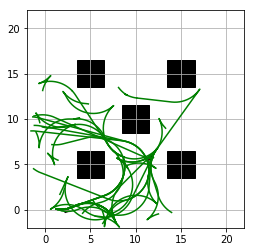

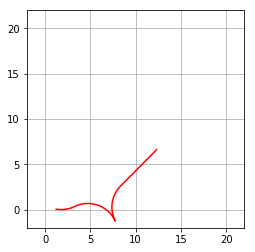

Paths planned: 835
Time taken: 107.047742s
Planning failed
Time taken: 101.034155s


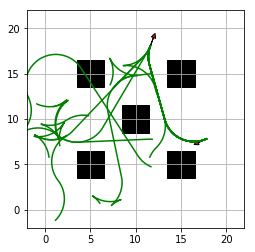

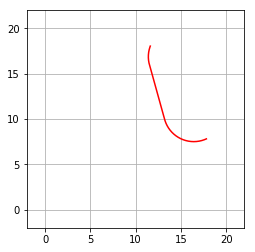

Paths planned: 836
Time taken: 50.496346s
Planning failed
Time taken: 0.001251s


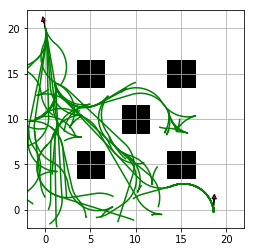

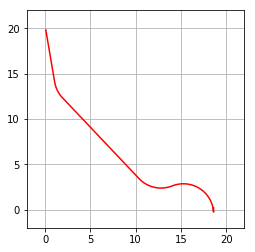

Paths planned: 837
Time taken: 150.931753s


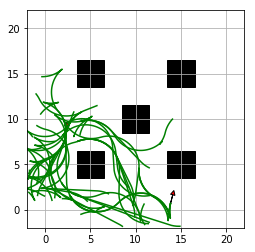

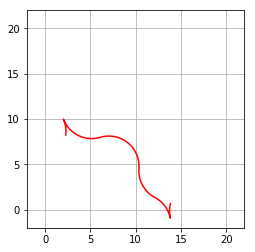

Paths planned: 838
Time taken: 112.760735s
Planning failed
Time taken: 59.157796s


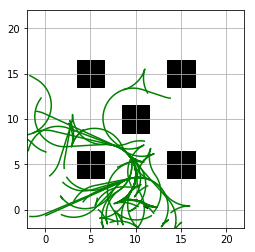

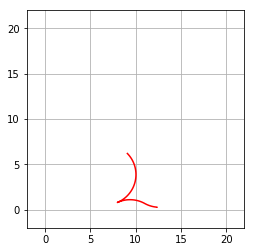

Paths planned: 839
Time taken: 129.221935s
Planning failed
Time taken: 0.001347s
Planning failed
Time taken: 105.040541s


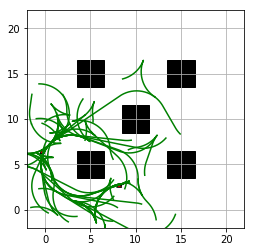

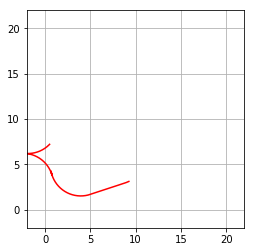

Paths planned: 840
Time taken: 108.209177s
Planning failed
Time taken: 0.000667s
Planning failed
Time taken: 0.000471s
Planning failed
Time taken: 0.000617s
Planning failed
Time taken: 0.000903s


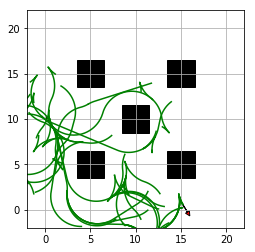

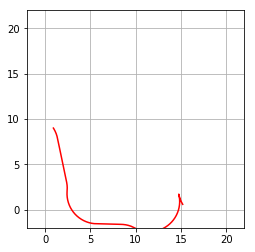

Paths planned: 841
Time taken: 80.248460s
Planning failed
Time taken: 0.001044s


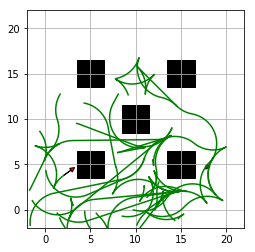

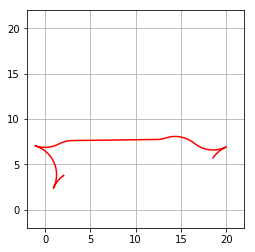

Paths planned: 842
Time taken: 64.956748s
Planning failed
Time taken: 0.000448s
mincost is inf


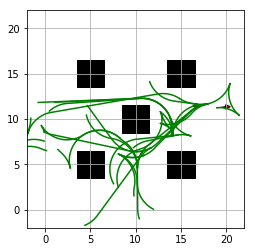

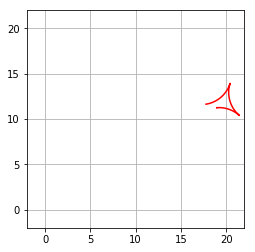

Paths planned: 843
Time taken: 36.518134s
Planning failed
Time taken: 0.000364s


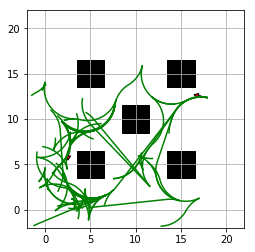

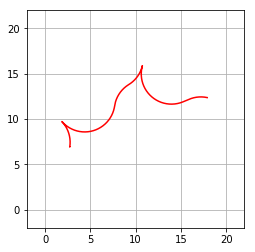

Paths planned: 844
Time taken: 100.062991s


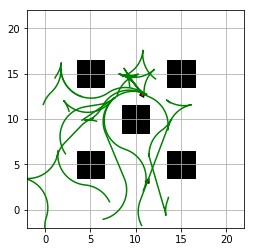

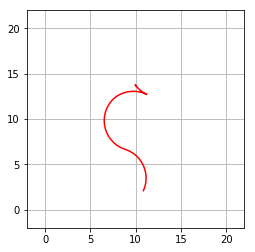

Paths planned: 845
Time taken: 28.076006s


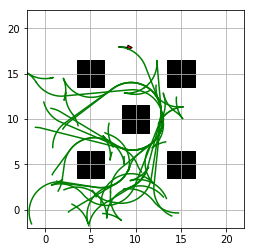

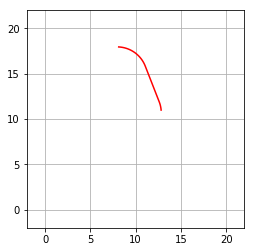

Paths planned: 846
Time taken: 69.869168s
Planning failed
Time taken: 0.001214s
Planning failed
Time taken: 73.531332s
Planning failed
Time taken: 0.000459s
Planning failed
Time taken: 152.334679s


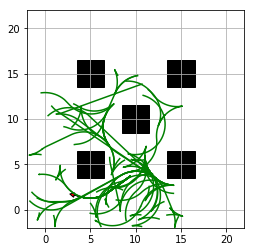

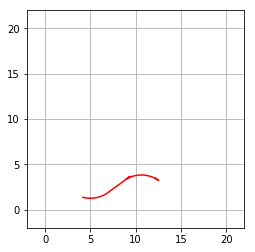

Paths planned: 847
Time taken: 170.740189s
Planning failed
Time taken: 0.001188s


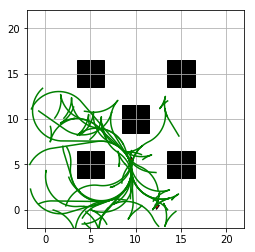

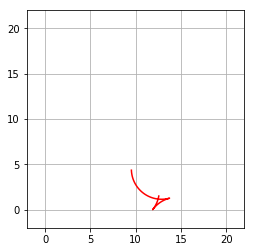

Paths planned: 848
Time taken: 119.806772s


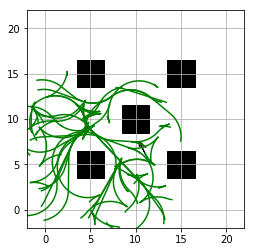

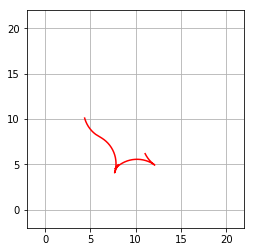

Paths planned: 849
Time taken: 128.654091s


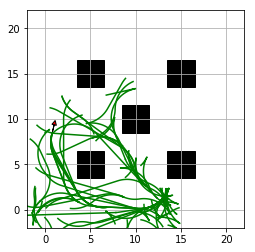

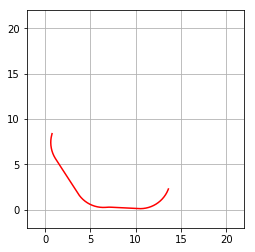

Paths planned: 850
Time taken: 141.295624s


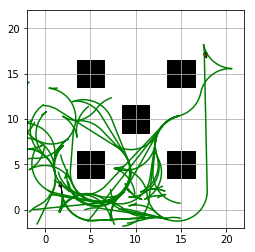

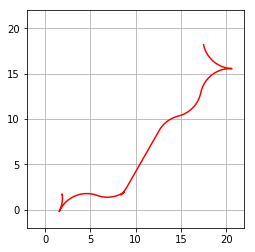

Paths planned: 851
Time taken: 151.913322s
Planning failed
Time taken: 0.001034s
Planning failed
Time taken: 0.001287s
Planning failed
Time taken: 95.855424s
Planning failed
Time taken: 0.000750s


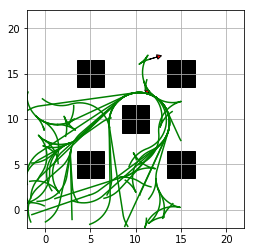

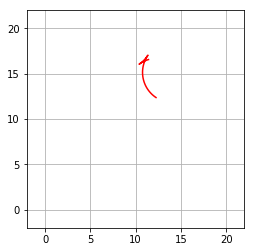

Paths planned: 852
Time taken: 111.088924s


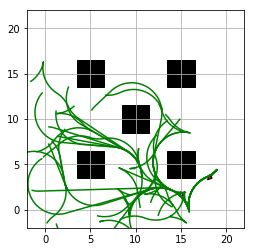

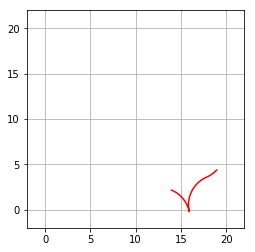

Paths planned: 853
Time taken: 104.767748s
Planning failed
Time taken: 0.001691s


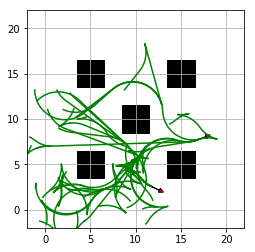

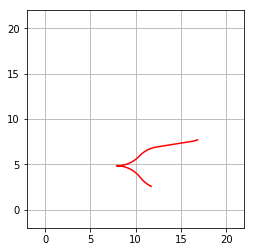

Paths planned: 854
Time taken: 120.938066s


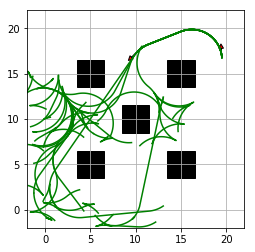

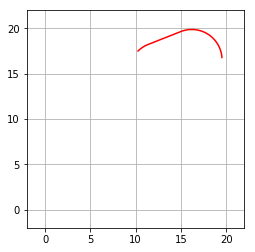

Paths planned: 855
Time taken: 105.564588s
Planning failed
Time taken: 0.000831s
Planning failed
Time taken: 0.001018s
Planning failed
Time taken: 0.000414s
Planning failed
Time taken: 106.057377s
Planning failed
Time taken: 0.000919s


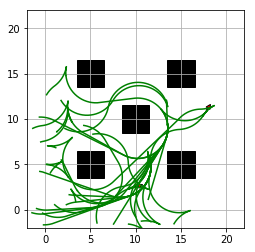

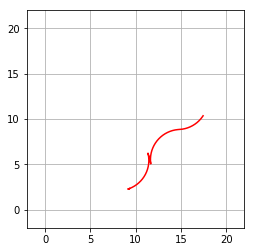

Paths planned: 856
Time taken: 85.488926s


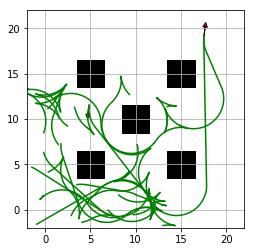

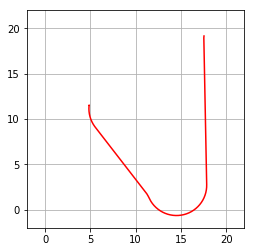

Paths planned: 857
Time taken: 67.007421s


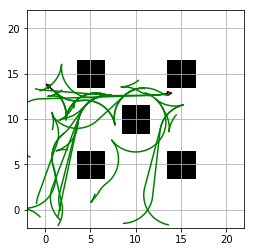

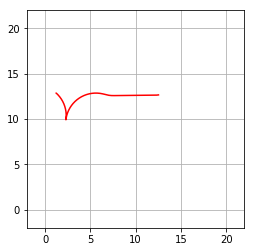

Paths planned: 858
Time taken: 52.364019s
Planning failed
Time taken: 96.358912s


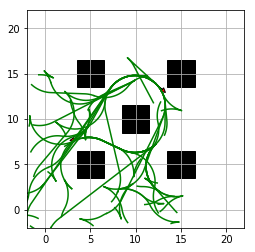

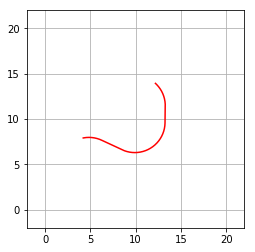

Paths planned: 859
Time taken: 163.018061s


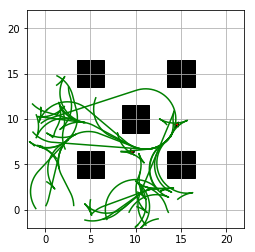

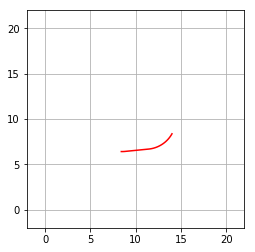

Paths planned: 860
Time taken: 78.089337s
Planning failed
Time taken: 112.363183s
Planning failed
Time taken: 0.000999s


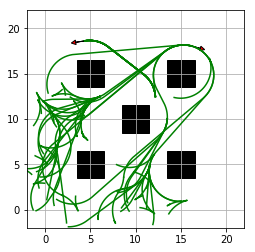

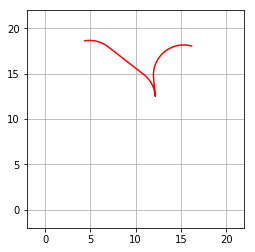

Paths planned: 861
Time taken: 157.385885s
mincost is inf


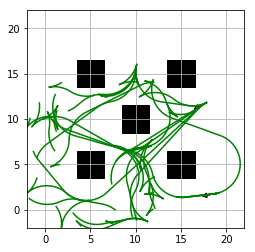

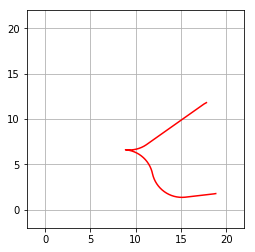

Paths planned: 862
Time taken: 117.288709s
Planning failed
Time taken: 0.000709s
Planning failed
Time taken: 0.000845s


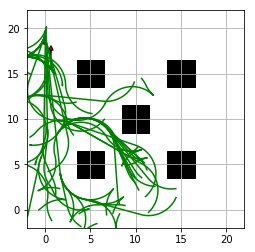

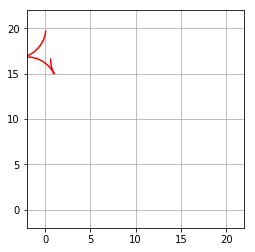

Paths planned: 863
Time taken: 158.325283s
Planning failed
Time taken: 0.000646s


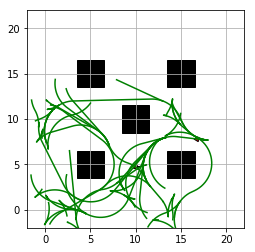

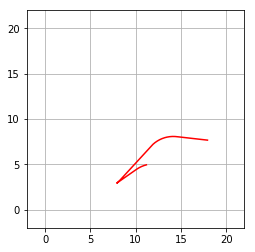

Paths planned: 864
Time taken: 107.237023s


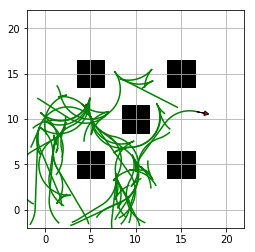

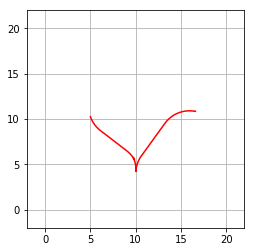

Paths planned: 865
Time taken: 111.426715s


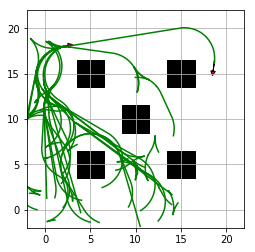

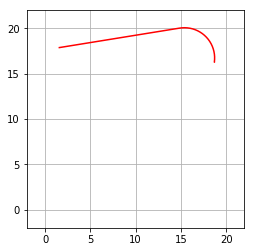

Paths planned: 866
Time taken: 117.755424s
Planning failed
Time taken: 0.001378s


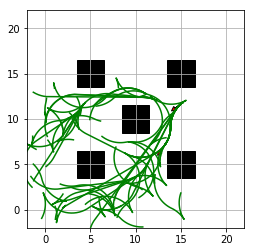

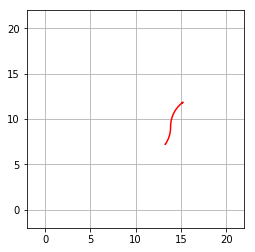

Paths planned: 867
Time taken: 229.160227s


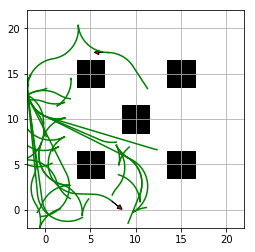

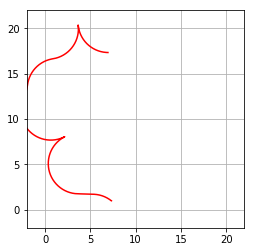

Paths planned: 868
Time taken: 36.431423s


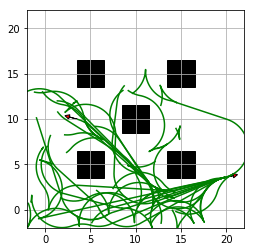

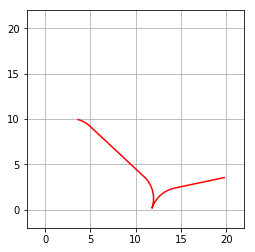

Paths planned: 869
Time taken: 101.544638s


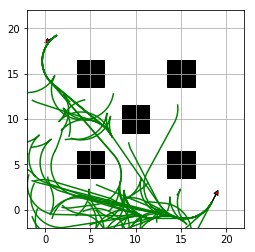

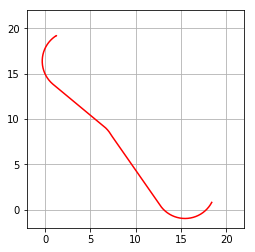

Paths planned: 870
Time taken: 137.070564s
Planning failed
Time taken: 0.002045s


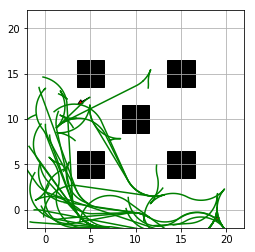

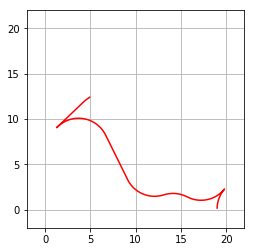

Paths planned: 871
Time taken: 85.586617s


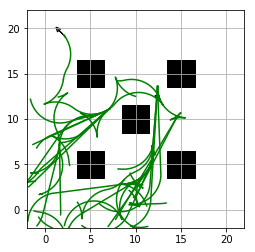

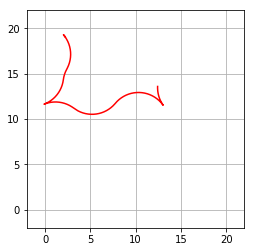

Paths planned: 872
Time taken: 92.921612s
Planning failed
Time taken: 0.001346s


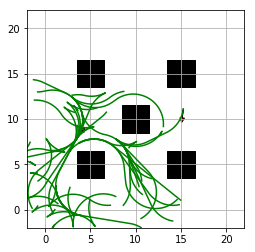

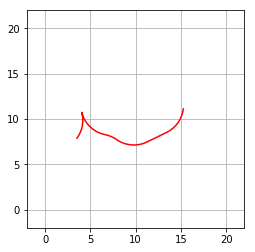

Paths planned: 873
Time taken: 94.627693s
Planning failed
Time taken: 0.000781s
Planning failed
Time taken: 60.850458s
Planning failed
Time taken: 0.000559s


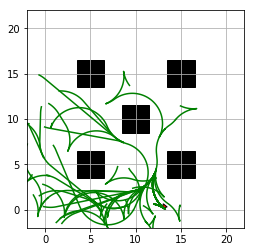

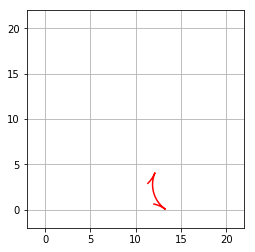

Paths planned: 874
Time taken: 196.758149s
Planning failed
Time taken: 0.001343s
Planning failed
Time taken: 0.000431s


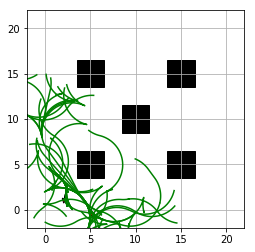

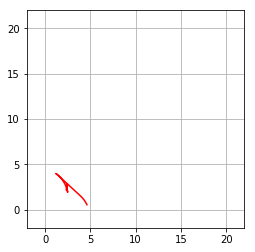

Paths planned: 875
Time taken: 129.242831s


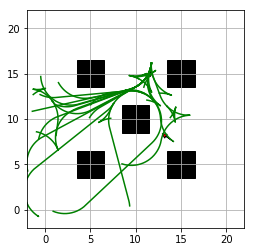

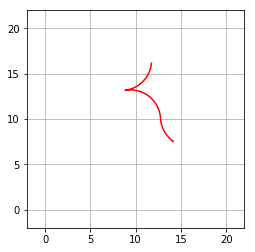

Paths planned: 876
Time taken: 44.085740s
Planning failed
Time taken: 99.975627s
Planning failed
Time taken: 0.000896s


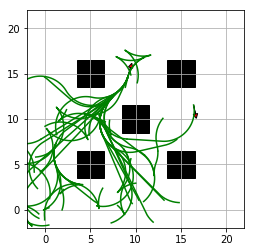

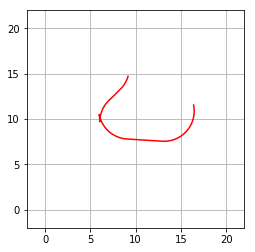

Paths planned: 877
Time taken: 93.256945s


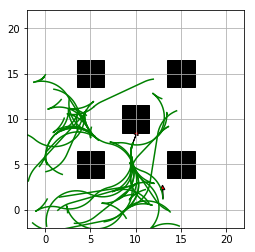

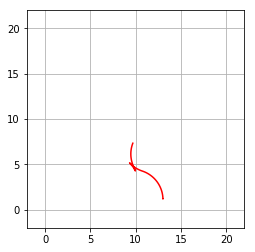

Paths planned: 878
Time taken: 81.388947s


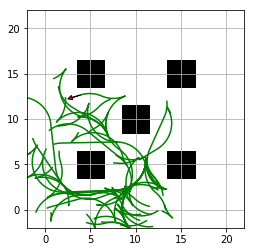

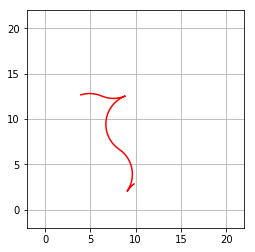

Paths planned: 879
Time taken: 120.771835s
Planning failed
Time taken: 0.001117s


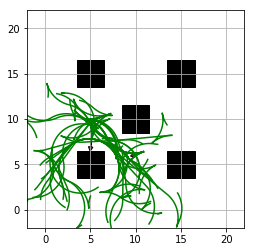

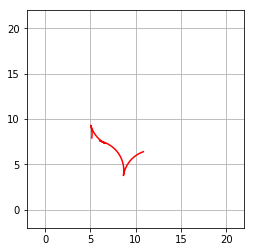

Paths planned: 880
Time taken: 162.719528s
Planning failed
Time taken: 88.556702s


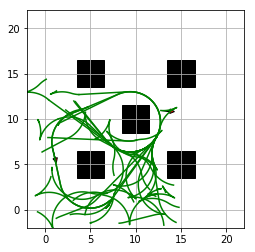

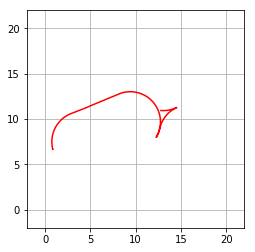

Paths planned: 881
Time taken: 102.619471s
Planning failed
Time taken: 0.001384s


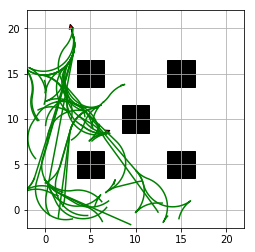

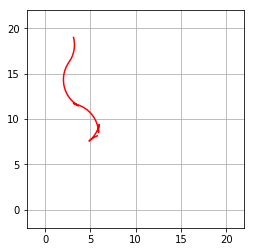

Paths planned: 882
Time taken: 97.529678s
Planning failed
Time taken: 0.001855s


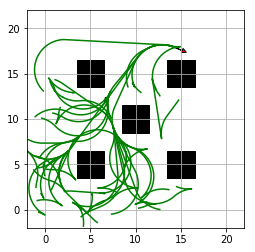

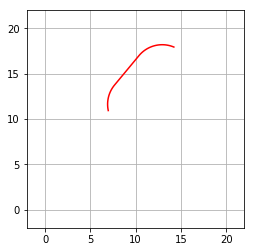

Paths planned: 883
Time taken: 101.950622s


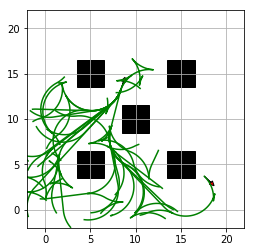

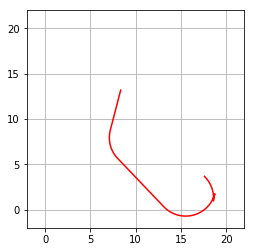

Paths planned: 884
Time taken: 96.323128s
Planning failed
Time taken: 0.001405s
Planning failed
Time taken: 0.001272s


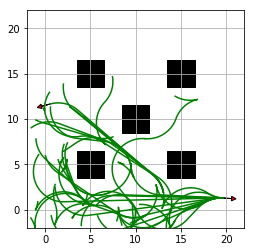

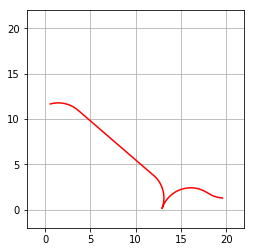

Paths planned: 885
Time taken: 94.618644s
Planning failed
Time taken: 0.001304s
Planning failed
Time taken: 0.000406s
Planning failed
Time taken: 0.000599s
Planning failed
Time taken: 75.279446s


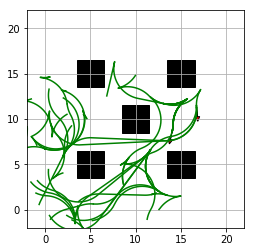

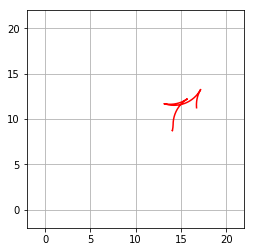

Paths planned: 886
Time taken: 89.114463s
Planning failed
Time taken: 0.001287s
Planning failed
Time taken: 0.001446s


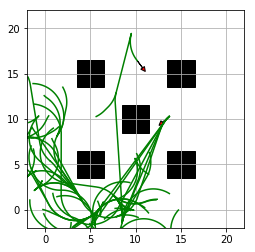

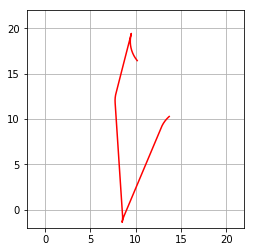

Paths planned: 887
Time taken: 120.522578s
Planning failed
Time taken: 0.000768s
Planning failed
Time taken: 0.001302s
Planning failed
Time taken: 154.877066s


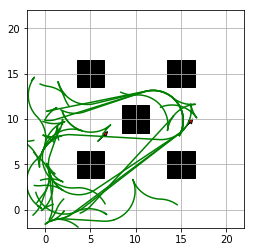

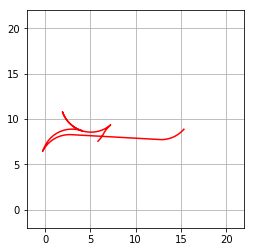

Paths planned: 888
Time taken: 75.678973s


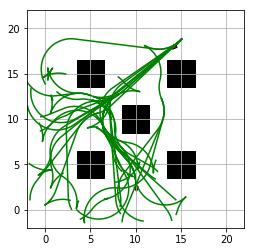

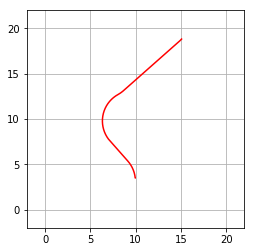

Paths planned: 889
Time taken: 136.985373s
Planning failed
Time taken: 0.000572s
mincost is inf


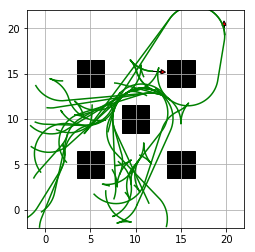

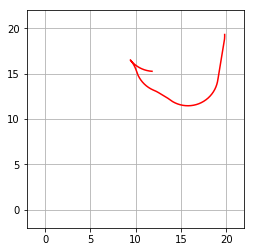

Paths planned: 890
Time taken: 86.063853s
Planning failed
Time taken: 0.001356s
Planning failed
Time taken: 0.000725s


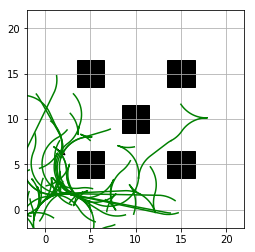

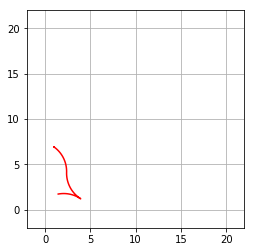

Paths planned: 891
Time taken: 111.256898s
Planning failed
Time taken: 0.001528s
Planning failed
Time taken: 0.000530s
Planning failed
Time taken: 0.000391s
Planning failed
Time taken: 0.000495s
Planning failed
Time taken: 0.000997s
Planning failed
Time taken: 0.000252s


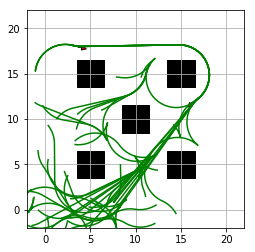

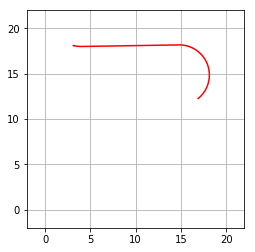

Paths planned: 892
Time taken: 130.341274s
Planning failed
Time taken: 97.371635s
Planning failed
Time taken: 0.001781s
Planning failed
Time taken: 0.000979s


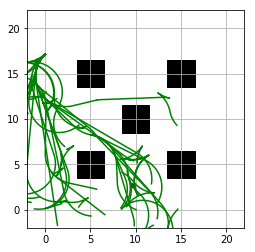

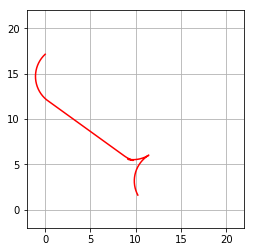

Paths planned: 893
Time taken: 111.462315s
Planning failed
Time taken: 0.001113s
Planning failed
Time taken: 0.001028s
Planning failed
Time taken: 127.183061s
Planning failed
Time taken: 0.001562s
Planning failed
Time taken: 15.073162s
Planning failed
Time taken: 0.000960s
Planning failed
Time taken: 62.710914s


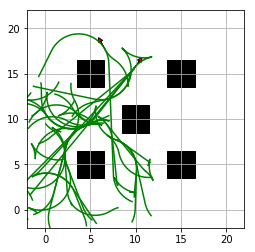

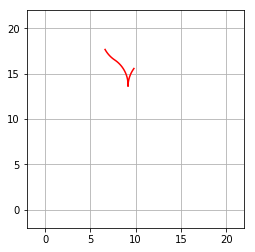

Paths planned: 894
Time taken: 98.306139s
Planning failed
Time taken: 131.613992s
Planning failed
Time taken: 0.000586s


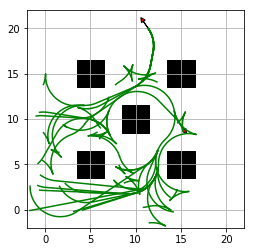

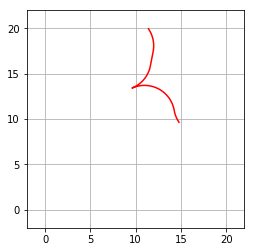

Paths planned: 895
Time taken: 115.344069s
Planning failed
Time taken: 126.755157s
Planning failed
Time taken: 0.001034s


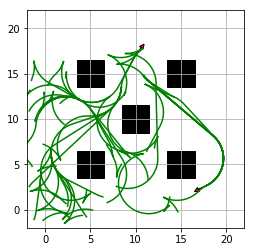

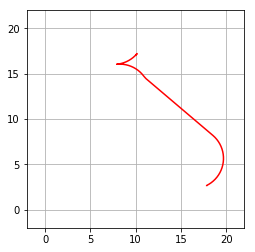

Paths planned: 896
Time taken: 101.138107s


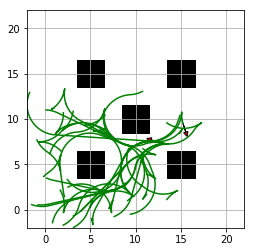

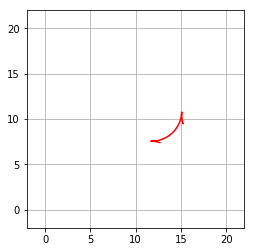

Paths planned: 897
Time taken: 86.371197s


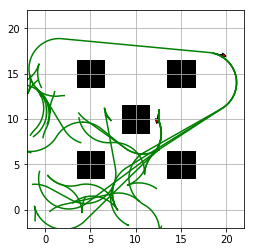

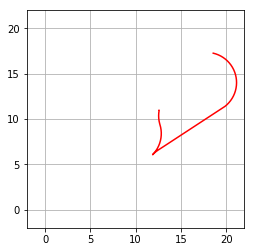

Paths planned: 898
Time taken: 53.404342s


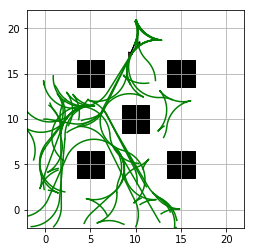

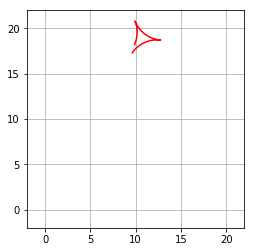

Paths planned: 899
Time taken: 132.322536s
Planning failed
Time taken: 59.789950s


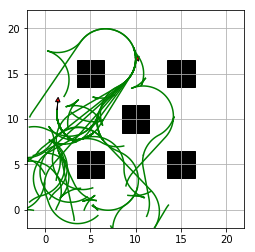

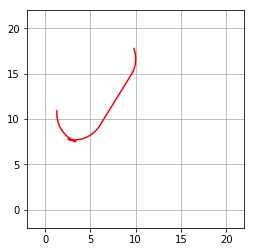

Paths planned: 900
Time taken: 118.346080s


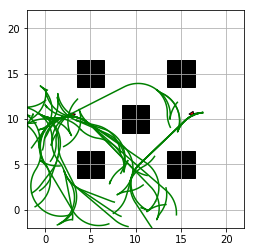

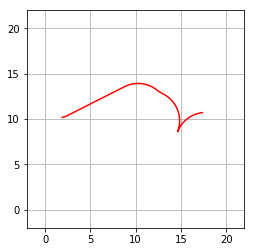

Paths planned: 901
Time taken: 140.651568s
Planning failed
Time taken: 0.000838s


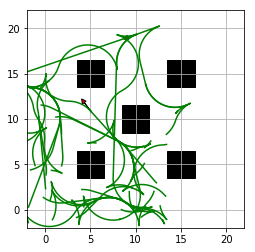

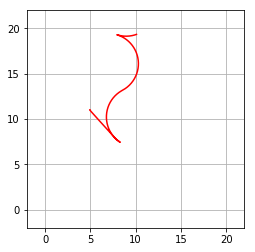

Paths planned: 902
Time taken: 96.506182s


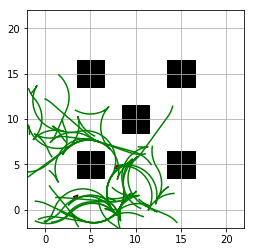

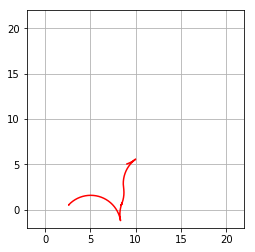

Paths planned: 903
Time taken: 101.328835s
Planning failed
Time taken: 0.001091s
Planning failed
Time taken: 76.426620s
Planning failed
Time taken: 0.000468s


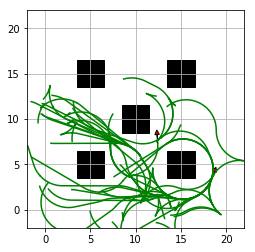

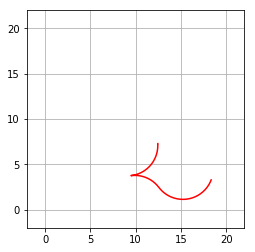

Paths planned: 904
Time taken: 116.038144s
Planning failed
Time taken: 0.001053s
Planning failed
Time taken: 0.000618s
Planning failed
Time taken: 0.000438s
Planning failed
Time taken: 0.000369s
Planning failed
Time taken: 0.000985s


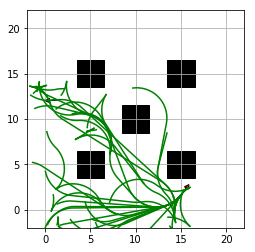

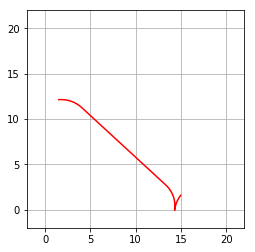

Paths planned: 905
Time taken: 76.253694s
Planning failed
Time taken: 0.001717s


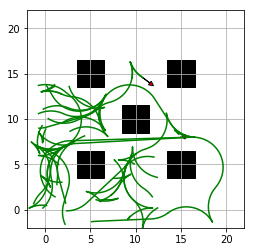

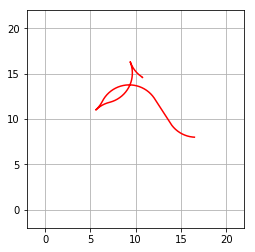

Paths planned: 906
Time taken: 90.933989s
Planning failed
Time taken: 0.000994s


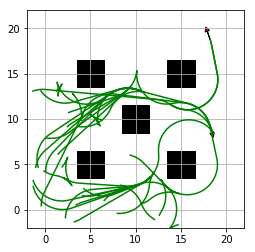

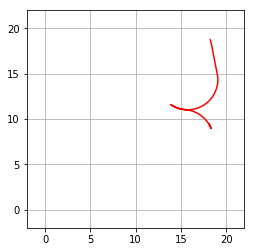

Paths planned: 907
Time taken: 67.588525s


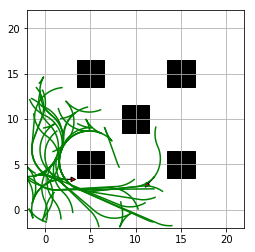

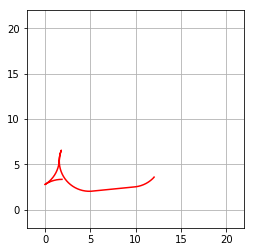

Paths planned: 908
Time taken: 81.523331s
Planning failed
Time taken: 0.001421s
Planning failed
Time taken: 0.000832s


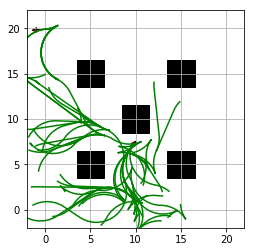

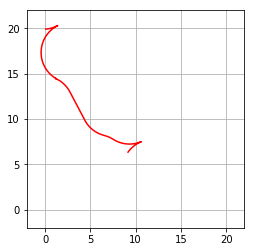

Paths planned: 909
Time taken: 114.055116s


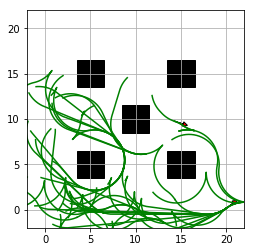

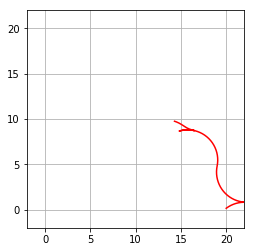

Paths planned: 910
Time taken: 108.748302s
Planning failed
Time taken: 0.001120s


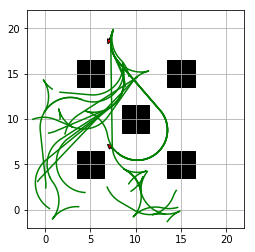

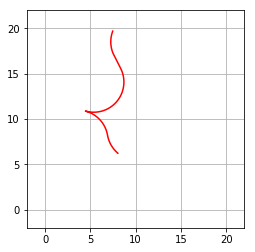

Paths planned: 911
Time taken: 45.971773s


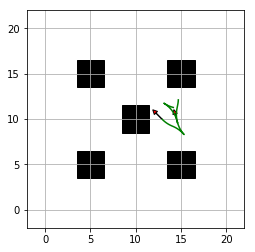

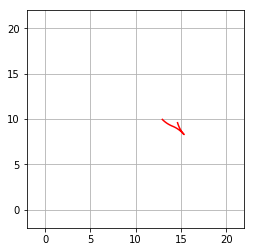

Paths planned: 912
Time taken: 3.920731s
Planning failed
Time taken: 81.521789s
Planning failed
Time taken: 0.001199s
Planning failed
Time taken: 0.001022s


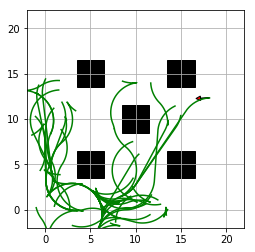

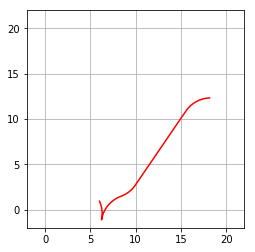

Paths planned: 913
Time taken: 77.321126s
Planning failed
Time taken: 0.000805s
Planning failed
Time taken: 0.000202s
Planning failed
Time taken: 0.000212s
Planning failed
Time taken: 0.000821s
Planning failed
Time taken: 0.000651s
Planning failed
Time taken: 0.000558s
Planning failed
Time taken: 0.000367s
Planning failed
Time taken: 0.000382s


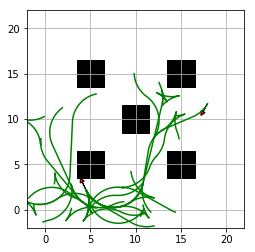

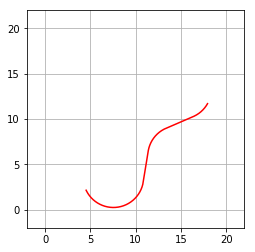

Paths planned: 914
Time taken: 40.725290s


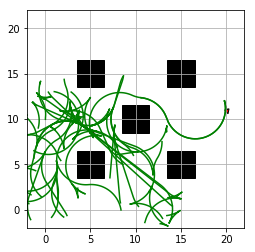

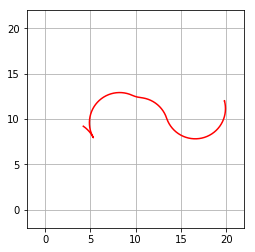

Paths planned: 915
Time taken: 124.445496s
Planning failed
Time taken: 101.165752s


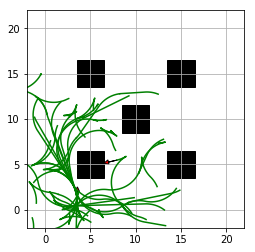

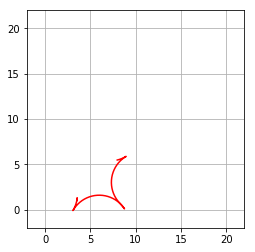

Paths planned: 916
Time taken: 113.851801s
Planning failed
Time taken: 97.916424s
Planning failed
Time taken: 91.660682s
Planning failed
Time taken: 55.112484s


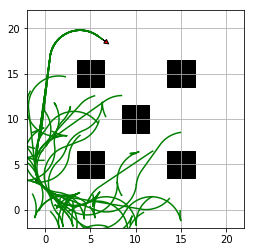

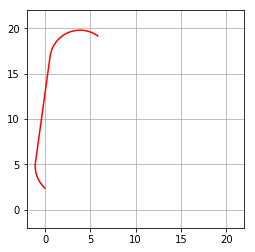

Paths planned: 917
Time taken: 122.912853s
Planning failed
Time taken: 0.001235s
Planning failed
Time taken: 0.000947s


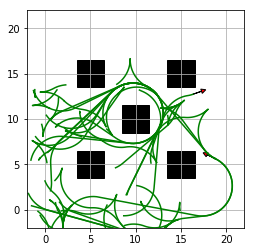

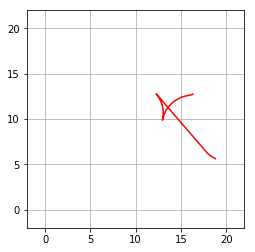

Paths planned: 918
Time taken: 122.040978s
Planning failed
Time taken: 0.001391s
Planning failed
Time taken: 0.001029s


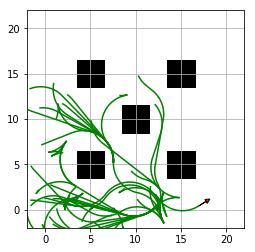

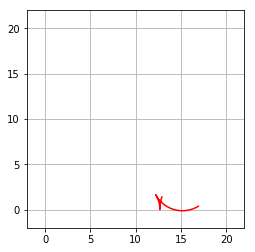

Paths planned: 919
Time taken: 89.852493s


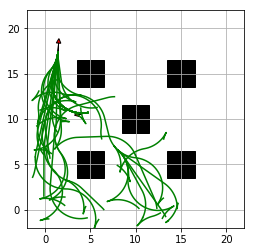

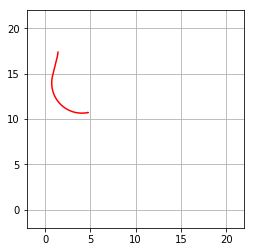

Paths planned: 920
Time taken: 117.074715s


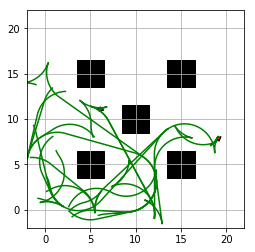

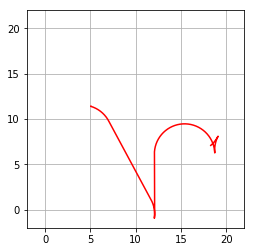

Paths planned: 921
Time taken: 44.268890s
Planning failed
Time taken: 0.001276s


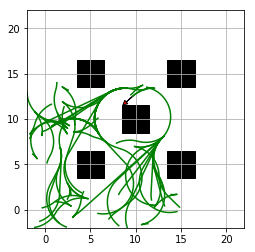

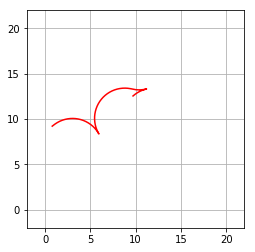

Paths planned: 922
Time taken: 123.777521s
Planning failed
Time taken: 0.001635s
Planning failed
Time taken: 0.000609s
Planning failed
Time taken: 0.000665s


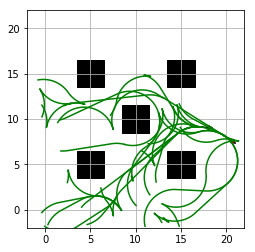

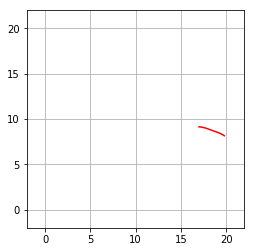

Paths planned: 923
Time taken: 54.287615s
Planning failed
Time taken: 82.639287s
Planning failed
Time taken: 96.373944s
Planning failed
Time taken: 0.001014s
Planning failed
Time taken: 0.000522s
Planning failed
Time taken: 0.000522s


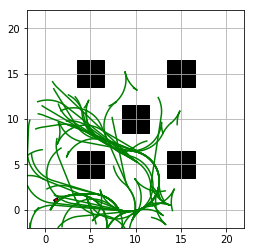

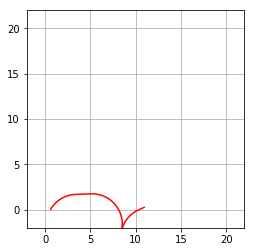

Paths planned: 924
Time taken: 156.936976s
Planning failed
Time taken: 4.997638s
Planning failed
Time taken: 0.000633s
Planning failed
Time taken: 90.299149s


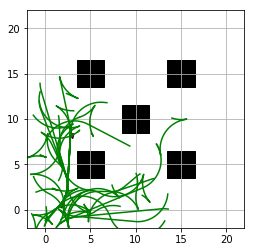

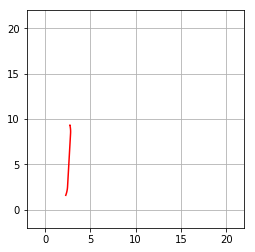

Paths planned: 925
Time taken: 103.910087s
Planning failed
Time taken: 0.000906s


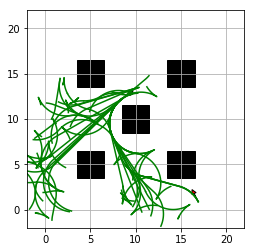

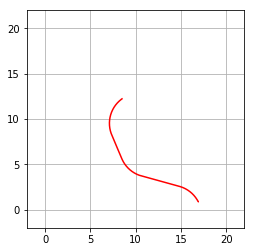

Paths planned: 926
Time taken: 116.282661s
Planning failed
Time taken: 0.000997s
Planning failed
Time taken: 0.000441s
Planning failed
Time taken: 0.000878s


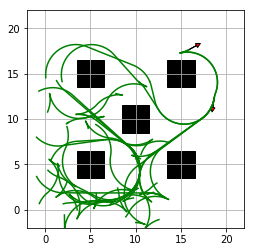

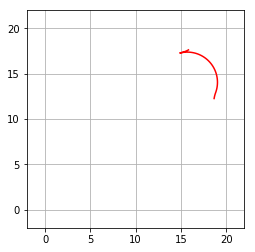

Paths planned: 927
Time taken: 83.438111s


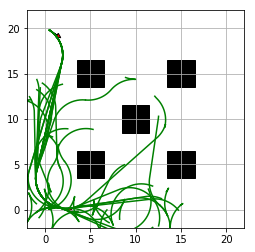

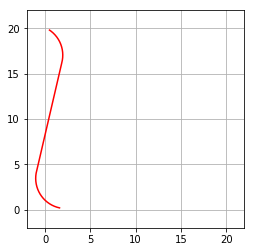

Paths planned: 928
Time taken: 148.248784s
Planning failed
Time taken: 0.001111s


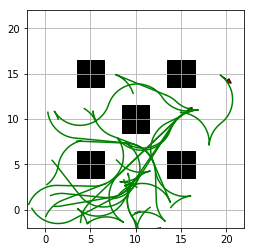

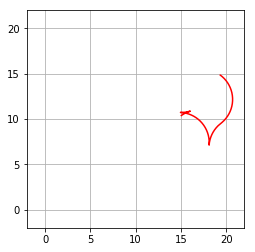

Paths planned: 929
Time taken: 56.588233s
Planning failed
Time taken: 0.000773s
Planning failed
Time taken: 0.000444s
Planning failed
Time taken: 66.356990s


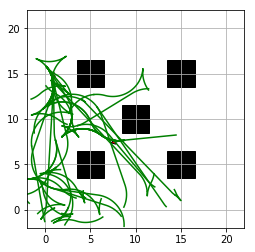

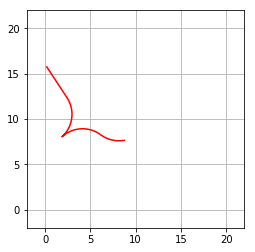

Paths planned: 930
Time taken: 92.944697s
Planning failed
Time taken: 0.000451s


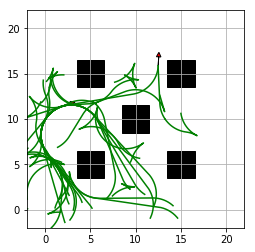

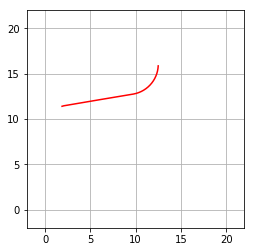

Paths planned: 931
Time taken: 80.477912s
Planning failed
Time taken: 0.000571s


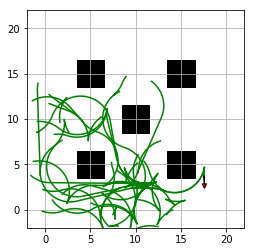

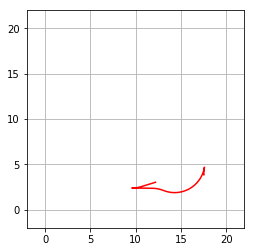

Paths planned: 932
Time taken: 85.924057s
Planning failed
Time taken: 0.000643s


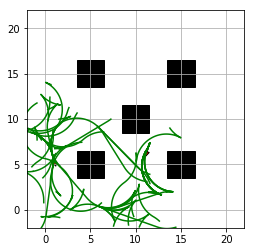

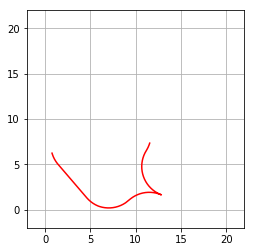

Paths planned: 933
Time taken: 90.160792s


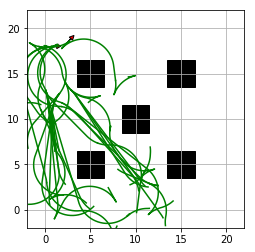

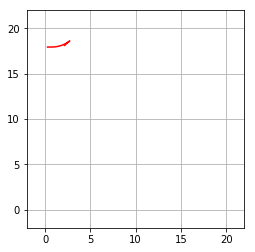

Paths planned: 934
Time taken: 82.970548s
Planning failed
Time taken: 0.000532s


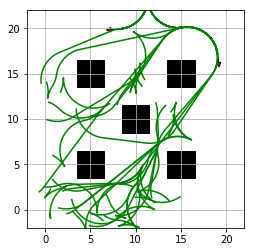

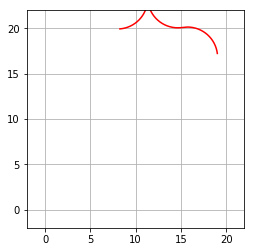

Paths planned: 935
Time taken: 121.931826s
Planning failed
Time taken: 0.000797s


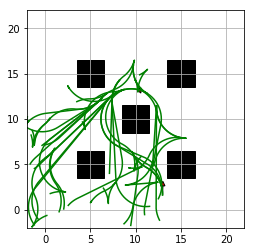

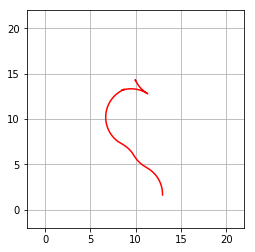

Paths planned: 936
Time taken: 78.843999s
Planning failed
Time taken: 0.001338s
Planning failed
Time taken: 0.000463s
Planning failed
Time taken: 0.001170s


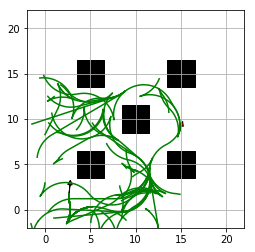

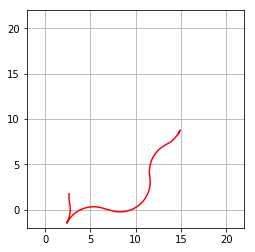

Paths planned: 937
Time taken: 138.233852s
Planning failed
Time taken: 0.001354s


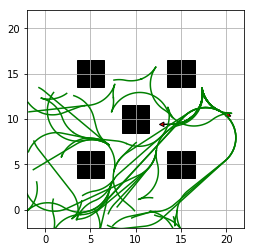

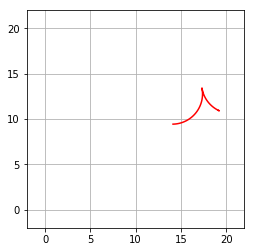

Paths planned: 938
Time taken: 120.833256s
Planning failed
Time taken: 0.000711s
Planning failed
Time taken: 68.254917s


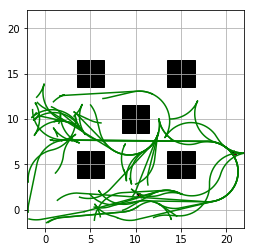

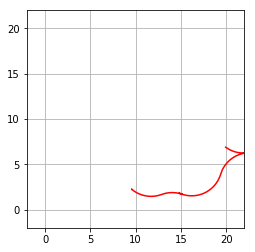

Paths planned: 939
Time taken: 107.437930s


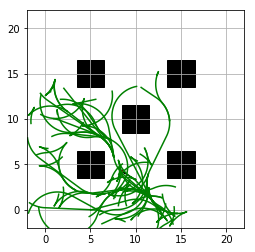

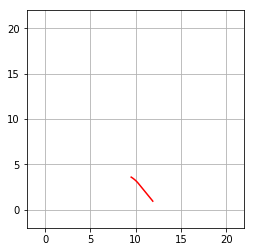

Paths planned: 940
Time taken: 135.945764s


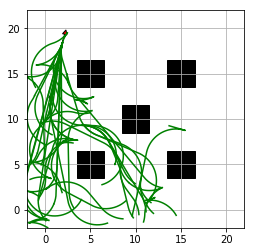

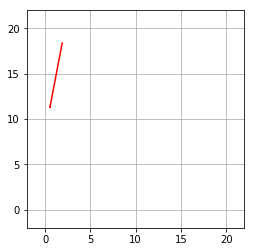

Paths planned: 941
Time taken: 162.294721s
Planning failed
Time taken: 0.000737s


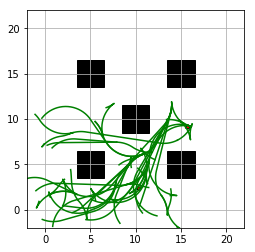

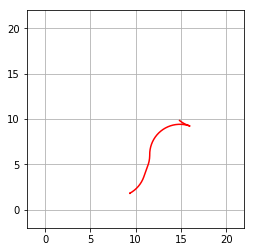

Paths planned: 942
Time taken: 88.690859s
Planning failed
Time taken: 0.000777s
Planning failed
Time taken: 0.000944s
Planning failed
Time taken: 125.551125s


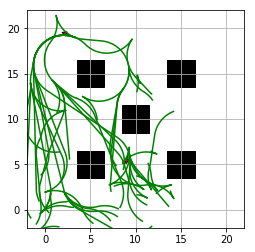

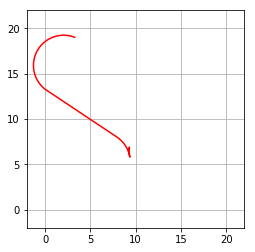

Paths planned: 943
Time taken: 97.122341s


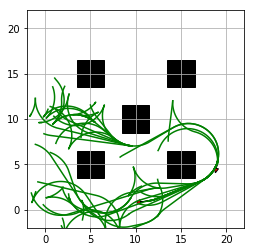

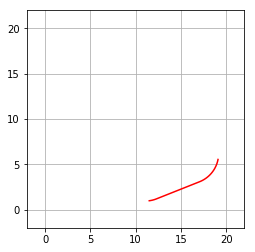

Paths planned: 944
Time taken: 97.014566s
Planning failed
Time taken: 0.000891s
Planning failed
Time taken: 0.000286s


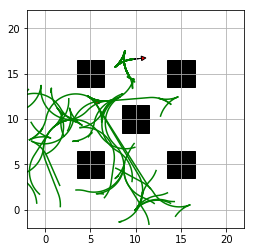

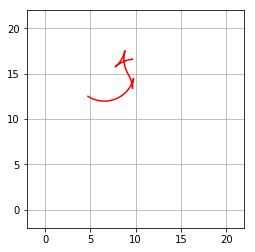

Paths planned: 945
Time taken: 119.948511s
Planning failed
Time taken: 56.356397s
Planning failed
Time taken: 0.000775s
Planning failed
Time taken: 0.000722s
Planning failed
Time taken: 0.000820s
Planning failed
Time taken: 0.000723s
Planning failed
Time taken: 0.000559s


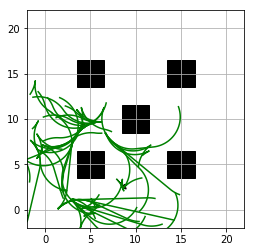

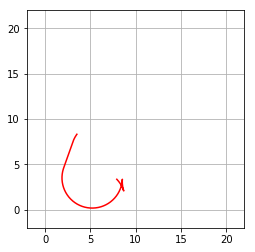

Paths planned: 946
Time taken: 88.325380s
Planning failed
Time taken: 0.001738s
Planning failed
Time taken: 0.001384s
Planning failed
Time taken: 0.000750s


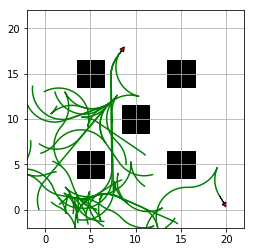

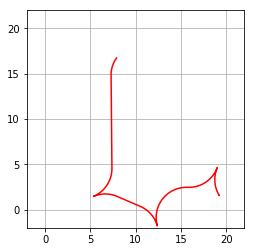

Paths planned: 947
Time taken: 79.396863s
Planning failed
Time taken: 0.001119s


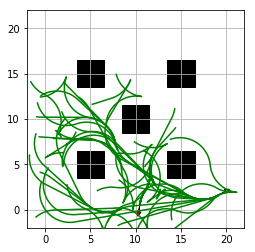

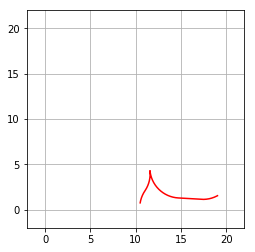

Paths planned: 948
Time taken: 150.332140s


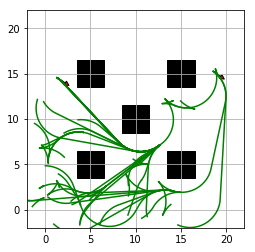

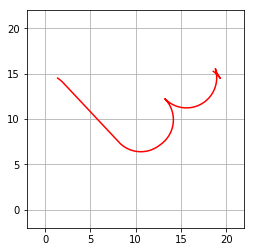

Paths planned: 949
Time taken: 113.342234s


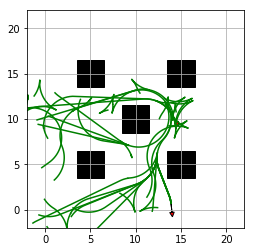

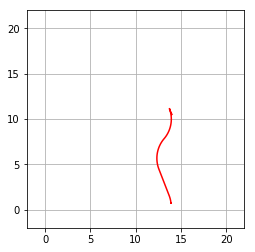

Paths planned: 950
Time taken: 89.152035s


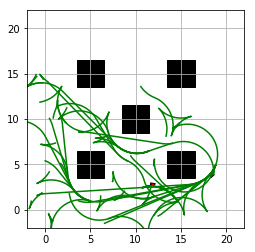

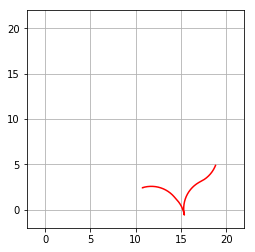

Paths planned: 951
Time taken: 84.630077s
mincost is inf
Planning failed
Time taken: 46.372296s


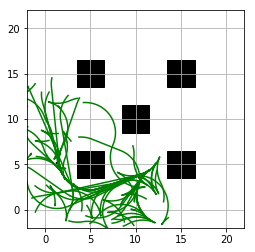

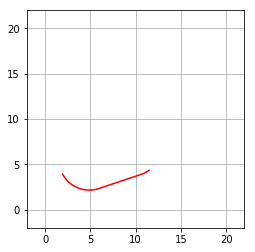

Paths planned: 952
Time taken: 166.574430s


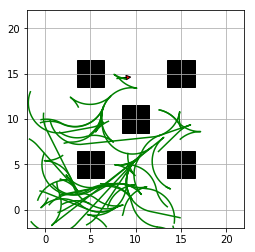

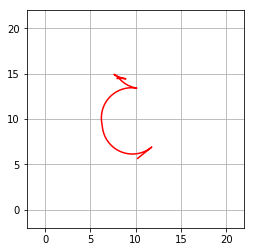

Paths planned: 953
Time taken: 85.857964s


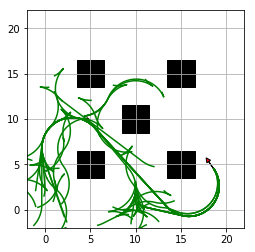

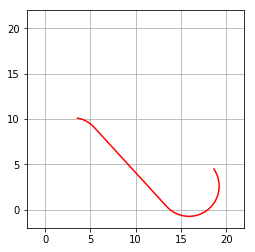

Paths planned: 954
Time taken: 135.447615s
Planning failed
Time taken: 0.000890s


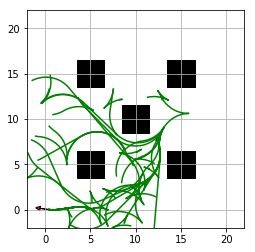

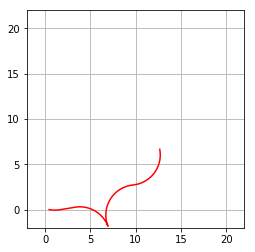

Paths planned: 955
Time taken: 121.451626s
Planning failed
Time taken: 97.674529s


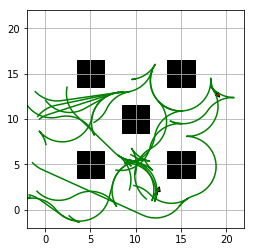

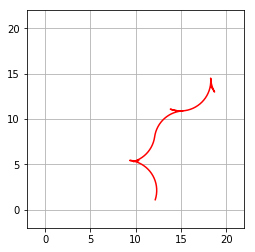

Paths planned: 956
Time taken: 51.495092s
Planning failed
Time taken: 0.000548s


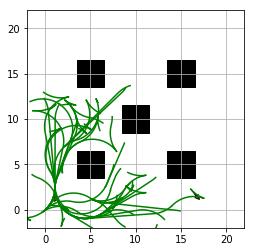

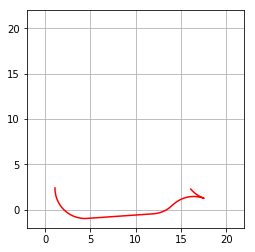

Paths planned: 957
Time taken: 88.556492s
Planning failed
Time taken: 18.236384s
Planning failed
Time taken: 0.001110s


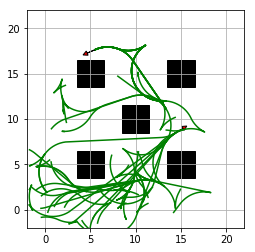

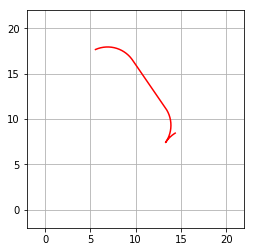

Paths planned: 958
Time taken: 163.508112s


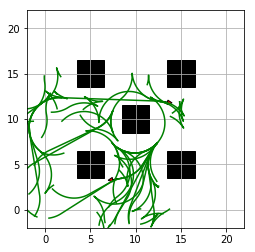

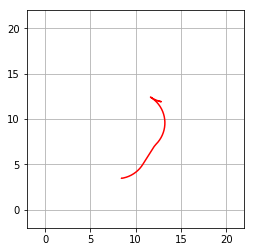

Paths planned: 959
Time taken: 88.340008s
Planning failed
Time taken: 0.000851s


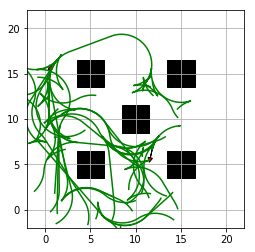

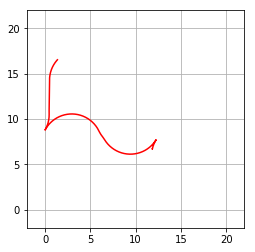

Paths planned: 960
Time taken: 95.202720s
Planning failed
Time taken: 0.001119s


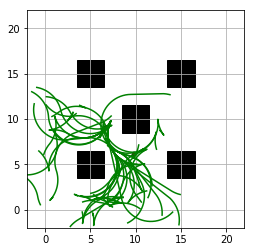

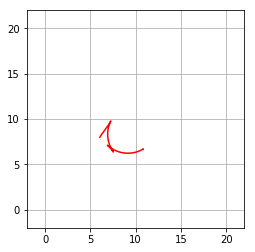

Paths planned: 961
Time taken: 95.943278s


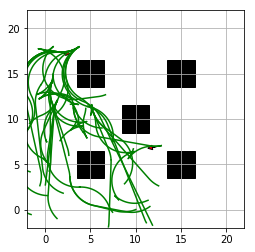

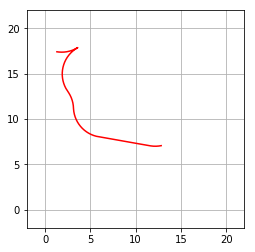

Paths planned: 962
Time taken: 87.779950s
Planning failed
Time taken: 0.001042s


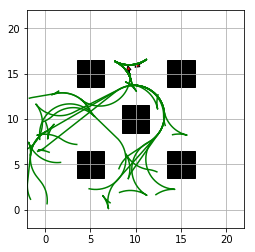

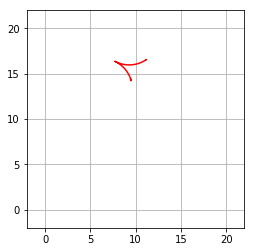

Paths planned: 963
Time taken: 60.797121s


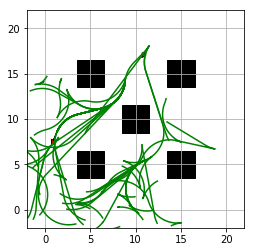

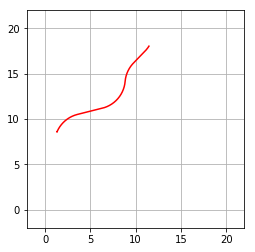

Paths planned: 964
Time taken: 120.257555s


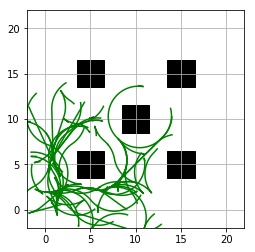

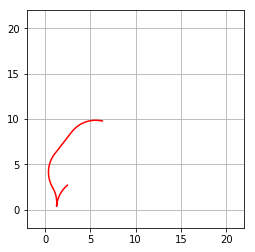

Paths planned: 965
Time taken: 108.278640s


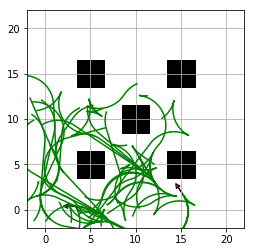

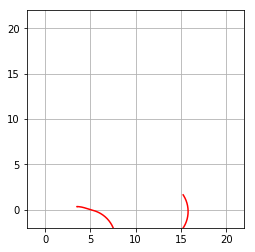

Paths planned: 966
Time taken: 106.680648s
Planning failed
Time taken: 0.000808s
Planning failed
Time taken: 0.000204s
Planning failed
Time taken: 0.000397s
Planning failed
Time taken: 0.000313s


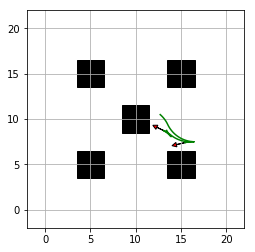

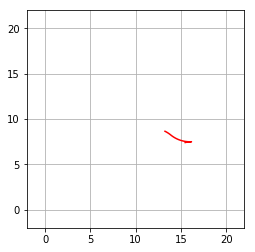

Paths planned: 967
Time taken: 2.999312s
Planning failed
Time taken: 0.000781s
Planning failed
Time taken: 0.000753s


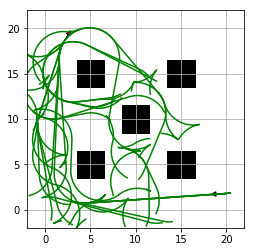

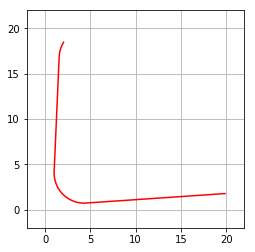

Paths planned: 968
Time taken: 109.044683s
mincost is inf
Planning failed
Time taken: 99.236632s
Planning failed
Time taken: 0.000834s
Planning failed
Time taken: 0.000860s
Planning failed
Time taken: 0.000229s


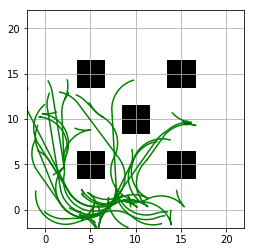

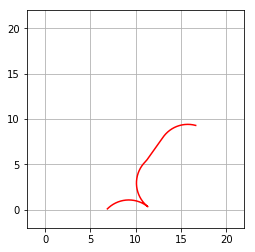

Paths planned: 969
Time taken: 83.349125s


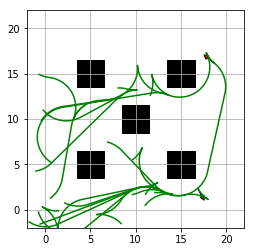

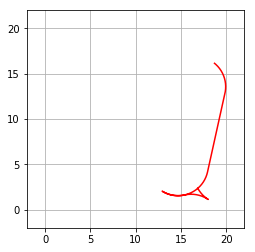

Paths planned: 970
Time taken: 31.801970s
Planning failed
Time taken: 0.001293s
Planning failed
Time taken: 0.000410s
Planning failed
Time taken: 0.000417s


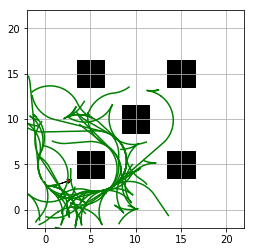

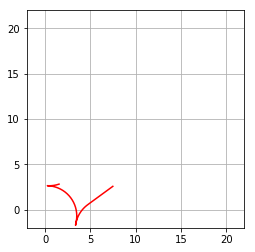

Paths planned: 971
Time taken: 106.031491s


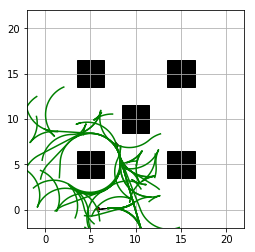

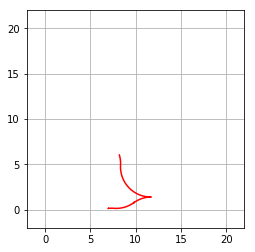

Paths planned: 972
Time taken: 93.611231s
Planning failed
Time taken: 114.041958s


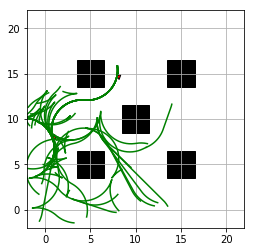

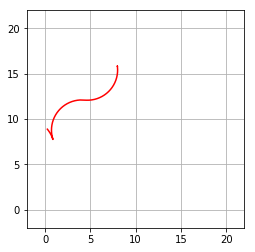

Paths planned: 973
Time taken: 101.128111s
Planning failed
Time taken: 115.384834s


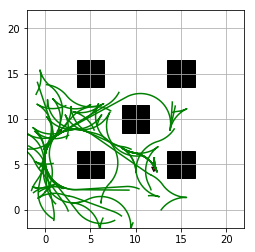

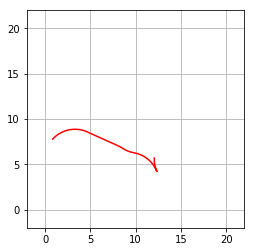

Paths planned: 974
Time taken: 129.595755s


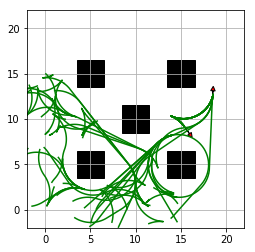

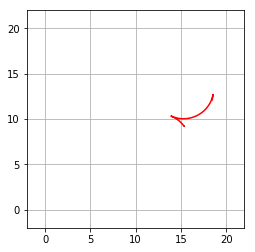

Paths planned: 975
Time taken: 138.385753s
Planning failed
Time taken: 0.001709s
Planning failed
Time taken: 0.001023s
Planning failed
Time taken: 0.001021s


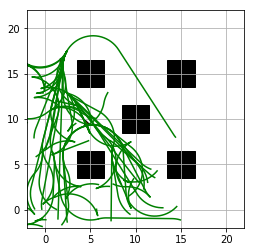

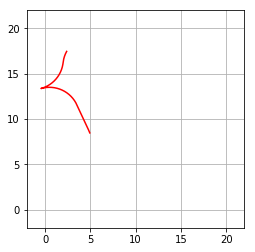

Paths planned: 976
Time taken: 130.167515s


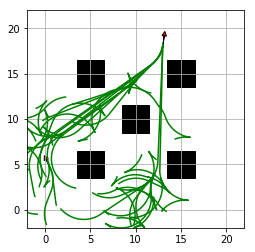

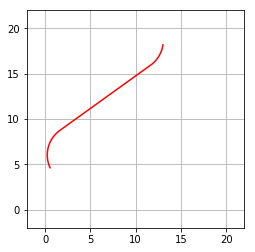

Paths planned: 977
Time taken: 99.090213s


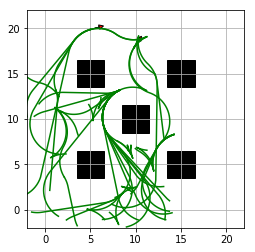

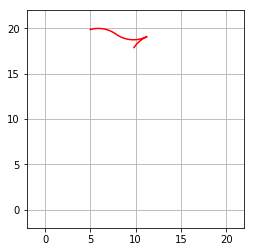

Paths planned: 978
Time taken: 79.174440s
Planning failed
Time taken: 0.000868s
Planning failed
Time taken: 0.000304s
Planning failed
Time taken: 94.526690s
Planning failed
Time taken: 0.001302s
Planning failed
Time taken: 0.000430s


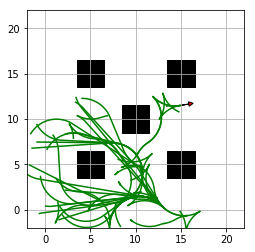

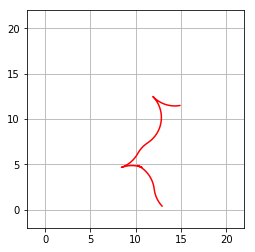

Paths planned: 979
Time taken: 81.632872s
Planning failed
Time taken: 0.001446s


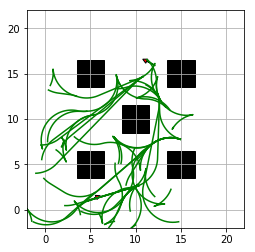

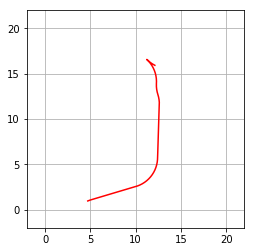

Paths planned: 980
Time taken: 88.601569s


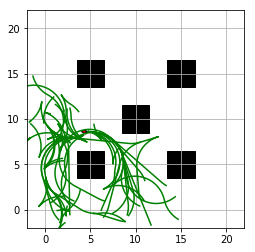

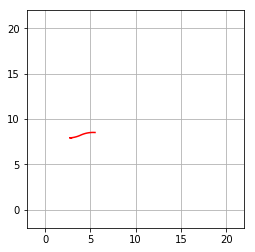

Paths planned: 981
Time taken: 92.682861s
Planning failed
Time taken: 0.000744s
Planning failed
Time taken: 121.640126s
Planning failed
Time taken: 26.469389s
Planning failed
Time taken: 0.000719s


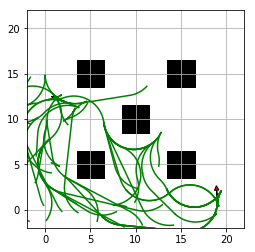

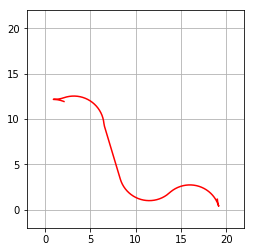

Paths planned: 982
Time taken: 91.904267s
Planning failed
Time taken: 0.000585s
Planning failed
Time taken: 0.000369s


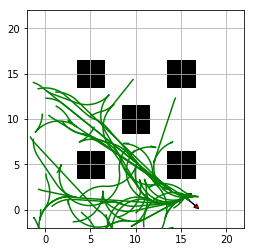

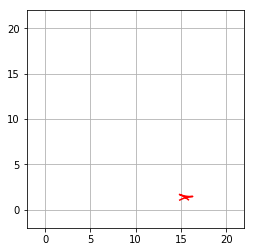

Paths planned: 983
Time taken: 149.391932s


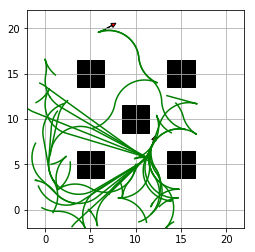

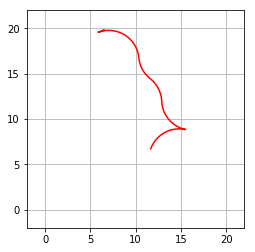

Paths planned: 984
Time taken: 65.098791s
Planning failed
Time taken: 0.001249s


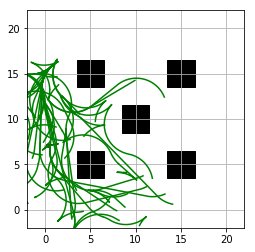

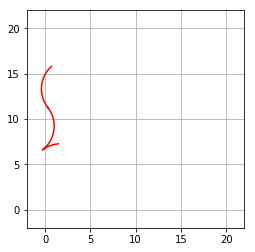

Paths planned: 985
Time taken: 106.292298s
Planning failed
Time taken: 0.000580s
Planning failed
Time taken: 0.000956s
Planning failed
Time taken: 0.000457s


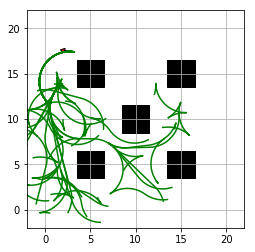

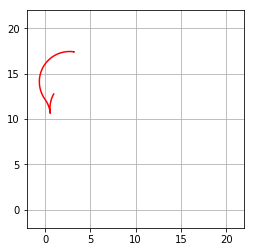

Paths planned: 986
Time taken: 123.307330s


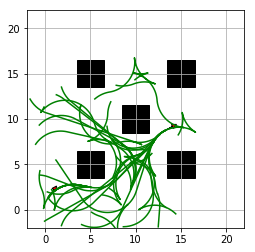

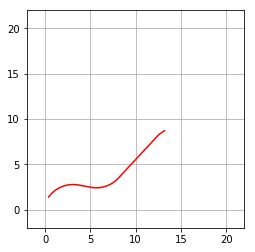

Paths planned: 987
Time taken: 104.990659s
Planning failed
Time taken: 0.001031s


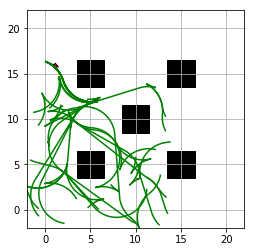

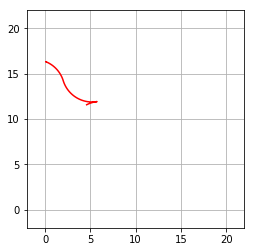

Paths planned: 988
Time taken: 101.127255s
Planning failed
Time taken: 0.001314s


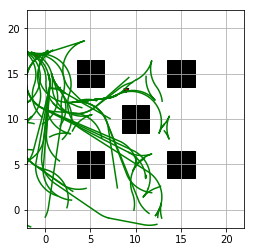

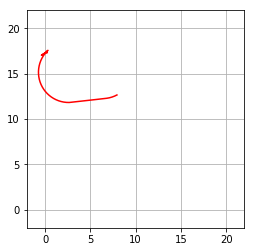

Paths planned: 989
Time taken: 176.620119s


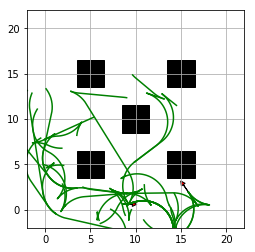

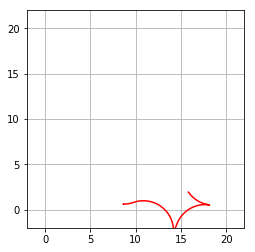

Paths planned: 990
Time taken: 76.745522s
Planning failed
Time taken: 0.000933s


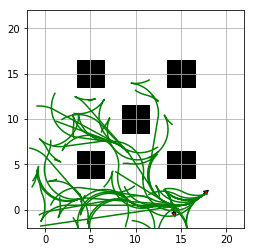

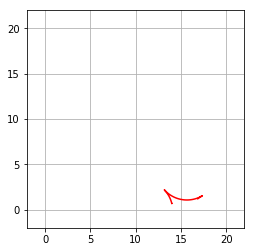

Paths planned: 991
Time taken: 127.960456s
Planning failed
Time taken: 0.000566s
Planning failed
Time taken: 0.000364s
Planning failed
Time taken: 114.475075s


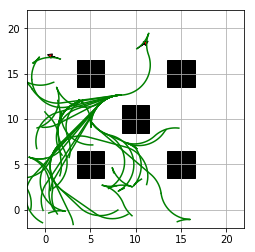

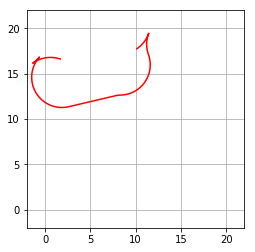

Paths planned: 992
Time taken: 73.883591s


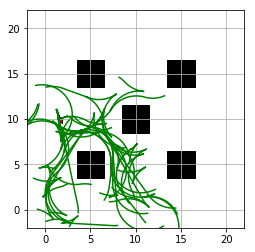

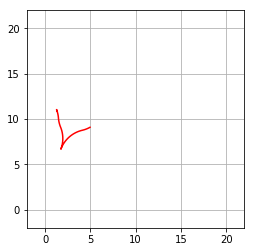

Paths planned: 993
Time taken: 147.452560s
Planning failed
Time taken: 0.001468s
Planning failed
Time taken: 0.001410s
Planning failed
Time taken: 0.001198s
Planning failed
Time taken: 0.001168s


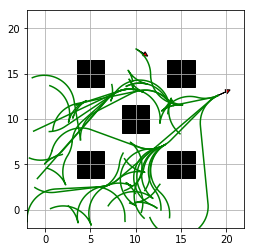

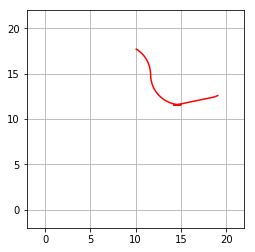

Paths planned: 994
Time taken: 78.858910s


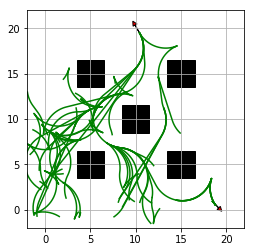

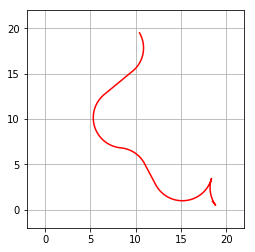

Paths planned: 995
Time taken: 105.460301s


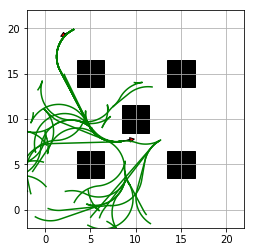

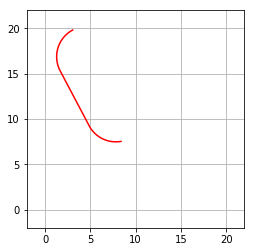

Paths planned: 996
Time taken: 79.059042s
Planning failed
Time taken: 0.001202s
Planning failed
Time taken: 0.000943s


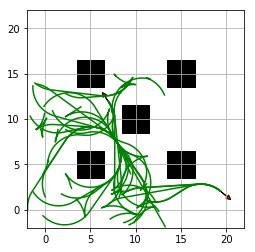

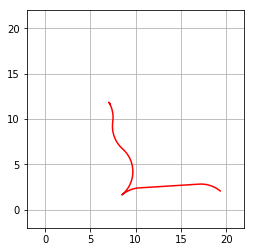

Paths planned: 997
Time taken: 116.043996s
Planning failed
Time taken: 0.000960s


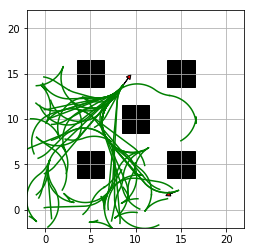

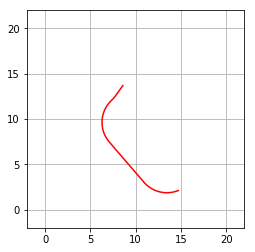

Paths planned: 998
Time taken: 155.468176s
Planning failed
Time taken: 0.001124s
Planning failed
Time taken: 0.000547s


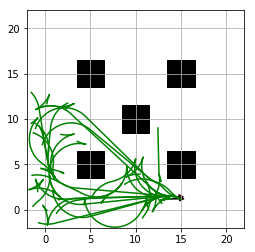

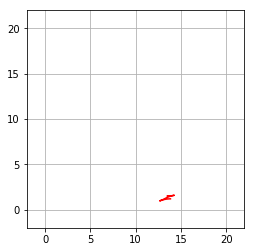

Paths planned: 999
Time taken: 97.517793s


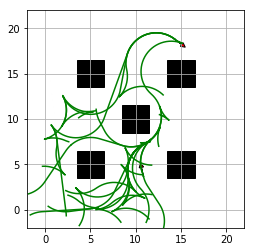

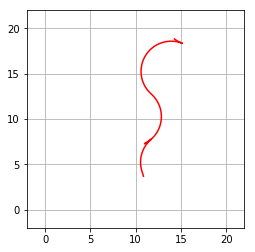

Paths planned: 1000
Time taken: 46.703772s


In [2]:
main()